## Macrophage integrate from inflamed tissue
## (weighted PCA, harmony, and SNN)
### Fan Zhang
### 2020-06-04

In [32]:
suppressMessages({
                    library(data.table)
                    library(reticulate)
                    library(Rcpp)
                    library(scales)
                    library(irlba)
                    library(singlecellmethods)
                    library(parallel)
                    library(pbapply)
                    library(patchwork)
                    library(pheatmap)
                    library(entropy)
                    library(Rtsne)
                    library(loe)
                    library(igraph)
                    library(viridis)
                    library(RColorBrewer)
                    library(matrixStats)
                    library(plyr)
                    library(parallel)   
                    library(harmony)
                    library(magrittr)
                    library(gridExtra)
                    library(ggthemes)
                    library(cowplot)
                    library(reticulate)
                    library(ggbeeswarm)
                    library(ggrepel)
                    library(plyr)
                    library(ggplot2)
                    library(gridExtra)
                    library(ggthemes)
                    library(dplyr)
                    library(RColorBrewer)
                    library(ggbeeswarm)
                    library(ggrepel)
                    library(MASS) 
                    library(matrixStats)
                    library(viridis)
                    library(grid)
                    require(gdata)
                 })


meta_colors <- list(

  disease = c(
             "IFNb+"    = "#B3B3B3",
             "TNFa+"         = "#8DD3C7",
             "TNFa+ fibro+" = "#FFFFB3", 
             "IFNr+"        =  "#807DBA",
             "IFNr+ fibro+"= "#FB8072",
             "TNFa+ IFNr+"  = "#80B1D3",
             "TNFa+ IFNr+ fibro+" = "#FDB462",
             "Control"        = "#B3DE69",
             "IL4+"         = "#FCCDE5",
             "IFNg+"        =  "#807DBA",
             "IFNg+ fibro+"= "#FB8072",
             "TNFa+ IFNg+"  = "#80B1D3",
             "TNFa+ IFNg+ fibro+" = "#FDB462",
             "Untreated"        = "#B3DE69",

              "healthy" = "#B3B3B3",
              "mild"   = "#66A61E",
              "severe" = "#A6761D",
            "Inflamed UC" = "#A6761D", 
            "Non-inflamed UC" = "#E6AB02", 
            "Healthy Colon" = "#E5D8BD", 
            "Healthy Kidney" = "#A6CEE3",
            "Healthy Lung" = "#C7EAE5", 
            "Polymyositis Lung" = "#80CDC1",
            "SS Lung" = "#003C30",
            "HP Lung" = "#35978F",
            "Crohn" = "#FF7F00", 
            "SLE Kidney" = "#1F78B4",   
            "RA Synovium" =  "#E31A1C",  
            "OA Synovium"  =  "black", 
            "MS Brain" = "#33A02C",
            "Healthy Brain" = "#B2DF8A",

            "Inflamed IBD" = "#A6761D", 
            "Non-inflamed IBD" = "#E6AB02", 
            "healthy (IBD)" = "#E5D8BD", 
            "Ctrl" = "#C7EAE5", 
            "Polymyositis" = "#80CDC1",
            "Polymyositis lung" = "#80CDC1",
            "Systemic sclerosis" = "#003C30",
            "SS lung" = "#003C30",
            "Hypersensitivity pneumonitis" = "#35978F",
            "HP lung" = "#35978F",  
            "SLE" = "#1F78B4",   
            "RA" =  "#E31A1C", 
            "OA"  =  "black"
#             "MS" = "#33A02C"  
      
  ),
    
    
  "dataset" = c(    
            "AMP SLE Phase 1 Celseq" = "#006837",
            "AMP SLE Phase 1 Fluidigm" = "#ADDD8E",
            "RA" = "#6A3D9A", 
            "AMP RA" = "#6A3D9A", 
            "AMP RA Phase 1" = "#E31A1C",
            "Rahul" = "#FC8D62",
            "Crohn (Venema)" = "#FF7F00", 
            "UC (Smillie)" = "#A6761D",
            "Lung disease (Reyfman)" = "#7570B3",
            "AMP SLE" = "#1F78B4", 
            "RA" = "#E31A1C"
#             "MS (Jäkel)" = "#33A02C",
#             "MS (Schirmer)" = "#33A02C"
  ),
    
    
  cluster = c(
              "0" = "#80B1D3",
              "1" = "#FB8072",
              "2" = "#B3DE69",
              "3" = "#FFFFB3",
              "4" = "#8DD3C7",
              "5" = "#B3B3B3",
              "6" = "#74C476",
              "7" = "#FDB462"
  ),
    
  sample = c(
            "sample_1" =  "#E41A1C",
            "sample_2" = "#377EB8",
            "sample_3" = "#4DAF4A",
            "sample_4" = "#984EA3" 
  )
)

set1 = c( "#E41A1C", "#377EB8", "#4DAF4A", "#984EA3", "#FF7F00", "#FFFF33", "#A65628", "#F781BF", "#999999")
set3 = c("#8DD3C7", "#FFFFB3", "#BEBADA", "#FB8072", "#80B1D3", "#FDB462", "#B3DE69", "#FCCDE5", "#D9D9D9", "#BC80BD", "#CCEBC5", "#FFED6F")
set2 = c("#66C2A5", "#FC8D62", "#8DA0CB", "#E78AC3", "#A6D854", "#FFD92F", "#E5C494", "#B3B3B3")
colors37 = c("#466791","#60bf37","#953ada","#4fbe6c","#ce49d3","#a7b43d","#5a51dc","#d49f36","#552095","#507f2d","#db37aa","#84b67c","#a06fda","#df462a","#5b83db","#c76c2d","#4f49a3","#82702d","#dd6bbb","#334c22","#d83979","#55baad","#dc4555","#62aad3","#8c3025","#417d61","#862977","#bba672","#403367","#da8a6d","#a79cd4","#71482c","#c689d0","#6b2940","#d593a7","#895c8b","#bd5975")

In [33]:
meta_colors <- list(

  disease = c(

    "healthy" = "#B3B3B3",
    "mild"   = "#B2DF8A",
    "severe" = "#33A02C",
      
   
    "Healthy BALF" = "#B3B3B3",
    "Mild COVID-19"   = "#B2DF8A", 
    "Severe COVID-19" = "#33A02C",
      
    "Healthy BALF" = "#B3B3B3",
    "Mild BALF"   = "#B2DF8A", 
    "Severe BALF" = "#33A02C",
      
    "Inflamed UC" = "#A6761D", 
    "Non-inflamed UC" = "#E6AB02", 
    "Healthy colon" = "#E5D8BD", 
    "Healthy kidney" = "#A6CEE3",
    "Healthy Lung" = "#C7EAE5", # healthy vs Pulmonary Fibrosis
    "Polymyositis lung" = "#80CDC1",
    "SS Lung" = "#003C30",
    "Systemic sclerosis lung" = "#003C30",
    "HP Lung" = "#35978F",
    "Hypersensitivity pneumonitis lung" = "#35978F",
      
    "Crohn" = "#FF7F00", 
    "Inflamed Crohn" = "#FF7F00", 
    "Non-inflamed Crohn" = "#D9D9D9",  
      
    "Healthy kidney" = "#1F8888",
    "SLE kidney" = "#1F78B4",   
    "RA synovium" =  "#E31A1C", #"#6A3D9A", 
    "OA synovium"  =  "#FB9A99", # "#FB9A99", # "#CAB2D6",
      
    "MS brain" = "#6A3D9A",
    "Healthy brain" = "#CAB2D6",
      
    "Inflamed IBD" = "#A6761D", 
    "Non-inflamed IBD" = "#E6AB02", 
    "healthy (IBD)" = "#E5D8BD", 
    "Ctrl" = "#C7EAE5", # healthy vs Pulmonary Fibrosis
    
    "Polymyositis" = "#80CDC1",
    "Polymyositis lung" = "#80CDC1",
    "Systemic sclerosis" = "#003C30",
    "SS lung" = "#003C30",
      
    "Hypersensitivity pneumonitis" = "#35978F",
    "HP lung" = "#35978F",  


    "SLE" = "#1F78B4",   
    "RA" =  "#E31A1C", #"#6A3D9A", 
    "OA"  =  "black", # "#FB9A99", # "#CAB2D6",
    "MS" = "#33A02C",
    "Multiple sclerosis" = "#33A02C"
      
  ),
    
#     'Healthy BALF' 'Healthy colon' 'Healthy kidney' 'Hypersensitivity pneumonitis' 'Inflamed Crohn'
#     'Inflamed UC' 'Mild BALF' 'Non-inflamed Crohn' 'Non-inflamed UC' 'OA' 'Polymyositis lung' 'RA' 'Severe BALF' 'SLE' 'SS lung'
    
  "dataset" = c(    
    "AMP SLE Phase 1 Celseq" = "#006837",
    "AMP SLE Phase 1 Fluidigm" = "#ADDD8E",
    "RA" = "#6A3D9A", # "#E31A1C",  
    "AMP RA" = "#6A3D9A", # "#E31A1C",  
    "AMP RA Phase 1" = "#E31A1C",
    "Rahul" = "#FC8D62",
    "Crohn (Venema)" = "#FF7F00", 
    "UC (Smillie)" = "#A6761D",
    "Lung disease (Reyfman)" = "#7570B3",
    "AMP SLE" = "#1F78B4", 
    "RA" = "#E31A1C",
    "MS (Jäkel)" = "#33A02C",
    "MS (Schirmer)" = "#33A02C"
      
  ),
    
  "cluster" = c(
      "0" = "#E41A1C", 
      "1" = "#FF7F00", 
      "2" =  "#FFFF33", 
      "3" =  "#984EA3", 
      "4" =  "#377EB8",
      "5" =   "#4DAF4A", 
      "6" =  "#A65628",
      "7" = "#F781BF"
  )

)

In [2]:
# Functions
FindVariableGenesBatch <- function(exprs_mat, meta_df, genes_exclude = NULL, ngenes_use = 1e3, expr_min = .1) {
    if (!is.null(genes_exclude)) {
        genes_use <- setdiff(row.names(exprs_mat), genes_exclude)
    }
    x_res <- split(meta_df$cell, meta_df$sample) %>% lapply(function(x) {
        FindVariableGenesSeurat(exprs_mat[genes_use, x]) %>% 
            subset(gene.mean >= expr_min) %>% 
            tibble::rownames_to_column("gene") %>% 
            dplyr::arrange(-gene.dispersion) %>%
            head(ngenes_use)
    })
    data.table(Reduce(rbind, x_res))[, .N, by = gene][order(-N)]    
}



FindVariableGenesSeurat <- function (data, x.low.cutoff = 0.1, x.high.cutoff = 8,
                                     y.cutoff = 1, y.high.cutoff = Inf, num.bin = 0,
                                     binning.method = "equal_width", sort.results = TRUE,
                                     display.progress = TRUE, ...)
{
    genes.use <- rownames(data)
    if (class(data) != "dgCMatrix") {
        data <- as(as.matrix(data), "dgCMatrix")
    }
    ## (1) get means and variances
    gene.mean <- FastExpMean(data, display.progress)
    names(gene.mean) <- genes.use
    gene.dispersion <- FastLogVMR(data, display.progress)
    names(gene.dispersion) <- genes.use

    gene.dispersion[is.na(x = gene.dispersion)] <- 0
    gene.mean[is.na(x = gene.mean)] <- 0

    mv.df <- data.frame(gene.mean, gene.dispersion)
    rownames(mv.df) <- rownames(data)

    ## (OPTIONAL) do the binning correction
    if (num.bin > 0) {
      if (binning.method == "equal_width") {
          data_x_bin <- cut(x = gene.mean, breaks = num.bin)
      }
      else if (binning.method == "equal_frequency") {
          data_x_bin <- cut(x = gene.mean, breaks = c(-1, quantile(gene.mean[gene.mean >
              0], probs = seq(0, 1, length.out = num.bin))))
     }
      else {
          stop(paste0("Invalid selection: '", binning.method,
              "' for 'binning.method'."))
      }
      names(x = data_x_bin) <- names(x = gene.mean)
      mean_y <- tapply(X = gene.dispersion, INDEX = data_x_bin,
          FUN = mean)
      sd_y <- tapply(X = gene.dispersion, INDEX = data_x_bin,
          FUN = sd)
      gene.dispersion.scaled <- (gene.dispersion - mean_y[as.numeric(x = data_x_bin)])/sd_y[as.numeric(x = data_x_bin)]
      gene.dispersion.scaled[is.na(x = gene.dispersion.scaled)] <- 0
      ##names(gene.dispersion.scaled) <- names(gene.mean)

      mv.df$gene.dispersion.scaled <- gene.dispersion.scaled
    }

    return(mv.df)
}

environment(FindVariableGenesSeurat) <- asNamespace("Seurat")

ScaleDataSeurat <- function (data.use, margin = 1, scale.max = 10,
                                block.size = 1000) {

    if (margin == 2) data.use %<>% t
    max.block <- ceiling(nrow(data.use)/block.size)

    ## Define data and functions to use in sparse and dense cases
    if (class(data.use) == "dgCMatrix" | class(data.use) == "dgTMatrix") {
        scale_fxn <- function(x) {
            FastSparseRowScale(mat = x, scale = TRUE, center = TRUE,
                               scale_max = scale.max, display_progress = FALSE)
        }
    } else {
        scale_fxn <- function(x) {
            FastRowScale(mat = x, scale = TRUE, center = TRUE,
                               scale_max = scale.max, display_progress = FALSE)
       }
        data.use <- as.matrix(data.use)
    }

    ## Do scaling, at once or in chunks
    if (max.block == 1) {
        scaled.data <- scale_fxn(data.use)
    } else {
        scaled.data <- matrix(NA, nrow(data.use), ncol(data.use))
        for (i in 1:max.block) {
            idx.min <- (block.size * (i - 1))
            idx.max <- min(nrow(data.use), (block.size * i - 1) + 1)
            my.inds <- idx.min:idx.max
            scaled.data[my.inds, ] <- scale_fxn(data.use[my.inds, , drop = F])
        }
    }

    colnames(scaled.data) <- colnames(data.use)
    row.names(scaled.data) <- row.names(data.use)
    scaled.data[is.na(scaled.data)] <- 0
    if (margin == 2) scaled.data %<>% t
    return(scaled.data)
}
environment(ScaleDataSeurat) <- asNamespace("Seurat")


fig.size <- function(height, width) {
    options(repr.plot.height = height, repr.plot.width = width)
}

SingleFeaturePlotSeurat <- function (data.use, feature, data.plot, pt.size, pch.use, cols.use,
    dim.codes, min.cutoff, max.cutoff, coord.fixed, no.axes,
    no.title = FALSE, no.legend, dark.theme, vector.friendly = FALSE,
    png.file = NULL, png.arguments = c(10, 10, 100))
{
    if (vector.friendly) {
        previous_call <- blank_call <- png_call <- match.call()
        blank_call$pt.size <- -1
        blank_call$vector.friendly <- FALSE
        png_call$no.axes <- TRUE
        png_call$no.legend <- TRUE
        png_call$vector.friendly <- FALSE
        png_call$no.title <- TRUE
        blank_plot <- eval(blank_call, sys.frame(sys.parent()))
        png_plot <- eval(png_call, sys.frame(sys.parent()))
        png.file <- SetIfNull(x = png.file, default = paste0(tempfile(),
            ".png"))
        ggsave(filename = png.file, plot = png_plot, width = png.arguments[1],
            height = png.arguments[2], dpi = png.arguments[3])
        to_return <- AugmentPlot(blank_plot, png.file)
        file.remove(png.file)
        return(to_return)
    }
    idx.keep <- which(!is.na(data.use[feature, ]))
    data.gene <- data.frame(data.use[feature, idx.keep])
#     data.gene <- na.omit(object = data.frame(data.use[feature,
#         ]))
    min.cutoff <- SetQuantile(cutoff = min.cutoff, data = data.gene)
    max.cutoff <- SetQuantile(cutoff = max.cutoff, data = data.gene)
    data.gene <- sapply(X = data.gene, FUN = function(x) {
        return(ifelse(test = x < min.cutoff, yes = min.cutoff,
            no = x))
    })
    data.gene <- sapply(X = data.gene, FUN = function(x) {
        return(ifelse(test = x > max.cutoff, yes = max.cutoff,
            no = x))
    })
    data_plot <- data.plot[idx.keep, ]
    data_plot$gene <- data.gene
    if (length(x = cols.use) == 1) {
        brewer.gran <- brewer.pal.info[cols.use, ]$maxcolors
    }
    else {
        brewer.gran <- length(x = cols.use)
    }
    if (all(data.gene == 0)) {
        data.cut <- 0
    }
    else {
        data.cut <- as.numeric(x = as.factor(x = cut(x = as.numeric(x = data.gene),
            breaks = brewer.gran)))
    }
    data_plot$col <- as.factor(x = data.cut)
    p <- data_plot %>%
        dplyr::arrange(col) %>%
        ggplot(mapping = aes(x = x, y = y))
    if (brewer.gran != 2) {
        if (length(x = cols.use) == 1) {
            p <- p + geom_point(mapping = aes(color = col), size = pt.size,
                shape = pch.use) + #scale_color_brewer(palette = cols.use)
                scale_color_viridis(option = "plasma", end = .9)
        }
        else {
            p <- p + geom_point(mapping = aes(color = col), size = pt.size,
                shape = pch.use) + #scale_color_manual(values = cols.use)
                scale_color_viridis(option = "plasma", end = .9)
        }
    }
    else {
        if (all(data_plot$gene == data_plot$gene[1])) {
            warning(paste0("All cells have the same value of ",
                feature, "."))
            p <- p + geom_point(color = cols.use[1], size = pt.size,
                shape = pch.use)
        }
        else {
            p <- p + geom_point(mapping = aes(color = gene),
                size = pt.size, shape = pch.use) + scale_color_viridis(option = "plasma", end = .9
    )
        }
    }
    if (dark.theme) {
        p <- p + DarkTheme()
    }
    if (no.axes) {
        p <- p + theme(axis.line = element_blank(), axis.text.x = element_blank(),
            axis.text.y = element_blank(), axis.ticks = element_blank(),
            axis.title.x = element_blank(), axis.title.y = element_blank())
        if (!no.title)
            p <- p + labs(title = feature, x = "", y = "")
        if (no.title)
            p <- p + labs(x = "", y = "")
    }
    else {
        if (no.title)
            p <- p + labs(x = dim.codes[1], y = dim.codes[2])
        if (!(no.title))
            p <- p + labs(title = feature) + labs(x = "", y = "")
    }
    if (no.legend) {
        p <- p + theme(legend.position = "none")
    }
    if (coord.fixed) {
        p <- p + coord_fixed()
    }
    return(p)
}
environment(SingleFeaturePlotSeurat) <- asNamespace("Seurat")

PlotFeatures <- function(umap_use, features_plot, exprs_use, cells_use, ncols, pt_size = .5, pt_shape = ".", q_lo = "q10", q_hi = "q90") {
    if (missing(cells_use)) cells_use <- 1:nrow(umap_use)
    if (missing(ncols)) ncols <- round(sqrt(length(features_plot)))
    
    plt_list <- lapply(features_plot, function(feature_use) {
        SingleFeaturePlotSeurat(exprs_use[, cells_use], feature_use, data.frame(x = umap_use[cells_use, 1], y = umap_use[cells_use, 2]),
                                pt.size = pt_size, pch.use = pt_shape, cols.use = c("lightgrey", "blue"),
                                dim.codes = c("UMAP 1", "UMAP 2"), min.cutoff = c(q10 = q_lo), max.cutoff = c(q90 = q_hi),
                                coord.fixed = FALSE, no.axes = FALSE, dark.theme = FALSE, no.legend = TRUE)
    })
    plot_grid(plotlist = plt_list, ncol = ncols)
    #return(plt_list)
}

BuildSNNSeurat <- function (data.use, k.param = 30, prune.SNN = 1/15, nn.eps = 0) {
    my.knn <- nn2(data = data.use, k = k.param, searchtype = "standard", eps = nn.eps)
    nn.ranked <- my.knn$nn.idx

    snn_res <- ComputeSNN(nn_ranked = nn.ranked, prune = prune.SNN)
    rownames(snn_res) <- row.names(data.use)
    colnames(snn_res) <- row.names(data.use)
    return(snn_res)
}
environment(BuildSNNSeurat) <- asNamespace("Seurat")

NormalizeDataSeurat <- function(A, scaling_factor = 1e4, do_ftt = FALSE) {
	A@x <- A@x / rep.int(Matrix::colSums(A), diff(A@p))
    A@x <- scaling_factor * A@x
    if (do_ftt) {
        A@x <- sqrt(A@x) + sqrt(1 + A@x)
    } else {
        A@x <- log(1 + A@x)
    }
	return(A)
}

In [3]:
library(RSpectra)

# weighted PCA is in immunogenomics/singlecellmethods, function weighted_pca
library(singlecellmethods)
weighted_pca <- function(X, weights, genes_use=NULL, npc=20, do_corr=TRUE, scale_thresh=10) {
    if (!identical(length(weights), ncol(X))) {
        stop('Columns in X must match length of weights')
    }
    
#     y <- factor(y)
#     weights <- as.numeric((1 / prop.table(table(y)))[y]) / nlevels(y)
    if (any(is.na(weights))) {
        idx_keep <- which(is.na(weights))
#         y <- y[idx_keep]
        weights <- weights[idx_keep]
        X <- X[, idx_keep]
    }
    if (is.null(genes_use)) {
        genes_use <- row.names(X)
    } else if (length(genes_use) < nrow(X)) {
        if (any(!genes_use %in% row.names(X))) {
            stop('genes_use not in rownames of X')
        }
        X <- X[genes_use, ]
    }
    
    ## weighted z-scores
#     mu <- X %>% apply(1, function(x) {SDMTools:::wt.mean(x, weights)})
#     sig <- X %>% apply(1, function(x) {SDMTools:::wt.sd(x, weights)})
    mu <- rowMeans(X, weights = weights)
    sig <- rowSDs(X, weights = weights)
    
    # Added 12/9/19: save weighted scaling means and std devs
    vargenes_means_sds <- tibble(
        symbol = genes_use,
        mean = mu
    )
    vargenes_means_sds$stddev <- sig
    # finish added 12/9/19
    
    X <- scaleDataWithStats(X, mu, sig) 
    X <- X[which(is.na(rowSums(X)) == 0), ]
    if (do_corr) {
        X <- X %>% scale() %>% pmin(scale_thresh) %>% pmax(-scale_thresh)
    }
    
    ## weighted SVD
#     pres <- rsvd::rsvd(X %*% Matrix::Diagonal(x = sqrt(weights)), k = npc)
    pres <- RSpectra::svds(X %*% Matrix::Diagonal(x = sqrt(weights)), npc)
    V <- (Matrix::Diagonal(x = 1 / sqrt(weights)) %*% pres$v) %*% diag(pres$d)
    V <- as.matrix(V)
    colnames(V) <- paste0('PC', 1:npc)
    row.names(V) <- colnames(X)
    colnames(pres$u) <- paste0('PC', 1:npc)
    row.names(pres$u) <- row.names(X)
    return(list(loadings = pres$u, embeddings = V, vargenes = vargenes_means_sds))
}

# Cosine normalize values
cosine_normalize <- function(X, MARGIN = 1, do_safe = TRUE) {
    if (do_safe) {
        X <- sweep(X, MARGIN, apply(X, MARGIN, max), "/")
    }
    sweep(X, MARGIN, apply(X, MARGIN, function(x) sqrt(sum(x^2))), "/")
}
                           
                           
                           
do_pca <- function(X, weights, genes_use=NULL, npc=10, do_corr=TRUE) {
    if (is.null(genes_use)) {
        genes_use <- row.names(X)
    }
    mu <- X[genes_use, ] %>% apply(1, function(x) {SDMTools:::wt.mean(x, weights)})
    sig <- X[genes_use, ] %>% apply(1, function(x) {SDMTools:::wt.sd(x, weights)})
    
    X <- X[genes_use, ] %>% scaleDataWithStats(mu, sig) 
    X <- X[which(is.na(rowSums(X)) == 0), ]
    if (do_corr) {
        X <- scale(X)
    }
    pres <- rsvd::rsvd(X, k = npc)
    V <- pres$v %*% diag(pres$d)
    V <- data.table(V)
    colnames(V) <- paste0('PC', 1:npc)
    return(V)    
}
                           
get_stats <- function(X, weights, genes_use=NULL) {
    if (is.null(genes_use)) {
        genes_use <- row.names(X)
    }
    mu <- X[genes_use, ] %>% apply(1, function(x) {SDMTools:::wt.mean(x, weights)})
    sig <- X[genes_use, ] %>% apply(1, function(x) {SDMTools:::wt.sd(x, weights)})
    return(list(mu = mu, sig = sig))
}

# Only focus on macrophage integration of COVID-19 and other 5 inflammatory disease tissues 

In [17]:
meta_all <- readRDS("../2020_05_14_COVID19_RA_SLE_UC_Crohn_MS_lung/meta_all_macropahge_COVID19_othertissues_pca_harmony_umap_cluster_new_2020_05_22.rds")
exp_all <- readRDS("../2020_05_14_COVID19_RA_SLE_UC_Crohn_MS_lung/exp_all_macropahge_COVID19_othertissues_2020_05_19.rds")
dim(meta_all)
dim(exp_all)

[1] 74475    59

[1]  17054 108255

In [18]:
exp_all <- exp_all[, meta_all$cell]
all(colnames(exp_all) == meta_all$cell)

[1] TRUE

# Preprocessing

In [20]:
## Normalize
exprs_norm <- exp_all %>% NormalizeDataSeurat()

# Find varible genes
genes_exclude <- grep("^MT-|^RPL|^RPS|MALAT1|MIR-", row.names(exprs_norm), value = TRUE)
meta_all$sample <- as.character(meta_all$sample)
meta_all$cell <- as.character(meta_all$cell)

vargenes_df <- FindVariableGenesBatch(exprs_norm, meta_all, genes_exclude, 0.5e3)
nrow(vargenes_df)
table(vargenes_df$N)
var_genes <- vargenes_df$gene
head(var_genes)

[1] 7611


   1    2    3    4    5    6    7    8    9   10   11   12   13   14   15   16 
3323 1840  893  452  218  132   98   65   45   40   42   26   25   26   15   21 
  17   18   19   20   21   22   23   24   25   26   27   28   29   30   31   32 
  14   22    5   15   14    8    4   10    9    4    4    8    7    9    5    5 
  33   34   35   36   37   38   39   40   41   42   43   44   45   46   47   48 
   9    5    8    7    3    8    4    4    8    4    3    3    3    3    3    5 
  49   50   51   52   53   54   55   56   57   58   59   60   61   62   63   64 
   4    2    2    4    2    8    2    5    5    4    3    1    2    3    5    7 
  65   66   68   69   70   71   73   74   75   76   77   78   80   82   83   84 
   3    3    1    2    1    1    2    2    1    4    2    1    2    3    4    4 
  85   86   87   91   92   93   94   95   96   98  100  101  102  103  104  105 
   1    1    1    2    2    4    2    2    1    2    2    3    5    2    1    1 

[1] "CD74"     "HLA-DRA"  "C1QB"     "HLA-DRB1" "HLA-DPB1" "LYZ"

In [18]:
saveRDS(exprs_norm, "exprs_norm_macropahge_new_2020_06_04.rds")

In [21]:
meta_all <- meta_all[, c(1:10)]
meta_all[1:4,]

cell,dataset,technology,sample,disease,cell_type,nUMI,nGene,percent_mito,percent.ribo
S006_L1Q1_G01,AMP RA,Celseq,301-0159,OA,SC-M3,1678,878,0,0.01430274
S006_L1Q1_G03,AMP RA,Celseq,301-0159,OA,SC-M2,8439,2608,0,0.01860410
S006_L1Q1_G05,AMP RA,Celseq,301-0159,OA,SC-M2,5769,2343,0,0.01092044
S006_L1Q1_G07,AMP RA,Celseq,301-0159,OA,SC-M2,5354,2031,0,0.02241315


In [23]:
# Scale expression to z-scores across cell types
exprs_scaled <- exprs_norm[var_genes, ] %>% ScaleDataSeurat() 
# rm(exprs_norm)

In [27]:
# Weighted strategy
table(meta_all$dataset)
y <- factor(meta_all$dataset)
weights <- as.numeric((1 / prop.table(table(y)))[y]) / nlevels(y)
length(weights)
table(weights)


  AMP RA  AMP SLE COVID-19      IBD     Lung   Martin    Rahul 
     596      337    47766     9218    11499     2221     2838 

[1] 74475

weights
 0.22273763166867 0.925235734784391  1.15418590955584  3.74886741165811 
            47766             11499              9218              2838 
 4.79031324371261   17.851150527325   31.570580754557 
             2221               596               337 

In [28]:
exprs_cosine <- Matrix::Matrix(exprs_scaled, sparse = TRUE)
class(exprs_cosine)

[1] "dgCMatrix"
attr(,"package")
[1] "Matrix"

In [29]:
# Weighted pca
# X, weights, genes_use=NULL, npc=20, do_corr=TRUE, scale_thresh=10
pca_res <- weighted_pca(exprs_scaled, weights, rownames(exprs_cosine), 20, TRUE, 10)$embeddings
pca_res[1:4,]
dim(pca_res)

saveRDS(pca_res, "pca_res_2020-06-09.rds")

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,PC11,PC12,PC13,PC14,PC15,PC16,PC17,PC18,PC19,PC20
S006_L1Q1_G01,-15.97660,0.1416445,-4.147444,-2.6747606,7.124712,2.139780,1.5359004,-0.76014185,8.558072,-0.9451859,-0.6911047,-2.40141977,-4.266990,4.6705392,-0.4258051,2.941289,5.499931,0.4170506,1.451248,0.6039856
S006_L1Q1_G03,-21.54535,4.6991617,-9.189699,-2.6347128,14.773151,12.508002,0.6045838,-1.64536238,1.048364,-4.5996332,1.5998569,5.91007632,-6.438272,-0.7703957,-6.0064158,1.495484,2.980470,0.5826122,-2.756529,-6.4386141
S006_L1Q1_G05,-18.23092,12.2112821,-8.598268,-4.1545903,7.461621,2.728753,4.7422303,3.93160769,-4.529331,-6.9561196,-1.2274123,10.68858135,-9.178378,1.2007569,-0.9698296,1.625729,2.013116,-0.3517866,-6.888062,-1.5118578
S006_L1Q1_G07,-21.18772,2.5274934,-9.363721,-0.5710739,12.438288,5.266514,0.5390557,0.08010333,5.532580,-3.6384762,4.6288859,-0.04359851,-6.194379,-0.1553866,-6.1008712,-2.667709,2.326408,-0.0858887,1.929838,-4.4774926


[1] 74475    20

## Explore the potential "batch variables"

## Correcting sample only

In [23]:
# Weighted harmony on pca_res  

options(repr.plot.height = 2, repr.plot.width = 4)
harmony_weighted3 <- HarmonyMatrix(pca_res, meta_all, 
                            'sample', 2, do_pca = FALSE, epsilon.harmony = -Inf, 
                            weights = weights, verbose = FALSE)

colnames(harmony_weighted3) <- paste0("harmonized_s_", colnames(harmony_weighted3), sep="")
meta_all <- cbind(meta_all, harmony_weighted3)
meta_all[1:4,]

cell,dataset,technology,sample,disease,cell_type,nUMI,nGene,percent_mito,percent.ribo,...,harmonized_s_PC11,harmonized_s_PC12,harmonized_s_PC13,harmonized_s_PC14,harmonized_s_PC15,harmonized_s_PC16,harmonized_s_PC17,harmonized_s_PC18,harmonized_s_PC19,harmonized_s_PC20
S006_L1Q1_G01,AMP RA,Celseq,301-0159,OA,SC-M3,1678,878,0,0.01430274,...,-1.2358975,-1.863723,-1.001851,2.1053202,2.096726,3.311296,3.749640,-0.50775723,0.966182,2.042682
S006_L1Q1_G03,AMP RA,Celseq,301-0159,OA,SC-M2,8439,2608,0,0.01860410,...,0.7396354,3.482454,-1.292107,-1.5419617,-2.029550,2.455029,2.563409,0.01263863,-1.388322,-2.774995
S006_L1Q1_G05,AMP RA,Celseq,301-0159,OA,SC-M2,5769,2343,0,0.01092044,...,-0.7605820,5.303156,-3.155803,0.8711045,3.338902,2.363765,2.565888,-0.76703971,-3.984265,3.038020
S006_L1Q1_G07,AMP RA,Celseq,301-0159,OA,SC-M2,5354,2031,0,0.02241315,...,3.5120576,-1.755932,-1.565066,-1.6058375,-2.309312,-1.804697,2.302644,-1.35448199,2.655051,-1.374141


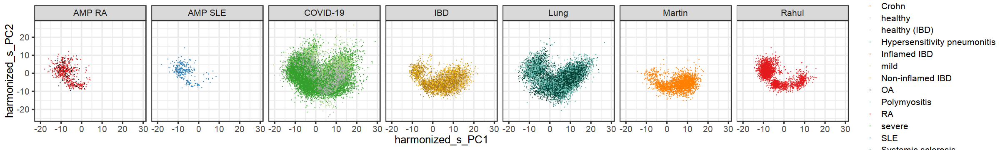

In [24]:
options(repr.plot.height = 3, repr.plot.width = 20)
ggplot(meta_all[sample(nrow(meta_all)),],
       aes(x = harmonized_s_PC1, y = harmonized_s_PC2, fill= disease)
      ) +
  geom_point(size = 0.4, stroke = 0.0001, shape = 21, alpha = 0.9) +
  facet_wrap( ~ dataset, ncol = 7) +
  scale_fill_manual(values = meta_colors$disease, name = "") +
  theme_bw(base_size = 15) 

## Correcting dataset only

In [26]:
# Weighted harmony on pca_res on exprs_cosine 
options(repr.plot.height = 2, repr.plot.width = 4)
harmony_weighted1 <- HarmonyMatrix(pca_res, meta_all, 
                            'dataset', 2, do_pca = FALSE, epsilon.harmony = -Inf, 
                            weights = weights, verbose = FALSE)

colnames(harmony_weighted1) <- paste0("harmonized_d_", colnames(harmony_weighted1), sep="")
meta_all <- cbind(meta_all, harmony_weighted1)
meta_all[1:4,]

cell,dataset,technology,sample,disease,cell_type,nUMI,nGene,percent_mito,percent.ribo,...,harmonized_d_PC11,harmonized_d_PC12,harmonized_d_PC13,harmonized_d_PC14,harmonized_d_PC15,harmonized_d_PC16,harmonized_d_PC17,harmonized_d_PC18,harmonized_d_PC19,harmonized_d_PC20
S006_L1Q1_G01,AMP RA,Celseq,301-0159,OA,SC-M3,1678,878,0,0.01430274,...,-0.9061578,0.6332498,-3.3698777,1.6596011,-0.8282308,3.5794564,5.533784,2.0399083,-0.5315173,-0.3601234
S006_L1Q1_G03,AMP RA,Celseq,301-0159,OA,SC-M2,8439,2608,0,0.01860410,...,2.1082182,1.5740987,-0.6431843,1.0981350,-2.4521038,2.4388712,4.907350,1.4662290,0.2558309,-2.4914536
S006_L1Q1_G05,AMP RA,Celseq,301-0159,OA,SC-M2,5769,2343,0,0.01092044,...,0.7894607,7.2713130,-5.6748325,0.5708121,1.2234044,0.7011787,4.579143,-0.6939952,-4.7958241,-0.2418509
S006_L1Q1_G07,AMP RA,Celseq,301-0159,OA,SC-M2,5354,2031,0,0.02241315,...,3.7700527,1.1500590,-3.9557023,-1.8326687,-4.6558218,-2.3300291,3.174677,0.2934053,0.4891961,-4.1832798


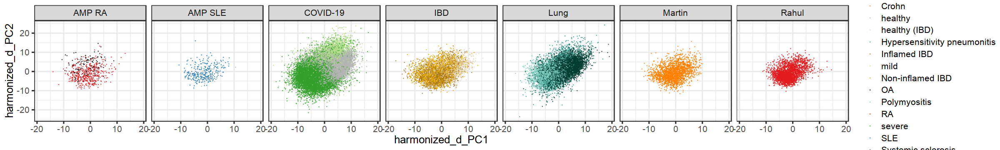

In [27]:
options(repr.plot.height = 3, repr.plot.width = 20)
ggplot(meta_all[sample(nrow(meta_all)),],
       aes(x = harmonized_d_PC1, y = harmonized_d_PC2, fill= disease)
      ) +
  geom_point(size = 0.4, stroke = 0.0001, shape = 21, alpha = 0.9) +
  facet_wrap( ~ dataset, ncol = 7) +
  scale_fill_manual(values = meta_colors$disease, name = "") +
  theme_bw(base_size = 15) 

## Correcting sample and dataset simultaneously

In [28]:
# Weighted harmony on pca_res on exprs_cosine 
options(repr.plot.height = 2, repr.plot.width = 4)
harmony_weighted2 <- HarmonyMatrix(pca_res, meta_all, 
                            c('dataset', 'sample'), c(2, 2), do_pca = FALSE, epsilon.harmony = -Inf, 
                            weights = weights, verbose = FALSE)

colnames(harmony_weighted2) <- paste0("harmonized_ds_", colnames(harmony_weighted2), sep="")
meta_all <- cbind(meta_all, harmony_weighted2)
meta_all[1:4,]

cell,dataset,technology,sample,disease,cell_type,nUMI,nGene,percent_mito,percent.ribo,...,harmonized_ds_PC11,harmonized_ds_PC12,harmonized_ds_PC13,harmonized_ds_PC14,harmonized_ds_PC15,harmonized_ds_PC16,harmonized_ds_PC17,harmonized_ds_PC18,harmonized_ds_PC19,harmonized_ds_PC20
S006_L1Q1_G01,AMP RA,Celseq,301-0159,OA,SC-M3,1678,878,0,0.01430274,...,0.8452887,0.9832890,-1.8509955,1.8435800,1.0709053,0.5886628,1.7738920,-1.8489046,1.275085,-0.73409193
S006_L1Q1_G03,AMP RA,Celseq,301-0159,OA,SC-M2,8439,2608,0,0.01860410,...,-0.3327074,-0.1730167,0.2327469,-2.1928737,0.1180556,0.6572849,0.7396044,0.6421797,-2.075261,0.16083375
S006_L1Q1_G05,AMP RA,Celseq,301-0159,OA,SC-M2,5769,2343,0,0.01092044,...,-1.4067615,3.8621389,-0.5054344,0.8904935,0.5069777,0.5627087,0.8914491,-2.0966459,-1.097354,-0.12903973
S006_L1Q1_G07,AMP RA,Celseq,301-0159,OA,SC-M2,5354,2031,0,0.02241315,...,0.8448589,0.4563174,-1.3388737,0.6106037,-1.1426889,-0.2913684,1.6498950,0.3606500,2.068488,0.08542751


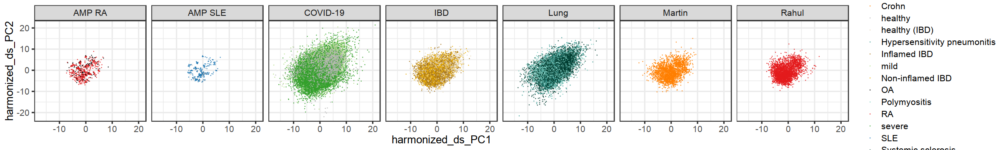

In [29]:
options(repr.plot.height = 3, repr.plot.width = 20)
ggplot(meta_all[sample(nrow(meta_all)),],
       aes(x = harmonized_ds_PC1, y = harmonized_ds_PC2, fill= disease)
      ) +
  geom_point(size = 0.4, stroke = 0.0001, shape = 21, alpha = 0.9) +
  facet_wrap( ~ dataset, ncol = 7) +
  scale_fill_manual(values = meta_colors$disease, name = "") +
  theme_bw(base_size = 15) 

## Correcting for samples for the 10X data, correcting dataset for the AMP data

In [31]:
meta_all$disease_new <- meta_all$disease
meta_all$disease_new[which(meta_all$disease_new == "Non-inflamed IBD")] <- "Non-inflamed UC"
meta_all$disease_new[which(meta_all$disease_new == "Inflamed IBD")] <- "Inflamed UC"
meta_all$disease_new[which(meta_all$disease_new == "healthy (IBD)")] <- "Healthy colon"
meta_all$disease_new[which(meta_all$disease_new == "Polymyositis")] <- "Polymyositis lung"
meta_all$disease_new[which(meta_all$disease_new == "Systemic sclerosis")] <- "SS lung"
meta_all$disease_new[which(meta_all$disease_new == "mild")] <- "Mild BALF"
meta_all$disease_new[which(meta_all$disease_new == "severe")] <- "Severe BALF"
meta_all$disease_new[which(meta_all$disease_new == "healthy" & meta_all$dataset == "COVID-19")] <- "Healthy BALF"
meta_all$disease_new[which(meta_all$disease_new == "healthy" & meta_all$dataset == "AMP SLE")] <- "Healthy kidney"

In [32]:
# https://github.com/effiken/martin_et_al_cell_2019/blob/master/input/tables/sample_index.csv
crohn_inflam <- c("S69", "S122", "S128", "S138", "S158", "S181", "S187", "S190", "S193", "S196", "S209")
crohn_noninflam <- c("S68", "S123",  "S129", "S135", "S159",  "S180",  "S186", "S189", "S192", "S195", "S208")
meta_all[which(meta_all$sample %in% crohn_inflam),]$disease_new <- "Inflamed Crohn"
meta_all[which(meta_all$sample %in% crohn_noninflam),]$disease_new <- "Non-inflamed Crohn"
table(meta_all$disease_new, meta_all$dataset)

                              
                               AMP RA AMP SLE COVID-19   IBD  Lung Martin Rahul
  Healthy BALF                      0       0    17880     0     0      0     0
  Healthy colon                     0       0        0  1936     0      0     0
  Healthy kidney                    0      48        0     0     0      0     0
  Hypersensitivity pneumonitis      0       0        0     0  1414      0     0
  Inflamed Crohn                    0       0        0     0     0   1283     0
  Inflamed UC                       0       0        0  3909     0      0     0
  Mild BALF                         0       0     3597     0     0      0     0
  Non-inflamed Crohn                0       0        0     0     0    938     0
  Non-inflamed UC                   0       0        0  3373     0      0     0
  OA                              130       0        0     0     0      0     0
  Polymyositis lung                 0       0        0     0  3379      0     0
  RA     

In [7]:
meta_all$s_d <- as.character(meta_all$dataset)
meta_all$s_d[which(meta_all$s_d %in% c("COVID-19", "IBD", "Lung", "Martin", "Rahul"))] <- meta_all[which(meta_all$s_d %in% c("COVID-19", "IBD", "Lung", "Martin", "Rahul")), ]$sample
# table(meta_all$dataset, meta_all$s_d)

In [34]:
colnames(meta_all)

[1] "cell"                "dataset"             "technology"         
 [4] "sample"              "disease"             "cell_type"          
 [7] "nUMI"                "nGene"               "percent_mito"       
[10] "percent.ribo"        "harmonized_s_PC1"    "harmonized_s_PC2"   
[13] "harmonized_s_PC3"    "harmonized_s_PC4"    "harmonized_s_PC5"   
[16] "harmonized_s_PC6"    "harmonized_s_PC7"    "harmonized_s_PC8"   
[19] "harmonized_s_PC9"    "harmonized_s_PC10"   "harmonized_s_PC11"  
[22] "harmonized_s_PC12"   "harmonized_s_PC13"   "harmonized_s_PC14"  
[25] "harmonized_s_PC15"   "harmonized_s_PC16"   "harmonized_s_PC17"  
[28] "harmonized_s_PC18"   "harmonized_s_PC19"   "harmonized_s_PC20"  
[31] "harmonized_d_PC1"    "harmonized_d_PC2"    "harmonized_d_PC3"   
[34] "harmonized_d_PC4"    "harmonized_d_PC5"    "harmonized_d_PC6"   
[37] "harmonized_d_PC7"    "harmonized_d_PC8"    "harmonized_d_PC9"   
[40] "harmonized_d_PC10"   "harmonized_d_PC11"   "harmonized_d_PC12"  
[43] "harmonized_d_PC13"   "harmonized_d_PC14"   "harmonized_d_PC15"  
[46] "harmonized_d_PC16"   "harmonized_d_PC17"   "harmonized_d_PC18"  
[49] "harmonized_d_PC19"   "harmonized_d_PC20"   "harmonized_ds_PC1"  
[52] "harmonized_ds_PC2"   "harmonized_ds_PC3"   "harmonized_ds_PC4"  
[55] "harmonized_ds_PC5"   "harmonized_ds_PC6"   "harmonized_ds_PC7"  
[58] "harmonized_ds_PC8"   "harmonized_ds_PC9"   "harmonized_ds_PC10" 
[61] "harmonized_ds_PC11"  "harmonized_ds_PC12"  "harmonized_ds_PC13" 
[64] "harmonized_ds_PC14"  "harmonized_ds_PC15"  "harmonized_ds_PC16" 
[67] "harmonized_ds_PC17"  "harmonized_ds_PC18"  "harmonized_ds_PC19" 
[70] "harmonized_ds_PC20"  "harmonized_s_UMAP1"  "harmonized_s_UMAP2" 
[73] "harmonized_d_UMAP1"  "harmonized_d_UMAP2"  "harmonized_ds_UMAP1"
[76] "harmonized_ds_UMAP2" "disease_new"         "s_d"

In [35]:
# Weighted harmony on pca_res on exprs_cosine 
options(repr.plot.height = 2, repr.plot.width = 4)
harmony_weighted4 <- HarmonyMatrix(pca_res, meta_all, 
                            's_d', 2, do_pca = FALSE, epsilon.harmony = -Inf, 
                            weights = weights, verbose = FALSE)

colnames(harmony_weighted4) <- paste0("harmonized_new_", colnames(harmony_weighted4), sep="")
meta_all <- cbind(meta_all, harmony_weighted4)
meta_all[1:4,]

cell,dataset,technology,sample,disease,cell_type,nUMI,nGene,percent_mito,percent.ribo,...,harmonized_new_PC11,harmonized_new_PC12,harmonized_new_PC13,harmonized_new_PC14,harmonized_new_PC15,harmonized_new_PC16,harmonized_new_PC17,harmonized_new_PC18,harmonized_new_PC19,harmonized_new_PC20
S006_L1Q1_G01,AMP RA,Celseq,301-0159,OA,SC-M3,1678,878,0,0.01430274,...,-0.09283988,-1.271977,-3.258906,2.748087,-0.9238324,1.72880449,5.920630,0.07740935,0.8416386,0.04964062
S006_L1Q1_G03,AMP RA,Celseq,301-0159,OA,SC-M2,8439,2608,0,0.01860410,...,2.66901235,4.996588,-5.325767,-1.435692,-5.8399897,0.03544453,3.919193,0.71228639,-2.2873844,-5.64913735
S006_L1Q1_G05,AMP RA,Celseq,301-0159,OA,SC-M2,5769,2343,0,0.01092044,...,0.47909751,8.763972,-7.325151,0.515196,-0.7922723,-0.17241080,3.097281,-0.34302764,-6.0605748,-0.53765841
S006_L1Q1_G07,AMP RA,Celseq,301-0159,OA,SC-M2,5354,2031,0,0.02241315,...,4.79197059,1.173944,-5.701122,-1.809708,-6.2876647,-3.89286278,2.838593,-0.39407403,1.2890874,-4.79605934


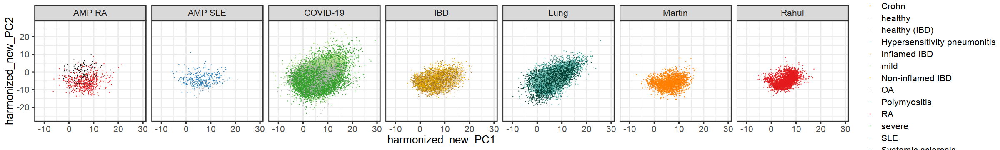

In [36]:
options(repr.plot.height = 3, repr.plot.width = 20)
ggplot(meta_all[sample(nrow(meta_all)),],
       aes(x = harmonized_new_PC1, y = harmonized_new_PC2, fill= disease)
      ) +
  geom_point(size = 0.4, stroke = 0.0001, shape = 21, alpha = 0.9) +
  facet_wrap( ~ dataset, ncol = 7) +
  scale_fill_manual(values = meta_colors$disease, name = "") +
  theme_bw(base_size = 15) 

In [ ]:
# saveRDS(meta_all, "meta_all_weighted_macropahge_cosine_new_2020_06_09.rds")

Warning message:
“package ‘umap’ was built under R version 3.6.3”Registered S3 method overwritten by 'openssl':
  method      from
  print.bytes Rcpp


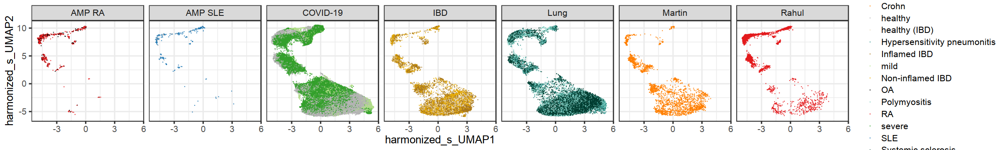

In [31]:
# UMAP with top 20 PCs
library(umap)
umap_res <- umap(harmony_weighted3, n_neighbors = 30, metric = "cosine", min_dist = .1)
meta_all$harmonized_s_UMAP1 <- umap_res$layout[, 1]
meta_all$harmonized_s_UMAP2 <- umap_res$layout[, 2]

options(repr.plot.height = 3, repr.plot.width = 20)
ggplot(meta_all[sample(nrow(meta_all)),],
       aes(x = harmonized_s_UMAP1, y = harmonized_s_UMAP2, fill= disease)
      ) +
  geom_point(size = 0.4, stroke = 0.0001, shape = 21, alpha = 0.9) +
  facet_wrap( ~ dataset, ncol = 7) +
  scale_fill_manual(values = meta_colors$disease, name = "") +
  theme_bw(base_size = 15) 

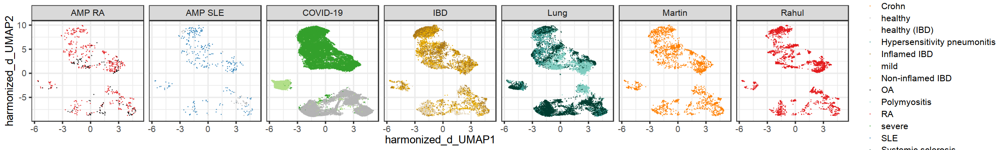

In [32]:
# UMAP with top 20 PCs
library(umap)
umap_res <- umap(harmony_weighted1, n_neighbors = 30, metric = "cosine", min_dist = .1)
meta_all$harmonized_d_UMAP1 <- umap_res$layout[, 1]
meta_all$harmonized_d_UMAP2 <- umap_res$layout[, 2]

options(repr.plot.height = 3, repr.plot.width = 20)
ggplot(meta_all[sample(nrow(meta_all)),],
       aes(x = harmonized_d_UMAP1, y = harmonized_d_UMAP2, fill= disease)
      ) +
  geom_point(size = 0.4, stroke = 0.0001, shape = 21, alpha = 0.9) +
  facet_wrap( ~ dataset, ncol = 7) +
  scale_fill_manual(values = meta_colors$disease, name = "") +
  theme_bw(base_size = 15) 

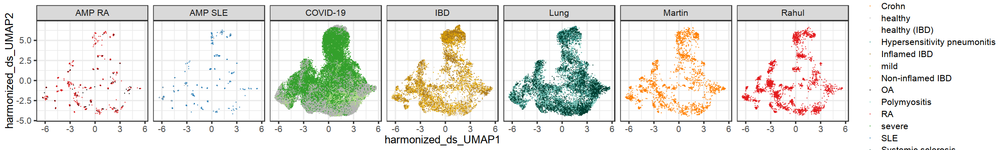

In [33]:
# UMAP with top 20 PCs
library(umap)
umap_res <- umap(harmony_weighted2, n_neighbors = 30, metric = "cosine", min_dist = .1)
meta_all$harmonized_ds_UMAP1 <- umap_res$layout[, 1]
meta_all$harmonized_ds_UMAP2 <- umap_res$layout[, 2]

options(repr.plot.height = 3, repr.plot.width = 20)
ggplot(meta_all[sample(nrow(meta_all)),],
       aes(x = harmonized_ds_UMAP1, y = harmonized_ds_UMAP2, fill= disease)
      ) +
  geom_point(size = 0.4, stroke = 0.0001, shape = 21, alpha = 0.9) +
  facet_wrap( ~ dataset, ncol = 7) +
  scale_fill_manual(values = meta_colors$disease, name = "") +
  theme_bw(base_size = 15) 

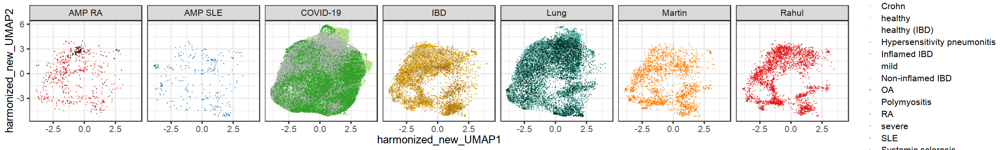

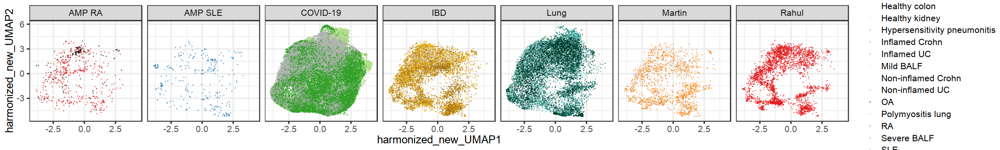

In [53]:
# UMAP with top 20 PCs
library(umap)
umap_res <- umap(harmony_weighted4, n_neighbors = 30, metric = "cosine", min_dist = .1)
meta_all$harmonized_new_UMAP1 <- umap_res$layout[, 1]
meta_all$harmonized_new_UMAP2 <- umap_res$layout[, 2]

options(repr.plot.height = 3, repr.plot.width = 20)
ggplot(meta_all[sample(nrow(meta_all)),],
       aes(x = harmonized_new_UMAP1, y = harmonized_new_UMAP2, fill= disease)
      ) +
  geom_point(size = 0.4, stroke = 0.0001, shape = 21, alpha = 0.9) +
  facet_wrap( ~ dataset, ncol = 7) +
  scale_fill_manual(values = meta_colors$disease, name = "") +
  theme_bw(base_size = 15) 


options(repr.plot.height = 3, repr.plot.width = 20)
ggplot(meta_all[sample(nrow(meta_all)),],
       aes(x = harmonized_new_UMAP1, y = harmonized_new_UMAP2, fill= disease_new)
      ) +
  geom_point(size = 0.4, stroke = 0.0001, shape = 21, alpha = 0.9) +
  facet_wrap( ~ dataset, ncol = 7) +
  scale_fill_manual(values = meta_colors$disease, name = "") +
  theme_bw(base_size = 15) 

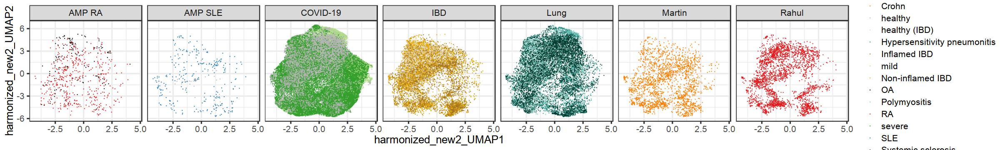

In [54]:
# UMAP with top 20 PCs
library(umap)
umap_res <- umap(harmony_weighted4[, c(1:10)], n_neighbors = 30, metric = "cosine", min_dist = .1)
meta_all$harmonized_new2_UMAP1 <- umap_res$layout[, 1]
meta_all$harmonized_new2_UMAP2 <- umap_res$layout[, 2]

options(repr.plot.height = 3, repr.plot.width = 20)
ggplot(meta_all[sample(nrow(meta_all)),],
       aes(x = harmonized_new2_UMAP1, y = harmonized_new2_UMAP2, fill= disease)
      ) +
  geom_point(size = 0.4, stroke = 0.0001, shape = 21, alpha = 0.9) +
  facet_wrap( ~ dataset, ncol = 7) +
  scale_fill_manual(values = meta_colors$disease, name = "") +
  theme_bw(base_size = 15) 

In [55]:
# saveRDS(meta_all, "meta_all_weighted_macropahge_cosine_s_d_ds_new_2020_06_09.rds")

In [4]:
meta_all <- readRDS("meta_all_weighted_macropahge_cosine_s_d_ds_new_cluster_2020_07_01.rds")

## Visualizing results

In [7]:
require(gridExtra)

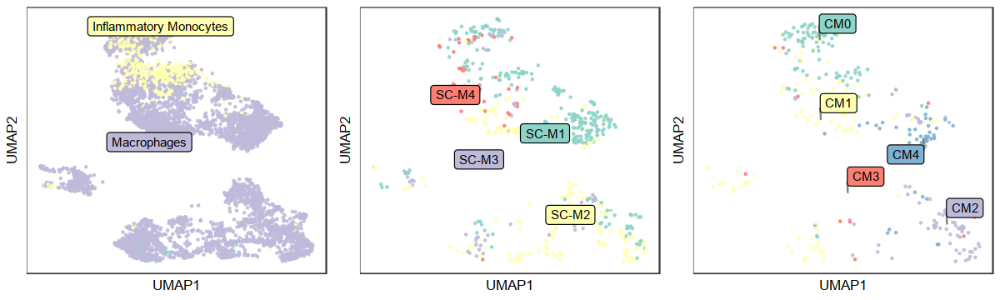

In [37]:
options(repr.plot.height = 3, repr.plot.width = 10)

meta_all$dataset <- as.character(meta_all$dataset)

cluster_center <- meta_all[which(meta_all$dataset == "IBD"),] %>%
                  group_by(cell_type) %>%
                  summarise_at(vars(harmonized_d_UMAP1, harmonized_d_UMAP2), funs(median(., na.rm=TRUE)))
cluster_center <- as.data.frame(cluster_center)
cluster_center$cell_type <- as.character(cluster_center$cell_type)

p1 <- ggplot(meta_all[which(meta_all$dataset == "IBD"),],
       aes(x = harmonized_d_UMAP1, y = harmonized_d_UMAP2, fill= cell_type)
      ) +
  geom_point(size = 1, stroke = 0.0001, shape = 21, alpha = 0.9) +
  geom_label_repel(
    data = cluster_center[-which(cluster_center$cell_type == "Cycling Monocytes"),],
    aes(label = cell_type, fill = cell_type),
#     fontface = 'bold', 
    size = 3, 
    box.padding = unit(0.2, "lines"),
    point.padding = unit(0.2, "lines"),
    segment.color = 'grey50'
  ) +
  scale_fill_manual(values = c(set3, colors37), name = "") +
  labs(
      x = "UMAP1",
      y = "UMAP2"
      ) +
  theme_bw(base_size = 10) +
  theme(
    legend.position = "none",
    axis.text = element_blank(),
    axis.ticks = element_blank(),
    panel.grid = element_blank(),
    plot.title = element_text(color="black", size=10, face = "italic")
)

cluster_center <- meta_all[which(meta_all$dataset == "AMP RA"),] %>%
                  group_by(cell_type) %>%
                  summarise_at(vars(harmonized_d_UMAP1, harmonized_d_UMAP2), funs(median(., na.rm=TRUE)))
cluster_center <- as.data.frame(cluster_center)
cluster_center$cell_type <- as.character(cluster_center$cell_type)


p2 <- ggplot(meta_all[which(meta_all$dataset == "AMP RA"),],
       aes(x = harmonized_d_UMAP1, y = harmonized_d_UMAP2, fill= cell_type)
      ) +
  geom_point(size = 1, stroke = 0.0001, shape = 21, alpha = 0.9) +
  geom_label_repel(
    data = cluster_center,
    aes(label = cell_type, fill = cell_type),
#     fontface = 'bold', 
    size = 3, 
    box.padding = unit(0.2, "lines"),
    point.padding = unit(0.2, "lines"),
    segment.color = 'grey50'
  ) +
  scale_fill_manual(values = c(set3, colors37), name = "") +
  labs(
      x = "UMAP1",
      y = "UMAP2"
      ) +
  theme_bw(base_size = 10) +
  theme(
    legend.position = "none",
    axis.text = element_blank(),
    axis.ticks = element_blank(),
    panel.grid = element_blank(),
    plot.title = element_text(color="black", size=10, face = "italic")
)



cluster_center <- meta_all[which(meta_all$dataset == "AMP SLE"),] %>%
                  group_by(cell_type) %>%
                  summarise_at(vars(harmonized_d_UMAP1, harmonized_d_UMAP2), funs(median(., na.rm=TRUE)))
cluster_center <- as.data.frame(cluster_center)
cluster_center$cell_type <- as.character(cluster_center$cell_type)


p3 <- ggplot(meta_all[which(meta_all$dataset == "AMP SLE"),],
       aes(x = harmonized_d_UMAP1, y = harmonized_d_UMAP2, fill= cell_type)
      ) +
  geom_point(size = 1, stroke = 0.0001, shape = 21, alpha = 0.9) +
  geom_label_repel(
    data = cluster_center,
    aes(label = cell_type, fill = cell_type),
#     fontface = 'bold', 
    size = 3, 
    box.padding = unit(0.2, "lines"),
    point.padding = unit(0.2, "lines"),
    segment.color = 'grey50'
  ) +
  scale_fill_manual(values = c(set3, colors37), name = "") +
  labs(
      x = "UMAP1",
      y = "UMAP2"
      ) +
  theme_bw(base_size = 10) +
  theme(
    legend.position = "none",
    axis.text = element_blank(),
    axis.ticks = element_blank(),
    panel.grid = element_blank(),
    plot.title = element_text(color="black", size=10, face = "italic")
)

grid.arrange(p1, p2, p3, ncol = 3)

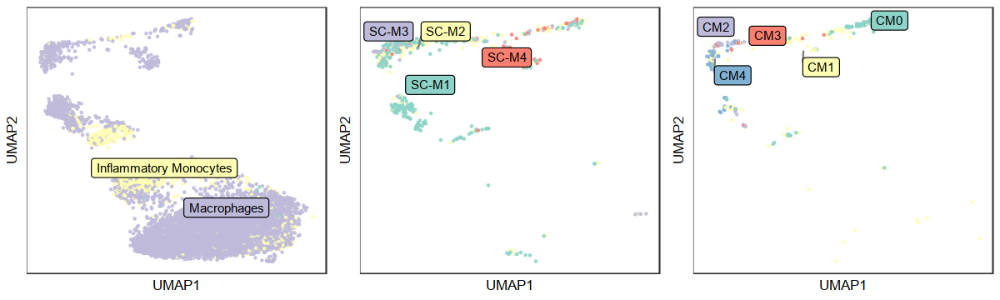

In [39]:
options(repr.plot.height = 3, repr.plot.width = 10)

meta_all$dataset <- as.character(meta_all$dataset)

cluster_center <- meta_all[which(meta_all$dataset == "IBD"),] %>%
                  group_by(cell_type) %>%
                  summarise_at(vars(harmonized_s_UMAP1, harmonized_s_UMAP2), funs(median(., na.rm=TRUE)))
cluster_center <- as.data.frame(cluster_center)
cluster_center$cell_type <- as.character(cluster_center$cell_type)

p1 <- ggplot(meta_all[which(meta_all$dataset == "IBD"),],
       aes(x = harmonized_s_UMAP1, y = harmonized_s_UMAP2, fill= cell_type)
      ) +
  geom_point(size = 1, stroke = 0.0001, shape = 21, alpha = 0.9) +
  geom_label_repel(
    data = cluster_center[-which(cluster_center$cell_type == "Cycling Monocytes"),],
    aes(label = cell_type, fill = cell_type),
#     fontface = 'bold', 
    size = 3, 
    box.padding = unit(0.2, "lines"),
    point.padding = unit(0.2, "lines"),
    segment.color = 'grey50'
  ) +
  scale_fill_manual(values = c(set3, colors37), name = "") +
  labs(
      x = "UMAP1",
      y = "UMAP2"
      ) +
  theme_bw(base_size = 10) +
  theme(
    legend.position = "none",
    axis.text = element_blank(),
    axis.ticks = element_blank(),
    panel.grid = element_blank(),
    plot.title = element_text(color="black", size=10, face = "italic")
)

cluster_center <- meta_all[which(meta_all$dataset == "AMP RA"),] %>%
                  group_by(cell_type) %>%
                  summarise_at(vars(harmonized_s_UMAP1, harmonized_s_UMAP2), funs(median(., na.rm=TRUE)))
cluster_center <- as.data.frame(cluster_center)
cluster_center$cell_type <- as.character(cluster_center$cell_type)


p2 <- ggplot(meta_all[which(meta_all$dataset == "AMP RA"),],
       aes(x = harmonized_s_UMAP1, y = harmonized_s_UMAP2, fill= cell_type)
      ) +
  geom_point(size = 1, stroke = 0.0001, shape = 21, alpha = 0.9) +
  geom_label_repel(
    data = cluster_center,
    aes(label = cell_type, fill = cell_type),
#     fontface = 'bold', 
    size = 3, 
    box.padding = unit(0.2, "lines"),
    point.padding = unit(0.2, "lines"),
    segment.color = 'grey50'
  ) +
  scale_fill_manual(values = c(set3, colors37), name = "") +
  labs(
      x = "UMAP1",
      y = "UMAP2"
      ) +
  theme_bw(base_size = 10) +
  theme(
    legend.position = "none",
    axis.text = element_blank(),
    axis.ticks = element_blank(),
    panel.grid = element_blank(),
    plot.title = element_text(color="black", size=10, face = "italic")
)



cluster_center <- meta_all[which(meta_all$dataset == "AMP SLE"),] %>%
                  group_by(cell_type) %>%
                  summarise_at(vars(harmonized_s_UMAP1, harmonized_s_UMAP2), funs(median(., na.rm=TRUE)))
cluster_center <- as.data.frame(cluster_center)
cluster_center$cell_type <- as.character(cluster_center$cell_type)

p3 <- ggplot(meta_all[which(meta_all$dataset == "AMP SLE"),],
       aes(x = harmonized_s_UMAP1, y = harmonized_s_UMAP2, fill= cell_type)
      ) +
  geom_point(size = 1, stroke = 0.0001, shape = 21, alpha = 0.9) +
  geom_label_repel(
    data = cluster_center,
    aes(label = cell_type, fill = cell_type),
#     fontface = 'bold', 
    size = 3, 
    box.padding = unit(0.2, "lines"),
    point.padding = unit(0.2, "lines"),
    segment.color = 'grey50'
  ) +
  scale_fill_manual(values = c(set3, colors37), name = "") +
  labs(
      x = "UMAP1",
      y = "UMAP2"
      ) +
  theme_bw(base_size = 10) +
  theme(
    legend.position = "none",
    axis.text = element_blank(),
    axis.ticks = element_blank(),
    panel.grid = element_blank(),
    plot.title = element_text(color="black", size=10, face = "italic")
)

grid.arrange(p1, p2, p3, ncol = 3)

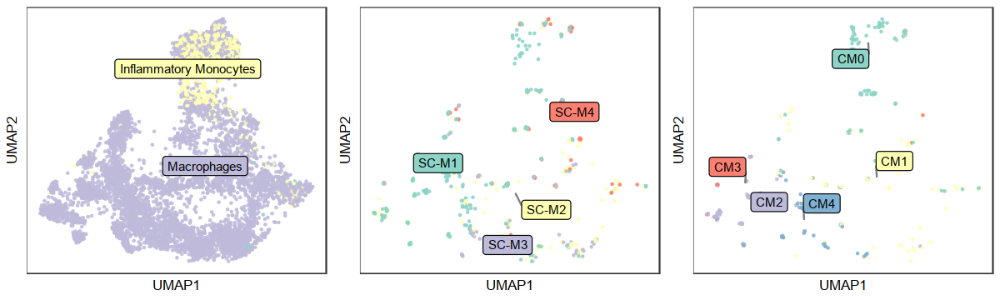

In [40]:
options(repr.plot.height = 3, repr.plot.width = 10)

meta_all$dataset <- as.character(meta_all$dataset)

cluster_center <- meta_all[which(meta_all$dataset == "IBD"),] %>%
                  group_by(cell_type) %>%
                  summarise_at(vars(harmonized_ds_UMAP1, harmonized_ds_UMAP2), funs(median(., na.rm=TRUE)))
cluster_center <- as.data.frame(cluster_center)
cluster_center$cell_type <- as.character(cluster_center$cell_type)

p1 <- ggplot(meta_all[which(meta_all$dataset == "IBD"),],
       aes(x = harmonized_ds_UMAP1, y = harmonized_ds_UMAP2, fill= cell_type)
      ) +
  geom_point(size = 1, stroke = 0.0001, shape = 21, alpha = 0.9) +
  geom_label_repel(
    data = cluster_center[-which(cluster_center$cell_type == "Cycling Monocytes"),],
    aes(label = cell_type, fill = cell_type),
#     fontface = 'bold', 
    size = 3, 
    box.padding = unit(0.2, "lines"),
    point.padding = unit(0.2, "lines"),
    segment.color = 'grey50'
  ) +
  scale_fill_manual(values = c(set3, colors37), name = "") +
  labs(
      x = "UMAP1",
      y = "UMAP2"
      ) +
  theme_bw(base_size = 10) +
  theme(
    legend.position = "none",
    axis.text = element_blank(),
    axis.ticks = element_blank(),
    panel.grid = element_blank(),
    plot.title = element_text(color="black", size=10, face = "italic")
)

cluster_center <- meta_all[which(meta_all$dataset == "AMP RA"),] %>%
                  group_by(cell_type) %>%
                  summarise_at(vars(harmonized_ds_UMAP1, harmonized_ds_UMAP2), funs(median(., na.rm=TRUE)))
cluster_center <- as.data.frame(cluster_center)
cluster_center$cell_type <- as.character(cluster_center$cell_type)


p2 <- ggplot(meta_all[which(meta_all$dataset == "AMP RA"),],
       aes(x = harmonized_ds_UMAP1, y = harmonized_ds_UMAP2, fill= cell_type)
      ) +
  geom_point(size = 1, stroke = 0.0001, shape = 21, alpha = 0.9) +
  geom_label_repel(
    data = cluster_center,
    aes(label = cell_type, fill = cell_type),
#     fontface = 'bold', 
    size = 3, 
    box.padding = unit(0.2, "lines"),
    point.padding = unit(0.2, "lines"),
    segment.color = 'grey50'
  ) +
  scale_fill_manual(values = c(set3, colors37), name = "") +
  labs(
      x = "UMAP1",
      y = "UMAP2"
      ) +
  theme_bw(base_size = 10) +
  theme(
    legend.position = "none",
    axis.text = element_blank(),
    axis.ticks = element_blank(),
    panel.grid = element_blank(),
    plot.title = element_text(color="black", size=10, face = "italic")
)



cluster_center <- meta_all[which(meta_all$dataset == "AMP SLE"),] %>%
                  group_by(cell_type) %>%
                  summarise_at(vars(harmonized_ds_UMAP1, harmonized_ds_UMAP2), funs(median(., na.rm=TRUE)))
cluster_center <- as.data.frame(cluster_center)
cluster_center$cell_type <- as.character(cluster_center$cell_type)

p3 <- ggplot(meta_all[which(meta_all$dataset == "AMP SLE"),],
       aes(x = harmonized_ds_UMAP1, y = harmonized_ds_UMAP2, fill= cell_type)
      ) +
  geom_point(size = 1, stroke = 0.0001, shape = 21, alpha = 0.9) +
  geom_label_repel(
    data = cluster_center,
    aes(label = cell_type, fill = cell_type),
#     fontface = 'bold', 
    size = 3, 
    box.padding = unit(0.2, "lines"),
    point.padding = unit(0.2, "lines"),
    segment.color = 'grey50'
  ) +
  scale_fill_manual(values = c(set3, colors37), name = "") +
  labs(
      x = "UMAP1",
      y = "UMAP2"
      ) +
  theme_bw(base_size = 10) +
  theme(
    legend.position = "none",
    axis.text = element_blank(),
    axis.ticks = element_blank(),
    panel.grid = element_blank(),
    plot.title = element_text(color="black", size=10, face = "italic")
)

grid.arrange(p1, p2, p3, ncol = 3)

In [2]:
meta_all <- readRDS("meta_all_weighted_macropahge_cosine_s_d_ds_new_cluster_2020_07_01.rds")

null device 
          1

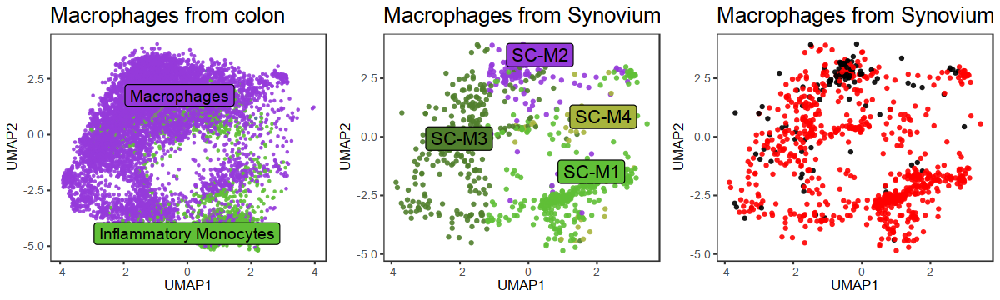

In [43]:
options(repr.plot.height = 3, repr.plot.width = 10)

meta_all$dataset <- as.character(meta_all$dataset)

cluster_center <- meta_all[which(meta_all$dataset == "IBD"),] %>%
                  group_by(cell_type) %>%
                  summarise_at(vars(harmonized_new_UMAP1, harmonized_new_UMAP2), funs(median(., na.rm=TRUE)))
cluster_center <- as.data.frame(cluster_center)
cluster_center$cell_type <- as.character(cluster_center$cell_type)

p1 <- ggplot(meta_all[which(meta_all$dataset == "IBD"),],
       aes(x = harmonized_new_UMAP1, y = harmonized_new_UMAP2, fill= cell_type)
      ) +
  geom_point(size = 1, stroke = 0.0001, shape = 21, alpha = 0.9) +
  geom_label_repel(
    data = cluster_center[-which(cluster_center$cell_type == "Cycling Monocytes"),],
    aes(label = cell_type, fill = cell_type),
#     fontface = 'bold', 
    size = 4, 
    box.padding = unit(0.5, "lines"),
    point.padding = unit(0.2, "lines"),
    segment.color = 'grey50'
  ) +
  scale_fill_manual(values = colors37, name = "") +
  labs(
      x = "UMAP1",
      y = "UMAP2",
      title = "Macrophages from colon"
      ) +
  theme_bw(base_size = 10) +
  theme(
    legend.position = "none",
#     axis.text = element_blank(),
#     axis.ticks = element_blank(),
    panel.grid = element_blank(),
    plot.title = element_text(color="black", size=15)
)



meta_all[which((meta_all$dataset == "AMP RA" & meta_all$cell_type == "SC-M1") | (meta_all$res_0.20_annot == "IL1B+ CXCL10+" & meta_all$dataset == "Rahul")),]$cell_type <- "SC-M1"
meta_all[which(meta_all$harmonized_new_UMAP1 < -1.2 ),]$cell_type <- "SC-M3"
cluster_center <- meta_all[which(meta_all$dataset == "AMP RA" | (meta_all$res_0.20_annot == "IL1B+ CXCL10+" & meta_all$dataset == "Rahul")),] %>%
                  group_by(cell_type) %>%
                  summarise_at(vars(harmonized_new_UMAP1, harmonized_new_UMAP2), funs(median(., na.rm=TRUE)))
cluster_center <- as.data.frame(cluster_center)
cluster_center$cell_type <- as.character(cluster_center$cell_type)
# cluster_center[1,2] <-  0
# cluster_center[1,3] <- -3.2
cluster_center[3,2] <- cluster_center[3,2] - 1
cluster_center[3,3] <- cluster_center[3,3] - 1

p2 <- ggplot(meta_all[which(meta_all$dataset == "AMP RA" | (meta_all$res_0.20_annot == "IL1B+ CXCL10+" & meta_all$dataset == "Rahul")),],
       aes(x = harmonized_new_UMAP1, y = harmonized_new_UMAP2, fill= cell_type)
      ) +
  geom_point(size = 1.5, stroke = 0.0001, shape = 21, alpha = 0.9) +
  geom_label_repel(
    data = cluster_center,
    aes(label = cell_type, fill = cell_type),
#     fontface = 'bold', 
    size = 4.5, 
    box.padding = unit(0.2, "lines"),
    point.padding = unit(0.2, "lines"),
    segment.color = 'grey50'
  ) +
  scale_fill_manual(values = colors37[c(2,3,10,6)], name = "") +
  labs(
      x = "UMAP1",
      y = "UMAP2",
      title = "Macrophages from Synovium"
      ) +
  theme_bw(base_size = 10) +
  theme(
    legend.position = "none",
#     axis.text = element_blank(),
#     axis.ticks = element_blank(),
    panel.grid = element_blank(),
    plot.title = element_text(color="black", size=15)
)


meta_all[which((meta_all$dataset == "AMP RA" & meta_all$cell_type == "SC-M1") | (meta_all$res_0.20_annot == "IL1B+ CXCL10+" & meta_all$dataset == "Rahul")),]$cell_type <- "SC-M1"
meta_all[which(meta_all$harmonized_new_UMAP1 < -1.2 ),]$cell_type <- "SC-M3"
cluster_center <- meta_all[which(meta_all$dataset == "AMP RA" | (meta_all$res_0.20_annot == "IL1B+ CXCL10+" & meta_all$dataset == "Rahul")),] %>%
                  group_by(cell_type) %>%
                  summarise_at(vars(harmonized_new_UMAP1, harmonized_new_UMAP2), funs(median(., na.rm=TRUE)))
cluster_center <- as.data.frame(cluster_center)
cluster_center$cell_type <- as.character(cluster_center$cell_type)
# cluster_center[1,2] <-  0
# cluster_center[1,3] <- -3.2
cluster_center[3,2] <- cluster_center[3,2] - 1
cluster_center[3,3] <- cluster_center[3,3] - 1

p3 <- ggplot(meta_all[which(meta_all$dataset == "AMP RA" | (meta_all$res_0.20_annot == "IL1B+ CXCL10+" & meta_all$dataset == "Rahul")),],
       aes(x = harmonized_new_UMAP1, y = harmonized_new_UMAP2, fill= disease_new)
      ) +
  geom_point(size = 1.5, stroke = 0.0001, shape = 21, alpha = 0.9) +
#   geom_label_repel(
#     data = cluster_center,
#     aes(label = cell_type, fill = cell_type),
# #     fontface = 'bold', 
#     size = 4.5, 
#     box.padding = unit(0.2, "lines"),
#     point.padding = unit(0.2, "lines"),
#     segment.color = 'grey50'
#   ) +
  scale_fill_manual(values = c("black", "red"), name = "") +
  labs(
      x = "UMAP1",
      y = "UMAP2",
      title = "Macrophages from Synovium"
      ) +
  theme_bw(base_size = 10) +
  theme(
    legend.position = "none",
#     axis.text = element_blank(),
#     axis.ticks = element_blank(),
    panel.grid = element_blank(),
    plot.title = element_text(color="black", size=15)
)




cluster_center <- meta_all[which(meta_all$dataset == "AMP SLE"),] %>%
                  group_by(cell_type) %>%
                  summarise_at(vars(harmonized_new_UMAP1, harmonized_new_UMAP2), funs(median(., na.rm=TRUE)))
cluster_center <- as.data.frame(cluster_center)
cluster_center$cell_type <- as.character(cluster_center$cell_type)

p4 <- ggplot(meta_all[which(meta_all$dataset == "AMP SLE"),],
       aes(x = harmonized_new_UMAP1, y = harmonized_new_UMAP2, fill = cell_type)
      ) +
  geom_point(size = 1.5, stroke = 0.0001, shape = 21, alpha = 0.9) +
  geom_label_repel(
    data = cluster_center,
    aes(label = cell_type, fill = cell_type),
#     fontface = 'bold', 
    size = 4.5, 
    box.padding = unit(0.2, "lines"),
    point.padding = unit(0.2, "lines"),
    segment.color = 'grey50'
  ) +
#   scale_fill_manual(values = colors37[c(2,1,4,6,9,10)], name = "") +
  labs(
      x = "UMAP1",
      y = "UMAP2",
      title = "Macrophages from kidney"
      ) +
  theme_bw(base_size = 10) +
  theme(
    legend.position = "none",
#     axis.text = element_blank(),
#     axis.ticks = element_blank(),
    panel.grid = element_blank(),
    plot.title = element_text(color="black", size=15)
)

all <- grid.arrange(p1, p2, p3, ncol = 3)
ggsave(file = paste("old_mono_lables", ".png", sep = ""), all, width = 10, height = 3, dpi = 300)
dev.off()

In [21]:
table(meta_all$dataset, meta_all$disease_new)

          
           Healthy BALF Mild COVID-19 Severe COVID-19 Polymyositis lung SS lung
  AMP RA              0             0               0                 0       0
  AMP SLE             0             0               0                 0       0
  COVID-19        17878          3597           26263                 0       0
  IBD                 0             0               0                 0       0
  Lung                0             0               0              3372    6704
  Martin              0             0               0                 0       0
  Rahul               0             0               0                 0       0
          
           Hypersensitivity pneumonitis Healthy colon Non-inflamed UC
  AMP RA                              0             0               0
  AMP SLE                             0             0               0
  COVID-19                            0             0               0
  IBD                                 0          1935     

null device 
          1

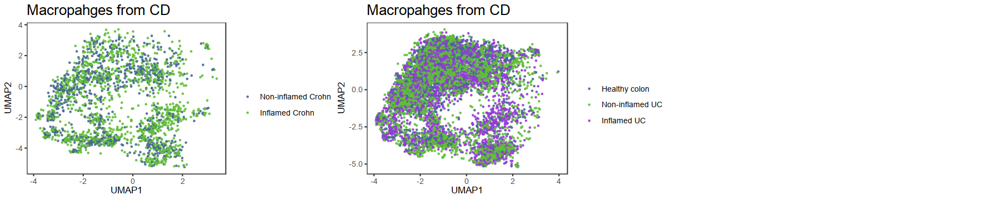

In [25]:
options(repr.plot.height = 3, repr.plot.width = 15)


cluster_center <- meta_all[which(meta_all$dataset == "Martin"),] %>%
                  group_by(cell_type) %>%
                  summarise_at(vars(harmonized_new_UMAP1, harmonized_new_UMAP2), funs(median(., na.rm=TRUE)))
cluster_center <- as.data.frame(cluster_center)
cluster_center$cell_type <- as.character(cluster_center$cell_type)

d1 <- ggplot(meta_all[which(meta_all$dataset == "Martin"),],
       aes(x = harmonized_new_UMAP1, y = harmonized_new_UMAP2, fill= disease_new)
      ) +
  geom_point(size = 1, stroke = 0.0001, shape = 21, alpha = 0.9) +
#   geom_label_repel(
#     data = cluster_center[-which(cluster_center$cell_type == "Cycling Monocytes"),],
#     aes(label = cell_type, fill = cell_type),
# #     fontface = 'bold', 
#     size = 4, 
#     box.padding = unit(0.5, "lines"),
#     point.padding = unit(0.2, "lines"),
#     segment.color = 'grey50'
#   ) +
  scale_fill_manual(values = colors37, name = "") +
  labs(
      x = "UMAP1",
      y = "UMAP2",
      title = "Macropahges from CD"
      ) +
  theme_bw(base_size = 10) +
  theme(
#     legend.position = "none",
#     axis.text = element_blank(),
#     axis.ticks = element_blank(),
    panel.grid = element_blank(),
    plot.title = element_text(color="black", size=15)
)


cluster_center <- meta_all[which(meta_all$dataset == "IBD"),] %>%
                  group_by(cell_type) %>%
                  summarise_at(vars(harmonized_new_UMAP1, harmonized_new_UMAP2), funs(median(., na.rm=TRUE)))
cluster_center <- as.data.frame(cluster_center)
cluster_center$cell_type <- as.character(cluster_center$cell_type)

d2 <- ggplot(meta_all[which(meta_all$dataset == "IBD"),],
       aes(x = harmonized_new_UMAP1, y = harmonized_new_UMAP2, fill= disease_new)
      ) +
  geom_point(size = 1, stroke = 0.0001, shape = 21, alpha = 0.9) +
#   geom_label_repel(
#     data = cluster_center[-which(cluster_center$cell_type == "Cycling Monocytes"),],
#     aes(label = cell_type, fill = cell_type),
# #     fontface = 'bold', 
#     size = 4, 
#     box.padding = unit(0.5, "lines"),
#     point.padding = unit(0.2, "lines"),
#     segment.color = 'grey50'
#   ) +
  scale_fill_manual(values = colors37, name = "") +
  labs(
      x = "UMAP1",
      y = "UMAP2",
      title = "Macropahges from CD"
      ) +
  theme_bw(base_size = 10) +
  theme(
#     legend.position = "none",
#     axis.text = element_blank(),
#     axis.ticks = element_blank(),
    panel.grid = element_blank(),
    plot.title = element_text(color="black", size=15)
)


cluster_center <- meta_all[which(meta_all$dataset == "IBD"),] %>%
                  group_by(cell_type) %>%
                  summarise_at(vars(harmonized_new_UMAP1, harmonized_new_UMAP2), funs(median(., na.rm=TRUE)))
cluster_center <- as.data.frame(cluster_center)
cluster_center$cell_type <- as.character(cluster_center$cell_type)

d3 <- ggplot(meta_all[which(meta_all$dataset == "IBD"),],
       aes(x = harmonized_new_UMAP1, y = harmonized_new_UMAP2, fill= disease_new)
      ) +
  geom_point(size = 1, stroke = 0.0001, shape = 21, alpha = 0.9) +
#   geom_label_repel(
#     data = cluster_center[-which(cluster_center$cell_type == "Cycling Monocytes"),],
#     aes(label = cell_type, fill = cell_type),
# #     fontface = 'bold', 
#     size = 4, 
#     box.padding = unit(0.5, "lines"),
#     point.padding = unit(0.2, "lines"),
#     segment.color = 'grey50'
#   ) +
  scale_fill_manual(values = colors37, name = "") +
  labs(
      x = "UMAP1",
      y = "UMAP2",
      title = "Macropahges from CD"
      ) +
  theme_bw(base_size = 10) +
  theme(
#     legend.position = "none",
#     axis.text = element_blank(),
#     axis.ticks = element_blank(),
    panel.grid = element_blank(),
    plot.title = element_text(color="black", size=15)
)



all <- grid.arrange(d1, d2, ncol = 3)
# ggsave(file = paste("old_mono_lables", ".png", sep = ""), all, width = 10, height = 3, dpi = 300)
dev.off()

In [ ]:
options(repr.plot.height = 3, repr.plot.width = 9)

meta_all$highligh_UC <- rep("macrophages", nrow(meta_all))
meta_all[which(meta_all$cell_type == "Inflammatory Monocytes" & meta_all$dataset == "IBD"),]$highligh_UC <- "Inflammatory macrophages"
meta_temp <- meta_all[which(meta_all$dataset == "IBD"),]
p1 <- ggplot(meta_temp[rev(order(meta_temp$highligh_UC)),],
       aes(x = harmonized_new_UMAP1, y = harmonized_new_UMAP2, fill= highligh_UC)
      ) +
  geom_point(size = 1, stroke = 0.0001, shape = 21, alpha = 0.9) +
  scale_fill_manual(values = c("red", "grey"), name = "") +
  labs(
      x = "UMAP1",
      y = "UMAP2"
#       title = "Inflamed UC macrophages"
      ) +
  theme_bw(base_size = 15) +
  theme(
    legend.position = "none",
#     axis.text = element_blank(),
#     axis.ticks = element_blank(),
    panel.grid = element_blank(),
    plot.title = element_text(color="black", size=14)
)

# meta_all$highligh_RA <- rep("macrophages", nrow(meta_all))
# meta_all[which(meta_all$harmonized_new_UMAP1 > -1.2 & meta_all$cell_type == "SC-M1" & meta_all$dataset == "AMP RA"),]$highligh_RA <- "Inflammatory monocytes"
# meta_temp <- meta_all[which(meta_all$dataset == "AMP RA"),]
# p2 <- ggplot(meta_temp[sample(nrow(meta_temp)),],
#        aes(x = harmonized_new_UMAP1, y = harmonized_new_UMAP2, fill= highligh_RA)
#       ) +
#   geom_point(size = 1.5, stroke = 0.0001, shape = 21, alpha = 0.9) +
#   scale_fill_manual(values = c("red", "grey"), name = "") +
#   labs(
#       x = "UMAP1",
#       y = "UMAP2",
#       title = "RA macrophages"
#       ) +
#   theme_bw(base_size = 15) +
#   theme(
#     legend.position = "none",
# #     axis.text = element_blank(),
# #     axis.ticks = element_blank(),
#     panel.grid = element_blank(),
#     plot.title = element_text(color="black", size=20)
# )

# Put AMP and Rahul together
meta_all$highligh_RA <- rep("macrophages", nrow(meta_all))
meta_all[which(meta_all$res_0.20_annot %in% c("IL1B+ CXCL10+", "FCN1+") & meta_all$disease_new == "RA"),]$highligh_RA <- "Inflammatory monocytes"
meta_temp <- meta_all[which(meta_all$disease_new == "RA"),]
p2 <- ggplot(meta_temp[sample(nrow(meta_temp)),],
       aes(x = harmonized_new_UMAP1, y = harmonized_new_UMAP2, fill= highligh_RA)
      ) +
  geom_point(size = 1, stroke = 0.0001, shape = 21, alpha = 0.9) +
  scale_fill_manual(values = c("red", "grey"), name = "") +
  labs(
      x = "UMAP1",
      y = "UMAP2"
#       title = "Inflamed RA macrophages"
      ) +
  theme_bw(base_size = 15) +
  theme(
    legend.position = "none",
#     axis.text = element_blank(),
#     axis.ticks = element_blank(),
    panel.grid = element_blank(),
    plot.title = element_text(color="black", size=14)
)



meta_all$highligh_SLE <- rep("macrophages", nrow(meta_all))
meta_all[which(meta_all$cell_type == "CM0" & meta_all$dataset == "AMP SLE"),]$highligh_SLE <- "Inflammatory monocytes"
meta_temp <- meta_all[which(meta_all$dataset == "AMP SLE"),]
p3 <- ggplot(meta_temp[sample(nrow(meta_temp)),],
       aes(x = harmonized_new_UMAP1, y = harmonized_new_UMAP2, fill= highligh_SLE)
      ) +
  geom_point(size = 1.4, stroke = 0.0001, shape = 21, alpha = 0.9) +
  scale_fill_manual(values = c("red", "grey"), name = "") +
  labs(
      x = "UMAP1",
      y = "UMAP2"
#       title = "Kidney macrophages"
      ) +
  theme_bw(base_size = 15) +
  theme(
    legend.position = "none",
#     axis.text = element_blank(),
#     axis.ticks = element_blank(),
    panel.grid = element_blank(),
    plot.title = element_text(color="black", size=14)
)


meta_all$highligh_CD <- rep("macrophages", nrow(meta_all))
meta_all[which(meta_all$res_0.20_annot %in% c("IL1B+ CXCL10+", "FCN1+") & meta_all$disease_new == "Inflamed Crohn"),]$highligh_CD <- "Inflammatory monocytes"
meta_temp <- meta_all[which(meta_all$disease_new == "Inflamed Crohn"),]
p4 <- ggplot(meta_temp[sample(nrow(meta_temp)),],
       aes(x = harmonized_new_UMAP1, y = harmonized_new_UMAP2, fill= highligh_CD)
      ) +
  geom_point(size = 1.4, stroke = 0.0001, shape = 21, alpha = 0.9) +
  scale_fill_manual(values = c("red", "grey"), name = "") +
  labs(
      x = "UMAP1",
      y = "UMAP2"
#       title = "Inflamed CD macrophages"
      ) +
  theme_bw(base_size = 15) +
  theme(
    legend.position = "none",
#     axis.text = element_blank(),
#     axis.ticks = element_blank(),
    panel.grid = element_blank(),
    plot.title = element_text(color="black", size=14)
)



all <- grid.arrange(p2, p1, p4, ncol = 3)
ggsave(file = paste("old_inflammatory_mono_lables", ".png", sep = ""), all, width = 10, height = 3, dpi = 300)
dev.off()

In [ ]:
meta_all$highligh_SLE <- rep("macrophages", nrow(meta_all))
meta_all[which(meta_all$cell_type == "CM0" & meta_all$dataset == "AMP SLE"),]$highligh_SLE <- "Inflammatory monocytes"
meta_temp <- meta_all[which(meta_all$dataset == "AMP SLE"),]
p3 <- ggplot(meta_temp[sample(nrow(meta_temp)),],
       aes(x = harmonized_new_UMAP1, y = harmonized_new_UMAP2, fill= highligh_SLE)
      ) +
  geom_point(size = 1.5, stroke = 0.0001, shape = 21, alpha = 0.9) +
  scale_fill_manual(values = c("red", "grey"), name = "") +
  labs(
      x = "UMAP1",
      y = "UMAP2",
      title = "Kidney macrophages"
      ) +
  theme_bw(base_size = 15) +
  theme(
    legend.position = "none",
    axis.text = element_blank(),
    axis.ticks = element_blank(),
    panel.grid = element_blank(),
    plot.title = element_text(color="black", size=16.5)
)

options(repr.plot.height = 3, repr.plot.width = 3)
all <- grid.arrange(p3, ncol = 1)
ggsave(file = paste("kidney_old_inflammatory_mono_lables", ".png", sep = ""), all, width = 3, height = 2.8, dpi = 300)
dev.off()

null device 
          1

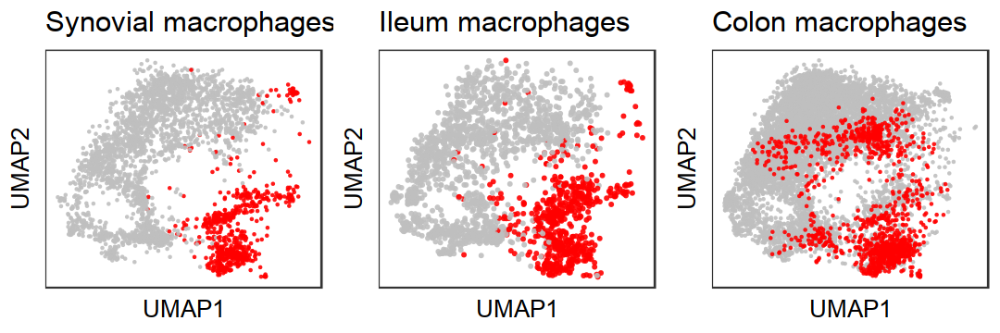

In [68]:
options(repr.plot.height = 3, repr.plot.width = 9)

meta_all$highligh_UC <- rep("macrophages", nrow(meta_all))
meta_all[which(meta_all$cell_type == "Inflammatory Monocytes" & meta_all$dataset == "IBD"),]$highligh_UC <- "Inflammatory macrophages"
meta_temp <- meta_all[which(meta_all$dataset == "IBD"),]
p1 <- ggplot(meta_temp[rev(order(meta_temp$highligh_UC)),],
       aes(x = harmonized_new_UMAP1, y = harmonized_new_UMAP2, fill= highligh_UC)
      ) +
  geom_point(size = 1, stroke = 0.0001, shape = 21, alpha = 0.9) +
  scale_fill_manual(values = c("red", "grey"), name = "") +
  labs(
      x = "UMAP1",
      y = "UMAP2",
      title = "Colon macrophages"
      ) +
  theme_bw(base_size = 15) +
  theme(
    legend.position = "none",
    axis.text = element_blank(),
    axis.ticks = element_blank(),
    panel.grid = element_blank(),
    plot.title = element_text(color="black", size=18)
)

# meta_all$highligh_RA <- rep("macrophages", nrow(meta_all))
# meta_all[which(meta_all$harmonized_new_UMAP1 > -1.2 & meta_all$cell_type == "SC-M1" & meta_all$dataset == "AMP RA"),]$highligh_RA <- "Inflammatory monocytes"
# meta_temp <- meta_all[which(meta_all$dataset == "AMP RA"),]
# p2 <- ggplot(meta_temp[sample(nrow(meta_temp)),],
#        aes(x = harmonized_new_UMAP1, y = harmonized_new_UMAP2, fill= highligh_RA)
#       ) +
#   geom_point(size = 1.5, stroke = 0.0001, shape = 21, alpha = 0.9) +
#   scale_fill_manual(values = c("red", "grey"), name = "") +
#   labs(
#       x = "UMAP1",
#       y = "UMAP2",
#       title = "RA macrophages"
#       ) +
#   theme_bw(base_size = 15) +
#   theme(
#     legend.position = "none",
# #     axis.text = element_blank(),
# #     axis.ticks = element_blank(),
#     panel.grid = element_blank(),
#     plot.title = element_text(color="black", size=20)
# )

# Put AMP and Rahul together
meta_all$highligh_RA <- rep("macrophages", nrow(meta_all))
meta_all[which(meta_all$res_0.20_annot %in% c("IL1B+ CXCL10+", "FCN1+") & meta_all$disease_new == "RA"),]$highligh_RA <- "Inflammatory monocytes"
meta_temp <- meta_all[which(meta_all$disease_new == "RA"),]
p2 <- ggplot(meta_temp[sample(nrow(meta_temp)),],
       aes(x = harmonized_new_UMAP1, y = harmonized_new_UMAP2, fill= highligh_RA)
      ) +
  geom_point(size = 1, stroke = 0.0001, shape = 21, alpha = 0.9) +
#   ylim(-5.5, 6) +
  scale_fill_manual(values = c("red", "grey"), name = "") +
  labs(
      x = "UMAP1",
      y = "UMAP2",
      title = "Synovial macrophages"
      ) +
  theme_bw(base_size = 15) +
  theme(
    legend.position = "none",
    axis.text = element_blank(),
    axis.ticks = element_blank(),
    panel.grid = element_blank(),
    plot.title = element_text(color="black", size=18)
)



meta_all$highligh_CD <- rep("macrophages", nrow(meta_all))
meta_all[which(meta_all$res_0.20_annot %in% c("IL1B+ CXCL10+", "FCN1+") & meta_all$dataset == "Martin"),]$highligh_CD <- "Inflammatory monocytes"
meta_temp <- meta_all[which(meta_all$dataset == "Martin"),]
p3 <- ggplot(meta_temp[sample(nrow(meta_temp)),],
       aes(x = harmonized_new_UMAP1, y = harmonized_new_UMAP2, fill= highligh_CD)
      ) +
  geom_point(size = 1.4, stroke = 0.0001, shape = 21, alpha = 0.9) +
#   ylim(-5,6) +
  scale_fill_manual(values = c("red", "grey"), name = "") +
  labs(
      x = "UMAP1",
      y = "UMAP2",
      title = "Ileum macrophages"
      ) +
  theme_bw(base_size = 15) +
  theme(
    legend.position = "none",
    axis.text = element_blank(),
    axis.ticks = element_blank(),
    panel.grid = element_blank(),
    plot.title = element_text(color="black", size=18)
)

all <- grid.arrange(p2, p3, p1, ncol = 3)
ggsave(file = paste("old_inflammatory_mono_lables", ".png", sep = ""), all, width = 9, height = 3, dpi = 300)
dev.off()

In [63]:
table(meta_all$dataset, meta_all$res_0.20_annot)

          
           FCN1+ IL1B+ CXCL10+ Macropahges MRC1+ FABP4+ RGS1+
  AMP RA      53            75          83          384     1
  AMP SLE     75            52          54          101    55
  COVID-19  4076         11062        5959        26641    28
  IBD       1109           615        1255         6236     3
  Lung      1246          1042        1376         7820    15
  Martin     249           371         510         1091     0
  Rahul      274           236         549         1779     0

In [56]:
# BuildSNNSeurat
library(parallel)
snn_pcs <- BuildSNNSeurat(harmony_weighted4, nn.eps = .5)
dim(snn_pcs)
snn_pcs[1:4,1:4]

[1] 74475 74475

4 x 4 sparse Matrix of class "dgCMatrix"
              S006_L1Q1_G01 S006_L1Q1_G03 S006_L1Q1_G05 S006_L1Q1_G07
S006_L1Q1_G01             1     .                     .     .        
S006_L1Q1_G03             .     1.0000000             .     0.1764706
S006_L1Q1_G05             .     .                     1     .        
S006_L1Q1_G07             .     0.1764706             .     1.0000000

In [57]:
# for weighted clustering, weigh the SNN before passing it to Louvain: 
snn_pcs <- snn_pcs %*% Matrix::Diagonal(x = weights) 
dim(snn_pcs)
snn_pcs[1:4,1:4]

[1] 74475 74475

4 x 4 sparse Matrix of class "dgCMatrix"
              S006_L1Q1_G01 S006_L1Q1_G03 S006_L1Q1_G05 S006_L1Q1_G07
S006_L1Q1_G01      17.85115      .              .            .       
S006_L1Q1_G03       .           17.851151       .            3.150203
S006_L1Q1_G05       .            .             17.85115      .       
S006_L1Q1_G07       .            3.150203       .           17.851151

In [58]:
# Louvain
resolution_list <- c(0.2, 0.4, 0.6)
ids_cos <- Reduce(cbind, mclapply(resolution_list, function(res_use) {
    Seurat:::RunModularityClustering(SNN = snn_pcs, modularity = 1, 
        resolution = res_use, algorithm = 3, n.start = 10, 
        n.iter = 10, random.seed = 0, print.output = FALSE, 
        temp.file.location = NULL, edge.file.name = NULL)    
}, mc.cores = min(16, length(resolution_list))))
ids_cos %<>% data.frame()
colnames(ids_cos) <- sprintf("res_%.2f", resolution_list)

meta_all$res_0.20 <- ids_cos$res_0.20
meta_all$res_0.40 <- ids_cos$res_0.40
meta_all$res_0.60 <- ids_cos$res_0.60

meta_all[1:4,]
# saveRDS(meta_all, "meta_all_weighted_macropahge_cosine_s_d_ds_new_cluster_2020_06_09.rds")

cell,dataset,technology,sample,disease,cell_type,nUMI,nGene,percent_mito,percent.ribo,...,harmonized_new_PC18,harmonized_new_PC19,harmonized_new_PC20,harmonized_new_UMAP1,harmonized_new_UMAP2,harmonized_new2_UMAP1,harmonized_new2_UMAP2,res_0.20,res_0.40,res_0.60
S006_L1Q1_G01,AMP RA,Celseq,301-0159,OA,SC-M3,1678,878,0,0.01430274,...,0.07740935,0.8416386,0.04964062,-1.9311257,0.2153628,-2.518698,1.025954,0,1,1
S006_L1Q1_G03,AMP RA,Celseq,301-0159,OA,SC-M2,8439,2608,0,0.01860410,...,0.71228639,-2.2873844,-5.64913735,-0.6626992,2.5323367,-1.741722,3.764394,0,8,9
S006_L1Q1_G05,AMP RA,Celseq,301-0159,OA,SC-M2,5769,2343,0,0.01092044,...,-0.34302764,-6.0605748,-0.53765841,-0.2915412,3.2072371,-1.379475,4.717002,0,8,9
S006_L1Q1_G07,AMP RA,Celseq,301-0159,OA,SC-M2,5354,2031,0,0.02241315,...,-0.39407403,1.2890874,-4.79605934,-0.9450107,2.2334536,-2.384813,2.122873,0,8,9


In [73]:
# meta_all$disease_new[which(meta_all$disease_new == "Severe BALF")] <- "Severe COVID-19"
# meta_all$disease_new[which(meta_all$disease_new == "Mild BALF")] <- "Mild COVID-19"
# saveRDS(meta_all, "meta_all_weighted_macropahge_cosine_s_d_ds_new_cluster_2020_06_09.rds")

In [647]:
meta_temp <- meta_all[-which(meta_all$res_0.20_annot == "RGS1+"),]
table(meta_temp$res_0.20_annot, meta_temp$disease_new)

nrow(as.data.frame(table(meta_temp$sample))) # Number of samples


mono_save <- meta_temp %>% 
  group_by(res_0.20_annot, disease_new, dataset) %>%
  summarise(number = n())
dim(mono_save)

write.table(mono_save, file = paste("supp_table2_mono_integration_basic", ".txt", sep = ""),
             row.names=T,col.names=T, quote = F, sep = "\t")

              
               Healthy BALF Mild COVID-19 Severe COVID-19 Polymyositis lung
  CXCL10+              1109          1252            8701               342
  FCN1+                1173            47            2856               222
  Macropahges+         1815           144            4000               536
  MRC1+ FABP4+        13781          2154           10706              2272
              
               SS lung HP lung Healthy colon Non-inflamed UC Inflamed UC
  CXCL10+          504     196            85             179         351
  FCN1+            707     317            52             372         685
  Macropahges+     661     179           176             542         537
  MRC1+ FABP4+    4832     716          1622            2278        2336
              
               Non-inflamed Crohn Inflamed Crohn    OA    RA Healthy kidney
  CXCL10+                      92            279    13   298              4
  FCN1+                       105            144     1   3

[1] 108

[1] 63  4

In [98]:
meta_all <- readRDS("meta_all_weighted_macropahge_cosine_s_d_ds_new_cluster_2020_06_09.rds")
meta_all$disease_new <- as.character(meta_all$disease_new)
meta_all$disease_new[which(meta_all$disease_new == "Hypersensitivity pneumonitis")] <- "HP lung"

In [123]:
# saveRDS(meta_all, "meta_all_weighted_macropahge_cosine_s_d_ds_new_cluster_2020_06_09.rds")

## Read results

In [38]:
meta_all <- readRDS("meta_all_weighted_macropahge_cosine_s_d_ds_new_cluster_2020_06_09.rds")
exprs_norm <- readRDS("exprs_norm_macropahge_new_2020_06_04.rds")
all(meta_all$cell == colnames(exprs_norm))
table(meta_all$res_0.20_annot)
table(meta_all$disease_new)
colnames(meta_all)

[1] TRUE


     CXCL10+        FCN1+ MRC1+ FABP4+       NAMPT+         RGS1 
       13453         7082        44052         9786          102 


                Healthy BALF                Mild COVID-19 
                       17880                         3597 
             Severe COVID-19            Polymyositis lung 
                       26289                         3379 
                     SS lung Hypersensitivity pneumonitis 
                        6706                         1414 
               Healthy colon              Non-inflamed UC 
                        1936                         3373 
                 Inflamed UC           Non-inflamed Crohn 
                        3909                          938 
              Inflamed Crohn                           OA 
                        1283                          130 
                          RA               Healthy kidney 
                        3304                           48 
                         SLE 
                         289 

[1] "cell"                  "dataset"               "technology"           
  [4] "sample"                "disease"               "cell_type"            
  [7] "nUMI"                  "nGene"                 "percent_mito"         
 [10] "percent.ribo"          "harmonized_s_PC1"      "harmonized_s_PC2"     
 [13] "harmonized_s_PC3"      "harmonized_s_PC4"      "harmonized_s_PC5"     
 [16] "harmonized_s_PC6"      "harmonized_s_PC7"      "harmonized_s_PC8"     
 [19] "harmonized_s_PC9"      "harmonized_s_PC10"     "harmonized_s_PC11"    
 [22] "harmonized_s_PC12"     "harmonized_s_PC13"     "harmonized_s_PC14"    
 [25] "harmonized_s_PC15"     "harmonized_s_PC16"     "harmonized_s_PC17"    
 [28] "harmonized_s_PC18"     "harmonized_s_PC19"     "harmonized_s_PC20"    
 [31] "harmonized_d_PC1"      "harmonized_d_PC2"      "harmonized_d_PC3"     
 [34] "harmonized_d_PC4"      "harmonized_d_PC5"      "harmonized_d_PC6"     
 [37] "harmonized_d_PC7"      "harmonized_d_PC8"      "harmonized_d_PC9"     
 [40] "harmonized_d_PC10"     "harmonized_d_PC11"     "harmonized_d_PC12"    
 [43] "harmonized_d_PC13"     "harmonized_d_PC14"     "harmonized_d_PC15"    
 [46] "harmonized_d_PC16"     "harmonized_d_PC17"     "harmonized_d_PC18"    
 [49] "harmonized_d_PC19"     "harmonized_d_PC20"     "harmonized_ds_PC1"    
 [52] "harmonized_ds_PC2"     "harmonized_ds_PC3"     "harmonized_ds_PC4"    
 [55] "harmonized_ds_PC5"     "harmonized_ds_PC6"     "harmonized_ds_PC7"    
 [58] "harmonized_ds_PC8"     "harmonized_ds_PC9"     "harmonized_ds_PC10"   
 [61] "harmonized_ds_PC11"    "harmonized_ds_PC12"    "harmonized_ds_PC13"   
 [64] "harmonized_ds_PC14"    "harmonized_ds_PC15"    "harmonized_ds_PC16"   
 [67] "harmonized_ds_PC17"    "harmonized_ds_PC18"    "harmonized_ds_PC19"   
 [70] "harmonized_ds_PC20"    "harmonized_s_UMAP1"    "harmonized_s_UMAP2"   
 [73] "harmonized_d_UMAP1"    "harmonized_d_UMAP2"    "harmonized_ds_UMAP1"  
 [76] "harmonized_ds_UMAP2"   "disease_new"           "s_d"                  
 [79] "harmonized_new_PC1"    "harmonized_new_PC2"    "harmonized_new_PC3"   
 [82] "harmonized_new_PC4"    "harmonized_new_PC5"    "harmonized_new_PC6"   
 [85] "harmonized_new_PC7"    "harmonized_new_PC8"    "harmonized_new_PC9"   
 [88] "harmonized_new_PC10"   "harmonized_new_PC11"   "harmonized_new_PC12"  
 [91] "harmonized_new_PC13"   "harmonized_new_PC14"   "harmonized_new_PC15"  
 [94] "harmonized_new_PC16"   "harmonized_new_PC17"   "harmonized_new_PC18"  
 [97] "harmonized_new_PC19"   "harmonized_new_PC20"   "harmonized_new_UMAP1" 
[100] "harmonized_new_UMAP2"  "harmonized_new2_UMAP1" "harmonized_new2_UMAP2"
[103] "res_0.20"              "res_0.40"              "res_0.60"             
[106] "gene"                  "res_0.20_annot"

In [37]:
meta_all$res_0.20_annot <- as.character(meta_all$res_0.20)
meta_all$res_0.20_annot[which(meta_all$res_0.20_annot == 4)] <- 0
meta_all$res_0.20_annot[which(meta_all$res_0.20_annot == 5)] <- 4
meta_all$res_0.20_annot[which(meta_all$res_0.20_annot == 3)] <- 7
meta_all$res_0.20_annot[which(meta_all$res_0.20_annot == 2)] <- 3
meta_all$res_0.20_annot[which(meta_all$res_0.20_annot == 7)] <- 2
meta_all$res_0.20_annot[which(meta_all$res_0.20_annot == 0)] <- "MRC1+ FABP4+"
meta_all$res_0.20_annot[which(meta_all$res_0.20_annot == 1)] <- "IL1B+ CXCL10+"
meta_all$res_0.20_annot[which(meta_all$res_0.20_annot == 2)] <- "FCN1+" 
meta_all$res_0.20_annot[which(meta_all$res_0.20_annot == 3)] <- "Macropahges"
meta_all$res_0.20_annot[which(meta_all$res_0.20_annot == 4)] <- "RGS1+"
table(meta_all$disease_new)

cluster_center <- meta_all[-which(meta_all$res_0.20_annot == "RGS1+"),] %>%
                  group_by(res_0.20_annot) %>%
                  summarise_at(vars(harmonized_new_UMAP1, harmonized_new_UMAP2), funs(median(., na.rm=TRUE)))
cluster_center <- as.data.frame(cluster_center)
cluster_center$res_0.20_annot <- as.character(cluster_center$res_0.20_annot)

options(repr.plot.height = 3.5, repr.plot.width = 4)
ggplot(meta_all[-which(meta_all$res_0.20_annot == "RGS1+"),],
#        meta_all[sample(nrow(meta_all)),],
       aes(x = harmonized_new_UMAP1, y = harmonized_new_UMAP2, fill= res_0.20_annot)
      ) +
  geom_point(size = 0.6, stroke = 0.0001, shape = 21, alpha = 0.9) +
  geom_label_repel(
    data = cluster_center,
    aes(label = res_0.20_annot, fill = res_0.20_annot),
#     fontface = 'bold', 
    size = 4.5, 
    box.padding = unit(0.4, "lines"),
    point.padding = unit(0.2, "lines"),
    segment.color = 'grey50'
  ) +
  scale_fill_manual(values = c( "#FFFF33",  "#FF7F00", "#B3B3B3", "#E5C494"), name = "") +
  labs(
      x = "UMAP1",
      y = "UMAP2"
      ) +
  theme_bw(base_size = 15) +
  theme(
    legend.position = "none",
#     axis.text = element_blank(),
#     axis.ticks = element_blank(),
    panel.grid = element_blank(),
    plot.title = element_text(color="black", size=15, face = "italic")
)
ggsave(file = paste("new_mono_cluster", ".png", sep = ""), width = 4, height = 3.5, dpi = 300)
dev.off()


                Healthy BALF                Mild COVID-19 
                       17880                         3597 
             Severe COVID-19            Polymyositis lung 
                       26289                         3379 
                     SS lung Hypersensitivity pneumonitis 
                        6706                         1414 
               Healthy colon              Non-inflamed UC 
                        1936                         3373 
                 Inflamed UC           Non-inflamed Crohn 
                        3909                          938 
              Inflamed Crohn                           OA 
                        1283                          130 
                          RA               Healthy kidney 
                        3304                           48 
                         SLE 
                         289 

null device 
          1

ERROR: Error in file(con, "rb"): cannot open the connection


plot without title


                Healthy BALF                Mild COVID-19 
                       17880                         3597 
             Severe COVID-19            Polymyositis lung 
                       26289                         3379 
                     SS lung Hypersensitivity pneumonitis 
                        6706                         1414 
               Healthy colon              Non-inflamed UC 
                        1936                         3373 
                 Inflamed UC           Non-inflamed Crohn 
                        3909                          938 
              Inflamed Crohn                           OA 
                        1283                          130 
                          RA               Healthy kidney 
                        3304                           48 
                         SLE 
                         289 

null device 
          1

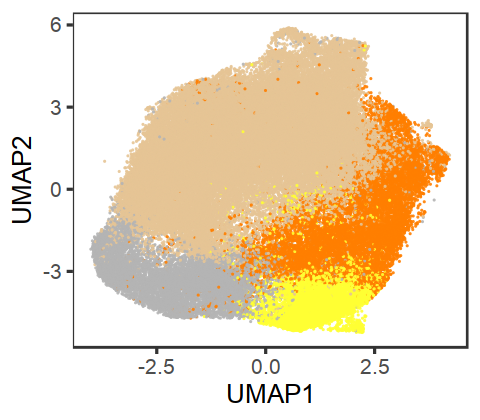

In [6]:
meta_all$res_0.20_annot <- as.character(meta_all$res_0.20)
meta_all$res_0.20_annot[which(meta_all$res_0.20_annot == 4)] <- 0
meta_all$res_0.20_annot[which(meta_all$res_0.20_annot == 5)] <- 4
meta_all$res_0.20_annot[which(meta_all$res_0.20_annot == 3)] <- 7
meta_all$res_0.20_annot[which(meta_all$res_0.20_annot == 2)] <- 3
meta_all$res_0.20_annot[which(meta_all$res_0.20_annot == 7)] <- 2
meta_all$res_0.20_annot[which(meta_all$res_0.20_annot == 0)] <- "MRC1+ FABP4+"
meta_all$res_0.20_annot[which(meta_all$res_0.20_annot == 1)] <- "IL1B+ CXCL10+"
meta_all$res_0.20_annot[which(meta_all$res_0.20_annot == 2)] <- "FCN1+" 
meta_all$res_0.20_annot[which(meta_all$res_0.20_annot == 3)] <- "Macropahges"
meta_all$res_0.20_annot[which(meta_all$res_0.20_annot == 4)] <- "RGS1+"
table(meta_all$disease_new)

cluster_center <- meta_all[-which(meta_all$res_0.20_annot == "RGS1+"),] %>%
                  group_by(res_0.20_annot) %>%
                  summarise_at(vars(harmonized_new_UMAP1, harmonized_new_UMAP2), funs(median(., na.rm=TRUE)))
cluster_center <- as.data.frame(cluster_center)
cluster_center$res_0.20_annot <- as.character(cluster_center$res_0.20_annot)

options(repr.plot.height = 3.5, repr.plot.width = 4)
ggplot(meta_all[-which(meta_all$res_0.20_annot == "RGS1+"),],
#        meta_all[sample(nrow(meta_all)),],
       aes(x = harmonized_new_UMAP1, y = harmonized_new_UMAP2, fill= res_0.20_annot)
      ) +
  geom_point(size = 0.6, stroke = 0.0001, shape = 21, alpha = 0.9) +
#   geom_label_repel(
#     data = cluster_center,
#     aes(label = res_0.20_annot, fill = res_0.20_annot),
# #     fontface = 'bold', 
#     size = 4.5, 
#     box.padding = unit(0.4, "lines"),
#     point.padding = unit(0.2, "lines"),
#     segment.color = 'grey50'
#   ) +
  scale_fill_manual(values = c( "#FFFF33",  "#FF7F00", "#B3B3B3", "#E5C494"), name = "") +
  labs(
      x = "UMAP1",
      y = "UMAP2"
      ) +
  theme_bw(base_size = 15) +
  theme(
    legend.position = "none",
#     axis.text = element_blank(),
#     axis.ticks = element_blank(),
    panel.grid = element_blank(),
    plot.title = element_text(color="black", size=15, face = "italic")
)
ggsave(file = paste("new_mono_cluster", ".png", sep = ""), width = 4, height = 3.5, dpi = 300)
dev.off()

In [29]:
# Save
dim(meta_all)
dim(exprs_norm)
saveRDS(meta_all, "meta_all_weighted_macropahge_cosine_s_d_ds_new_cluster_2020_12_30.rds")
saveRDS(exprs_norm, "exprs_norm_macropahge_new_2020_12_30.rds")

[1] 74373   107

[1] 17054 74373

In [8]:
'%!in%' <- function(x,y)!('%in%'(x,y))

,disease_new,CXCL10,FCN1,ratio
Non-inflamed UC,Non-inflamed UC,179,372,0.4811828
Healthy kidney,Healthy kidney,4,8,0.5000000
Inflamed UC,Inflamed UC,351,685,0.5124088
HP lung,HP lung,196,317,0.6182965
SS lung,SS lung,504,707,0.7128713
SLE,SLE,48,67,0.7164179
Non-inflamed Crohn,Non-inflamed Crohn,92,105,0.8761905
RA,RA,298,326,0.9141104
Healthy BALF,Healthy BALF,1109,1173,0.9454390
Polymyositis lung,Polymyositis lung,342,222,1.5405405


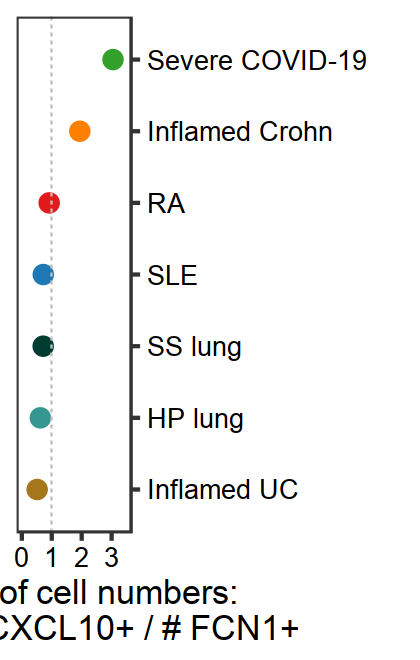

In [114]:
# Ratio of cell number of inflammatory clusters
meta_ratio <- meta_all[which(meta_all$res_0.20_annot %in% c("FCN1+", "IL1B+ CXCL10+")),]
meta_ratio <- table(meta_ratio$disease_new, meta_ratio$res_0.20_annot)
meta_ratio <- as.matrix(meta_ratio)

ratio_plot = data.frame(
    disease_new = rownames(meta_ratio),
    CXCL10  = meta_ratio[,2],
    FCN1  = meta_ratio[,1],
    ratio = meta_ratio[,2]/meta_ratio[,1]
)

ratio_plot[order(ratio_plot$ratio),]

options(repr.plot.height = 5.5, repr.plot.width = 3.5)
ggplot(
      data = ratio_plot[which(ratio_plot$disease_new %in% c("SLE", "Inflamed UC", "HP lung", "SS lung", "RA", "Inflamed Crohn", "Severe COVID-19")),],
      aes(x = ratio, y = reorder(disease_new,ratio), colour = disease_new)
       ) + 
      geom_point(size = 5) +
      scale_color_manual(values = meta_colors$disease, name = "") +
      labs(y = "",
           x="Ratio of cell numbers:\n # IL1B+ CXCL10+ / # FCN1+"
          )+
      xlim(c(0,3.5)) +
      geom_vline(xintercept = 1, linetype="dashed", color = "grey", size=0.5) +
      scale_y_discrete(position = "right") +
      theme_bw(base_size = 20)+
      theme(
        axis.text = element_text(color = "black"),
#         axis.ticks.x = element_blank(),
        panel.grid = element_blank(),
        plot.title = element_text(color="black", size=15),
        legend.position = "none"
      ) 
ggsave(file = paste("ratio_inflammatory_clusters", ".pdf", sep = ""), width = 3.5, height = 5.5, dpi = 200)


In [85]:
sd(ratio_plot$ratio[c(1,2)])

[1] 0.4873213

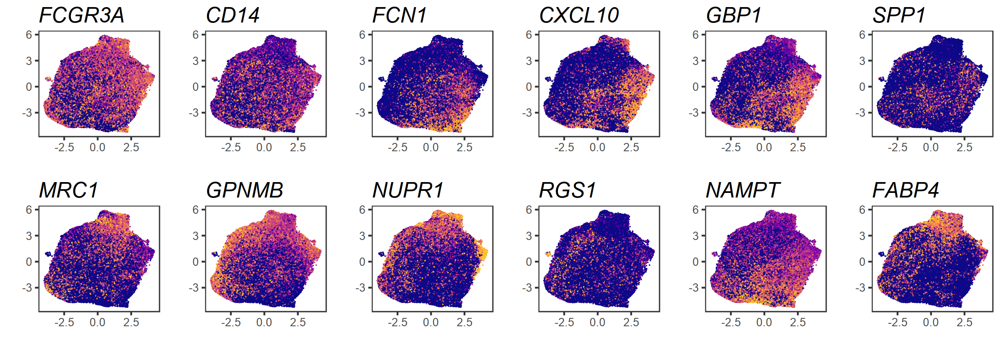

In [114]:
plot_gene <- c("FCGR3A", "CD14", "FCN1", "CXCL10", "GBP1", "SPP1",  "MRC1", "GPNMB", "NUPR1", "RGS1",
              "NAMPT", "FABP4")

myplots <- list()
for (i in 1:length(plot_gene)) {
  gene <- plot_gene[i]
    
    max.cutoff = quantile(exprs_norm[gene,], .99)
    min.cutoff = quantile(exprs_norm[gene,], .01)

    tmp <- sapply(X = exprs_norm[gene,], FUN = function(x) {
        return(ifelse(test = x > max.cutoff, yes = max.cutoff,
            no = x))
    })
    tmp <- sapply(X = tmp, FUN = function(x) {
        return(ifelse(test = x < min.cutoff, yes = min.cutoff,
            no = x))
    })
  
    meta_all$gene <- as.numeric(tmp)
    

    
   ind <- paste("p", i, sep = "")
   ind <- ggplot(
                 data = meta_all[sample(nrow(meta_all)),],
#                  data = meta_all[order(meta_all$gene),] , 
                 aes(x = harmonized_new_UMAP1, y = harmonized_new_UMAP2)) + 
      geom_point(mapping = aes(color = gene), size = 0.0001) + 
#       facet_wrap( . ~ dataset_new, ncol = 7) +
      scale_color_viridis(option = "plasma", end = .9) +
      labs(x="", y="")+
      theme_bw(base_size = 20)+
      theme(
#         axis.text = element_blank(),
#         axis.ticks = element_blank(),
        panel.grid = element_blank(),
        plot.title = element_text(color="black", size=30, face="italic"),
        legend.position = "none") +
      labs(title = gene)
   myplots[[i]] <- ind
}

options(repr.plot.height = 7, repr.plot.width = 20)
p <- do.call("grid.arrange", c(myplots, ncol = 6))
ggsave(file = paste("new_mono_gene_umap", ".png", sep = ""), p, width = 20, height = 7, dpi = 300)

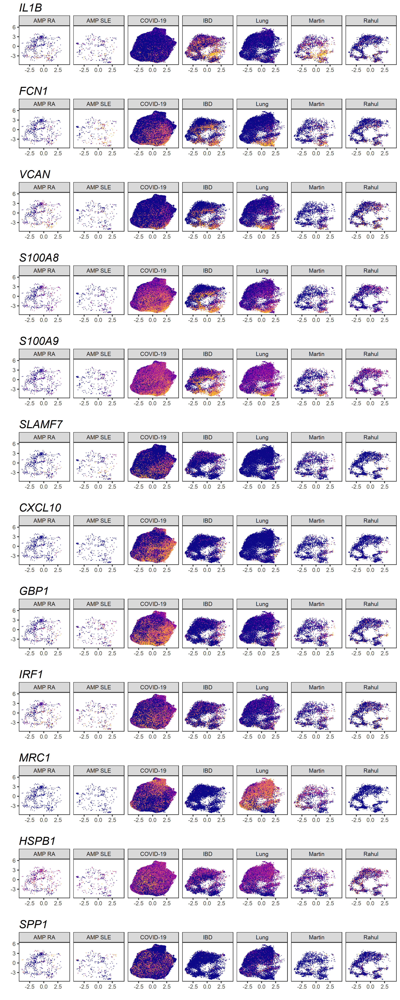

In [64]:
# plot_gene <- c("SPP1", "FCN1", "IL1B", "CXCL9", "CXCL10", "GBP4", "GBP1", "IRF1", "FABP4")
plot_gene <- c("IL1B", "FCN1", "VCAN", "S100A8", "S100A9", "SLAMF7", "CXCL10", "GBP1", "IRF1", "MRC1", "HSPB1", "SPP1")

myplots <- list()
for (i in 1:length(plot_gene)) {
  gene <- plot_gene[i]
    
    max.cutoff = quantile(exprs_norm[gene,], .99)
    min.cutoff = quantile(exprs_norm[gene,], .01)

    tmp <- sapply(X = exprs_norm[gene,], FUN = function(x) {
        return(ifelse(test = x > max.cutoff, yes = max.cutoff,
            no = x))
    })
    tmp <- sapply(X = tmp, FUN = function(x) {
        return(ifelse(test = x < min.cutoff, yes = min.cutoff,
            no = x))
    })
  
    meta_all$gene <- as.numeric(tmp)
    

    
   ind <- paste("p", i, sep = "")
   ind <- ggplot(
                 data = meta_all[sample(nrow(meta_all)),],
#                  data = meta_all[order(meta_all$gene),] , 
                 aes(x = harmonized_new_UMAP1, y = harmonized_new_UMAP2)) + 
      geom_point(mapping = aes(color = gene), size = 0.0001) + 
      facet_wrap( . ~ dataset, ncol = 7) +
      scale_color_viridis(option = "plasma", end = .9) +
      labs(x="", y="")+
      theme_bw(base_size = 25)+
      theme(
#         axis.text = element_blank(),
#         axis.ticks = element_blank(),
        panel.grid = element_blank(),
        plot.title = element_text(color="black", size=40, face="italic"),
        legend.position = "none") +
      labs(title = gene)
   myplots[[i]] <- ind
    
    
}

options(repr.plot.height = 50, repr.plot.width = 20)
p <- do.call("grid.arrange", c(myplots, ncol = 1))

In [8]:
table(meta_all$disease_new)
meta_all$disease_new <- factor(meta_all$disease_new, levels = c( "Severe COVID-19", "Mild COVID-19", "Healthy BALF", 
                                                                       "Polymyositis lung", "SS lung", "HP lung",
                                                                       "Healthy colon", "Non-inflamed UC", "Inflamed UC",
                                                                       "Non-inflamed Crohn", "Inflamed Crohn",
                                                                       "OA", "RA", "Healthy kidney", "SLE")
                                     )


                Healthy BALF                Mild COVID-19 
                       17880                         3597 
             Severe COVID-19            Polymyositis lung 
                       26289                         3379 
                     SS lung Hypersensitivity pneumonitis 
                        6706                         1414 
               Healthy colon              Non-inflamed UC 
                        1936                         3373 
                 Inflamed UC           Non-inflamed Crohn 
                        3909                          938 
              Inflamed Crohn                           OA 
                        1283                          130 
                          RA               Healthy kidney 
                        3304                           48 
                         SLE 
                         289 

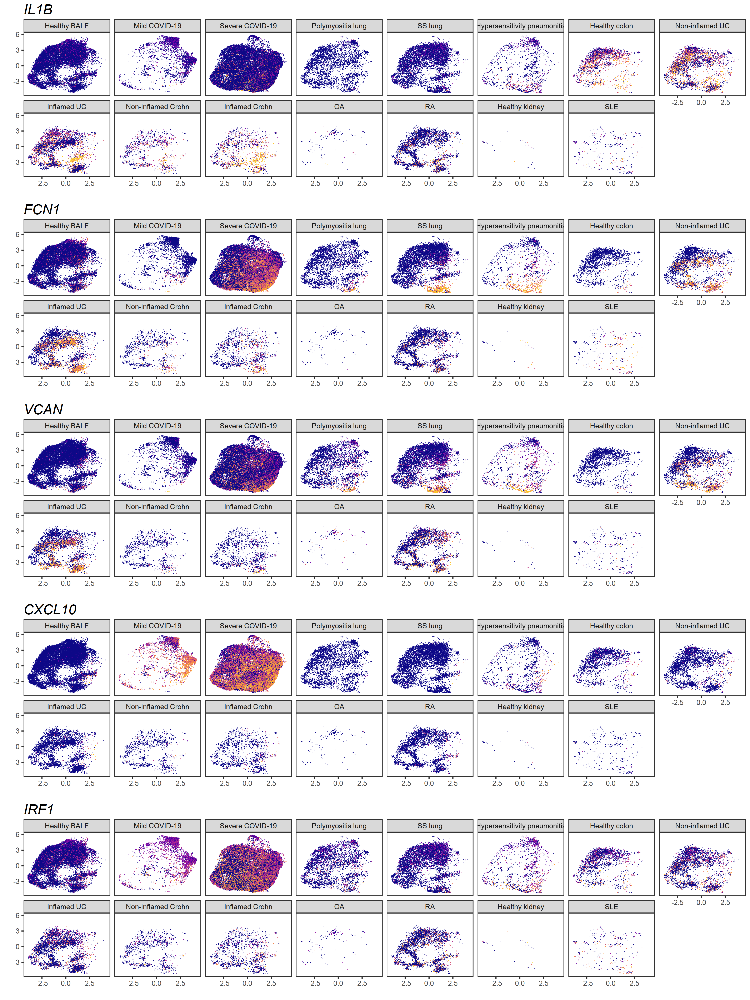

In [81]:
# plot_gene <- c("SPP1", "FCN1", "IL1B", "CXCL9", "CXCL10", "GBP4", "GBP1", "IRF1", "FABP4")
plot_gene <- c("IL1B", "FCN1", "VCAN", "CXCL10", "IRF1")

myplots <- list()
for (i in 1:length(plot_gene)) {
  gene <- plot_gene[i]
    
    max.cutoff = quantile(exprs_norm[gene,], .99)
    min.cutoff = quantile(exprs_norm[gene,], .01)

    tmp <- sapply(X = exprs_norm[gene,], FUN = function(x) {
        return(ifelse(test = x > max.cutoff, yes = max.cutoff,
            no = x))
    })
    tmp <- sapply(X = tmp, FUN = function(x) {
        return(ifelse(test = x < min.cutoff, yes = min.cutoff,
            no = x))
    })
  
    meta_all$gene <- as.numeric(tmp)
    
    
   ind <- paste("p", i, sep = "")
   ind <- ggplot(
                 data = meta_all[sample(nrow(meta_all)),],
#                  data = meta_all[order(meta_all$gene),] , 
                 aes(x = harmonized_new_UMAP1, y = harmonized_new_UMAP2)) + 
      geom_point(mapping = aes(color = gene), size = 0.0001) + 
      facet_wrap( . ~ disease_new, ncol = 8) +
      scale_color_viridis(option = "plasma", end = .9) +
      labs(x="", y="")+
      theme_bw(base_size = 25)+
      theme(
#         axis.text = element_blank(),
#         axis.ticks = element_blank(),
        panel.grid = element_blank(),
        plot.title = element_text(color="black", size=40, face="italic"),
        legend.position = "none") +
      labs(title = gene)
   myplots[[i]] <- ind
}



options(repr.plot.height = 40, repr.plot.width = 30)
p <- do.call("grid.arrange", c(myplots, ncol = 1))

In [9]:
table(meta_all$disease_new)


   Severe COVID-19      Mild COVID-19       Healthy BALF  Polymyositis lung 
             26289               3597              17880               3379 
           SS lung            HP lung      Healthy colon    Non-inflamed UC 
              6706                  0               1936               3373 
       Inflamed UC Non-inflamed Crohn     Inflamed Crohn                 OA 
              3909                938               1283                130 
                RA     Healthy kidney                SLE 
              3304                 48                289 

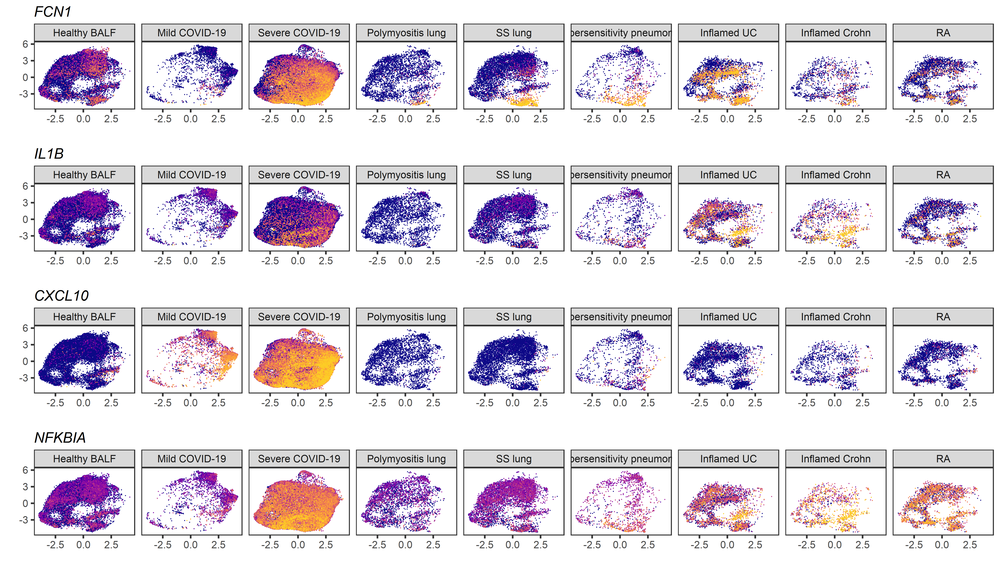

In [35]:
# plot_gene <- c("SPP1", "FCN1", "IL1B", "CXCL9", "CXCL10", "GBP4", "GBP1", "IRF1", "FABP4")
plot_gene <- c("FCN1", "IL1B", "CXCL10", "NFKBIA")

myplots <- list()
for (i in 1:length(plot_gene)) {
  gene <- plot_gene[i]
    
    max.cutoff = quantile(exprs_norm[gene,], .99)
    min.cutoff = quantile(exprs_norm[gene,], .01)

    tmp <- sapply(X = exprs_norm[gene,], FUN = function(x) {
        return(ifelse(test = x > max.cutoff, yes = max.cutoff,
            no = x))
    })
    tmp <- sapply(X = tmp, FUN = function(x) {
        return(ifelse(test = x < min.cutoff, yes = min.cutoff,
            no = x))
    })
  
    meta_all$gene <- as.numeric(tmp)
    
    meta_temp <- meta_all[which(meta_all$disease_new %in% c("Healthy BALF", "Mild COVID-19", "Severe COVID-19",
                                                                       "Polymyositis lung", "SS lung", "Hypersensitivity pneumonitis",
                                                                       "RA", "Inflamed UC",  "Inflamed Crohn"
                                                                      )
                               ),]
    
   ind <- paste("p", i, sep = "")
   ind <- ggplot(
#                  data = meta_temp[sample(nrow(meta_temp)),],
                 data = meta_temp[order(meta_temp$gene),] , 
                 aes(x = harmonized_new_UMAP1, y = harmonized_new_UMAP2)) + 
      geom_point(mapping = aes(color = gene), size = 0.5) + 
      facet_wrap( . ~ disease_new, ncol = 10) +
      scale_color_viridis(option = "plasma", end = .9) +
      labs(x="", y="")+
      theme_bw(base_size = 40)+
      theme(
#         axis.text = element_blank(),
#         axis.ticks = element_blank(),
        panel.grid = element_blank(),
        plot.title = element_text(color="black", size=45, face="italic"),
        legend.position = "none") +
      labs(title = gene)
   myplots[[i]] <- ind
}


options(repr.plot.height = 25, repr.plot.width = 44)
p <- do.call("grid.arrange", c(myplots, ncol = 1))
ggsave(file = paste("gene_per_disease", ".png", sep = ""), p, width = 44, height = 25, dpi = 300)

In [ ]:
temp <- meta_all[which(meta_all$dataset %in% c("COVID-19")),]

options(repr.plot.height = 3.2, repr.plot.width = 3)
ggplot() +
      geom_point(
        data = temp[sample(nrow(temp)),],
        mapping = aes_string(x = "harmonized_new_UMAP1", y = "harmonized_new_UMAP2", fill = "disease_new"),
        size = 0.5, stroke = 0.001, shape = 21
      ) +
      scale_fill_manual(values = meta_colors$disease, name = "") +
      labs(x="UMAP1", y="UMAP2", title = "BALF macrophages")+
      theme_bw(base_size = 15)+
      theme(
        axis.text = element_blank(),
        axis.ticks = element_blank(),
        panel.grid = element_blank(),
        plot.title = element_text(color="black", size=18),
        legend.position = "none"
      )
ggsave(file = paste("covid_1", ".png", sep = ""), width = 3, height = 3.2, dpi = 300)


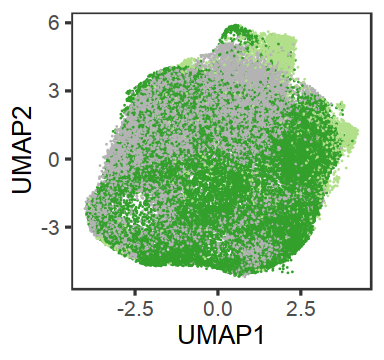

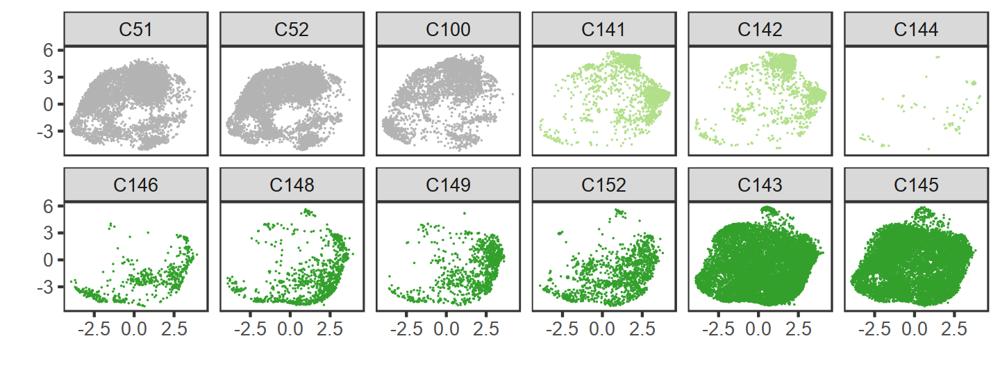

In [135]:
temp <- meta_all[which(meta_all$dataset %in% c("COVID-19")),]

options(repr.plot.height = 3, repr.plot.width = 3.2)
ggplot() +
      geom_point(
        data = temp[sample(nrow(temp)),],
        mapping = aes_string(x = "harmonized_new_UMAP1", y = "harmonized_new_UMAP2", fill = "disease_new"),
        size = 0.5, stroke = 0.001, shape = 21
      ) +
#       xlim(-4, 5) +
      scale_fill_manual(values = meta_colors$disease, name = "") +
      labs(x="UMAP1", y="UMAP2")+
      theme_bw(base_size = 15)+
      theme(
#         axis.text = element_blank(),
#         axis.ticks = element_blank(),
        panel.grid = element_blank(),
        plot.title = element_text(color="black", size=20, face="italic"),
        legend.position = "none"
      )
ggsave(file = paste("covid_1", ".png", sep = ""), width = 3.2, height = 3, dpi = 300)


colors37 = c("#466791","#60bf37","#953ada","#4fbe6c","#ce49d3","#a7b43d","#5a51dc","#d49f36","#552095","#507f2d","#db37aa","#84b67c","#a06fda","#df462a","#5b83db","#c76c2d","#4f49a3","#82702d","#dd6bbb","#334c22","#d83979","#55baad","#dc4555","#62aad3","#8c3025","#417d61","#862977","#bba672","#403367","#da8a6d","#a79cd4","#71482c","#c689d0","#6b2940","#d593a7","#895c8b","#bd5975")
temp$sample <- factor(temp$sample, levels = c("C51", "C52", "C100", "C141", "C142", "C144", "C146", "C148", "C149", "C152", "C143", "C145"))

options(repr.plot.height = 4.5, repr.plot.width = 12)
ggplot() +
      geom_point(
        data = temp,
        mapping = aes_string(x = "harmonized_new_UMAP1", y = "harmonized_new_UMAP2", fill = "disease_new"),
        size = 0.7, stroke = 0.001, shape = 21
      ) +
      facet_wrap( . ~ sample, ncol = 6) +
      scale_fill_manual(values = meta_colors$disease, name = "") +
      labs(x="", y="")+
      theme_bw(base_size = 20)+
      theme(
            legend.position = "none",
#         axis.text = element_blank(),
#         axis.ticks = element_blank(),
        panel.grid = element_blank(),
        plot.title = element_text(color="black", size=30, face="italic")
      )
ggsave(file = paste("covid_2", ".png", sep = ""), width = 12, height = 5, dpi = 300)

In [ ]:
# Map original mono annotations
liao <- read.xls("myeloid.cell.annotation.meta.xls", sheet = 1, header = TRUE)
dim(liao)
liao$cell <- paste0(liao$sample, liao$ID, sep="")
liao$cell <- gsub("\\_", "-", liao$cell) 
liao[1:4,]
table(liao$sample)
liao$cell <- as.character(liao$cell)
table(liao$sample, liao$celltype)

liao <- liao[which(liao$sample == "C148"),]

In [161]:
dim(temp)
table(temp$sample)
temp$cell <- as.character(temp$cell)


temp_temp <- temp[which(temp$sample == "C148"),]
temp_temp$ID <- substring(temp_temp$cell, 5)
temp_temp[1:4,]
length(intersect(liao$ID, temp_temp$ID))


[1] 47766   107


  C51   C52  C100  C141  C142  C144  C146  C148  C149  C152  C143  C145 
 7218  7248  3414  1830  1668    99   562  1130  1041  1330 12151 10075 

cell,dataset,technology,sample,disease,cell_type,nUMI,nGene,percent_mito,percent.ribo,...,harmonized_new_UMAP1,harmonized_new_UMAP2,harmonized_new2_UMAP1,harmonized_new2_UMAP2,res_0.20,res_0.40,res_0.60,gene,res_0.20_annot,ID
C148AAACCTGAGGAATCGC-1,COVID-19,10X,C148,severe,NULL,1233,555,0,0.07299270,...,-2.057610,-4.24139,-2.239692,-5.126996,2,4,5,3.9052360,Macropahges,AAACCTGAGGAATCGC-1
C148AAACCTGTCCAGAAGG-1,COVID-19,10X,C148,severe,NULL,6693,1879,0,0.08486478,...,1.868257,-3.33843,1.980134,-4.710117,3,3,3,0.0000000,FCN1+,AAACCTGTCCAGAAGG-1
C148AAACCTGTCCAGTAGT-1,COVID-19,10X,C148,severe,NULL,4475,1534,0,0.08603352,...,1.922582,-1.37573,2.113118,-1.750791,1,2,2,0.0000000,IL1B+ CXCL10+,AAACCTGTCCAGTAGT-1
C148AAACCTGTCTGGGCCA-1,COVID-19,10X,C148,severe,NULL,29335,4556,0,0.12077723,...,2.929806,2.68573,-1.498409,4.979198,0,5,4,0.5198524,MRC1+ FABP4+,AAACCTGTCTGGGCCA-1


[1] 0

In [80]:
# plot_gene <- c("SPP1", "FCN1", "IL1B", "CXCL9", "CXCL10", "GBP4", "GBP1", "IRF1", "FABP4")
plot_gene <- c("FCN1", "IL1B", "CXCL10", "NFKBIA")

myplots <- list()
for (i in 1:length(plot_gene)) {
  gene <- plot_gene[i]
    
    max.cutoff = quantile(exprs_norm[gene,], .99)
    min.cutoff = quantile(exprs_norm[gene,], .01)

    tmp <- sapply(X = exprs_norm[gene,], FUN = function(x) {
        return(ifelse(test = x > max.cutoff, yes = max.cutoff,
            no = x))
    })
    tmp <- sapply(X = tmp, FUN = function(x) {
        return(ifelse(test = x < min.cutoff, yes = min.cutoff,
            no = x))
    })
  
    meta_all$gene <- as.numeric(tmp)
    
    meta_temp <- meta_all[which(meta_all$disease_new %in% c("Healthy BALF", "Mild COVID-19", "Severe COVID-19",
                                                                       "Polymyositis lung", "SS lung", "Hypersensitivity pneumonitis",
                                                                       "RA", "Inflamed UC",  "Inflamed Crohn"
                                                                      )
                               ),]
    
   ind <- paste("p", i, sep = "")
   ind <- ggplot(
#                  data = meta_temp[sample(nrow(meta_temp)),],
                 data = meta_temp[order(meta_temp$gene),] , 
                 aes(x = harmonized_new_UMAP1, y = harmonized_new_UMAP2)) + 
      geom_point(mapping = aes(color = gene), size = 0.5) + 
      facet_wrap( . ~ disease_new, ncol = 10) +
      scale_color_viridis(option = "plasma", end = .9) +
      labs(x="", y="")+
      theme_bw(base_size = 40)+
      theme(
#         axis.text = element_blank(),
#         axis.ticks = element_blank(),
        panel.grid = element_blank(),
        plot.title = element_text(color="black", size=45, face="italic"),
        legend.position = "none") +
      labs(title = gene)
   myplots[[i]] <- ind
}


options(repr.plot.height = 25, repr.plot.width = 44)
p <- do.call("grid.arrange", c(myplots, ncol = 1))
ggsave(file = paste("gene_per_disease", ".png", sep = ""), p, width = 44, height = 25, dpi = 300)

ERROR: Error in quantile(exprs_norm[gene, ], 0.99): object 'exprs_norm' not found


In [30]:
barcode <- sample(meta_temp$cell, 3000) 
barcode[1:4]

[1] "C52ACGTCAATCCCTCAGT-1"  "C149CTGGTCTCACACCGAC-1" "C152CCTACACGTCAAGCGA-1"
[4] "C143ACCCACTGTGCACCAC-1"

In [40]:
table(meta_all$res_0.20_annot)
meta_all$disease_new <- as.character(meta_all$disease_new)
meta_all$disease_new[which(meta_all$disease_new == "Hypersensitivity pneumonitis")] <- "HP lung"
table(meta_all$disease_new)


        FCN1+ IL1B+ CXCL10+   Macropahges  MRC1+ FABP4+         RGS1+ 
         7082         13453          9786         44052           102 


      Healthy BALF      Healthy colon     Healthy kidney            HP lung 
             17880               1936                 48               1414 
    Inflamed Crohn        Inflamed UC      Mild COVID-19 Non-inflamed Crohn 
              1283               3909               3597                938 
   Non-inflamed UC                 OA  Polymyositis lung                 RA 
              3373                130               3379               3304 
   Severe COVID-19                SLE            SS lung 
             26289                289               6706 

In [115]:
commonTheme = list(labs(color="Density",fill="Density",
                        x="UMAP1",
                        y="UMAP2"),
                  theme_bw(base_size = 35) +
                  theme(
                    legend.position = "none",
#                     axis.text = element_blank(),
#                     axis.ticks = element_blank(),
                    panel.grid = element_blank(),
                    plot.title = element_text(color="black", size=22, face = "italic")
                  ))

In [126]:
table(meta_all$res_0.20_annot)


        FCN1+ IL1B+ CXCL10+   Macropahges  MRC1+ FABP4+         RGS1+ 
         7082         13453          9786         44052           102 

In [18]:
library(plyr)
library(patchwork)

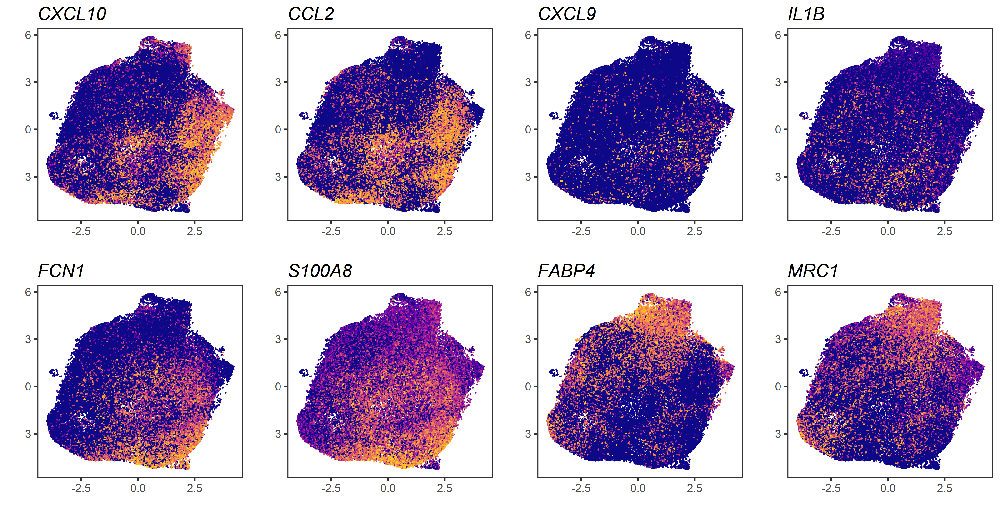

In [128]:
# meta_all$FCN1 <- as.numeric(exprs_norm[which(rownames(exprs_norm) == "FCN1"),])
# options(repr.plot.height = 4, repr.plot.width = 4)
# ggplot(meta_all[which(meta_all$FCN1 > 0),], 
#        aes(harmonized_new_UMAP1, harmonized_new_UMAP2)) +
#     stat_density_2d(aes(fill = stat(level)), geom = "polygon") +
#     scale_fill_viridis_c(option = "plasma")+
#     scale_x_continuous(limits = c(min(meta_all$harmonized_new_UMAP1), max(meta_all$harmonized_new_UMAP1))) +
#     scale_y_continuous(limits = c(min(meta_all$harmonized_new_UMAP2), max(meta_all$harmonized_new_UMAP2))) +
#     commonTheme


plot_gene <- c("CXCL10", "CCL2", "CXCL9", "IL1B", "FCN1", "S100A8", "FABP4", "MRC1")
# plot_gene <- c("FCN1", "CXCL10","GBP1", "STAT1", "IRF1","IL1B", "FABP4", "MRC1", "LILRB5", "SETX")

myplots <- list()
for (i in 1:length(plot_gene)) {
  gene <- plot_gene[i]
    
    max.cutoff = quantile(exprs_norm[gene,], .99)
    min.cutoff = quantile(exprs_norm[gene,], .01)

    tmp <- sapply(X = exprs_norm[gene,], FUN = function(x) {
        return(ifelse(test = x > max.cutoff, yes = max.cutoff,
            no = x))
    })
    tmp <- sapply(X = tmp, FUN = function(x) {
        return(ifelse(test = x < min.cutoff, yes = min.cutoff,
            no = x))
    })
  
    meta_all$gene <- as.numeric(tmp)
#   meta_all$gene <- as.numeric(exprs_norm[gene,])

    
   ind <- paste("p", i, sep = "")
   ind <- ggplot(
                 data = meta_all[sample(nrow(meta_all)),],
#                  data = meta_all[order(meta_all$gene),] , 
                 aes(x = harmonized_new_UMAP1, y = harmonized_new_UMAP2)) + 
      geom_point(mapping = aes(color = gene), size = 1) + 
      scale_color_viridis(option = "plasma", end = .9) +
      labs(x="", y="")+
      theme_bw(base_size = 35)+
      theme(
#         axis.text = element_blank(),
#         axis.ticks = element_blank(),
        panel.grid = element_blank(),
        plot.title = element_text(color="black", size=45, face="italic"),
        legend.position = "none") +
      labs(title = gene)
   myplots[[i]] <- ind
}


options(repr.plot.height = 18, repr.plot.width = 35)
p <- do.call("grid.arrange", c(myplots, ncol = 4))
ggsave(file = paste("mono_new_density_gene", ".pdf", sep = ""), p, width = 35, height = 18, dpi = 300)

In [648]:
library(presto)
mRNA_marker <- wilcoxauc(exprs_norm, meta_all$res_0.20_annot)
saveRDS(mRNA_marker, "mRNA_marker_new_2020_06-14.rds")

In [660]:
x <- mRNA_marker %>%
  group_by(group) %>%
  top_n(70, wt = logFC) 

genes_exclude <- grep("^MT-|^RPL|^RPS|MALAT1|MIR-", x$feature, value = TRUE)

cluster_pseudo_save <- x[-which(x$auc < 0.55),]
cluster_pseudo_save <- cluster_pseudo_save[-which(cluster_pseudo_save$feature %in% genes_exclude),]
min(x$logFC)
min(x$auc)
table(cluster_pseudo_save$group)

write.table(cluster_pseudo_save, file = paste("supp_table_3_pseudo_macro_only_cluster_marker", ".txt", sep = ""),
            row.names=T,col.names=T, quote = F, sep = "\t")

[1] 0.1431344

[1] 0.5137461


     CXCL10+        FCN1+ Macropahges+ MRC1+ FABP4+        RGS1+ 
          70           65           18           40           70 

# Create a gene score using cluster FCN1+ and CXCL10+ marker genes, and sort each patient sample

# Try Kam's pseudo bulk to find good monocyte cluster genes

In [86]:
# Find varible genes
genes_exclude <- grep("^MT-|^RPL|^RPS|MALAT1|MIR-", row.names(exprs_norm), value = TRUE)
all(meta_all$cell == colnames(exprs_norm))

[1] TRUE

In [87]:
vargenes_df <- FindVariableGenesBatch(exprs_norm, meta_all, genes_exclude, 1e3)
nrow(vargenes_df)
table(vargenes_df$N)
var_genes <- vargenes_df$gene
head(var_genes)

[1] 11518


   1    2    3    4    5    6    7    8    9   10   11   12   13   14   15   16 
1613 1026  874  851  838  848  732  662  634  524  421  329  269  223  180  135 
  17   18   19   20   21   22   23   24   25   26   27   28   29   30   31   32 
 132   89   90   71   57   53   54   46   36   29   29   31   32   30   27   32 
  33   34   35   36   37   38   39   40   41   42   43   44   45   46   47   48 
  23   16   13   14   19   19   16    9   12   17    7   15    9    5   11   13 
  49   50   51   52   53   54   55   56   57   58   59   60   61   62   64   65 
   9    7    7    5    9   15    7    8    5    9    4   10    3    4    5    5 
  66   67   68   69   70   71   72   73   74   75   76   77   78   79   80   81 
   6    5    8   11    3    8    4    6    6    3    9    5    1    3    9    9 
  82   83   84   85   86   87   88   89   90   91   92   93   94   95   96   97 
   1    1    3    5    9    5    4    2    4    3    3    2    4    3    7    2 
  98   99  100  101  102  1

[1] "B2M"     "CD74"    "C1QA"    "HLA-DRA" "FTH1"    "LYZ"

In [129]:
# clu <- factor(as.character(meta_all$res_0.20_annot)) # CXCL10+
clu <- factor(as.character(meta_all$res_0.20_new))  # Subcluster: IL1B+ CXCL10+ and CXCL10+
dis <- factor(as.character(meta_all$disease_new))
mm2 <- model.matrix(~ 0 + clu:dis)
dim(mm2)
mm2[1:3,]

mat.sparse <- Matrix(as.matrix(exprs_norm[var_genes,]), sparse = TRUE)
mat.summary.mm2 <- mat.sparse %*% mm2
dim(mat.summary.mm2)
mat.summary.mm2[1:4, 1:4]

[1] 74475    90

cluCXCL10+:disHealthy BALF,cluFCN1+:disHealthy BALF,cluIL1B+ CXCL10+:disHealthy BALF,cluMacropahges:disHealthy BALF,cluMRC1+ FABP4+:disHealthy BALF,cluRGS1+:disHealthy BALF,cluCXCL10+:disHealthy colon,cluFCN1+:disHealthy colon,cluIL1B+ CXCL10+:disHealthy colon,cluMacropahges:disHealthy colon,...,cluIL1B+ CXCL10+:disSLE,cluMacropahges:disSLE,cluMRC1+ FABP4+:disSLE,cluRGS1+:disSLE,cluCXCL10+:disSS lung,cluFCN1+:disSS lung,cluIL1B+ CXCL10+:disSS lung,cluMacropahges:disSS lung,cluMRC1+ FABP4+:disSS lung,cluRGS1+:disSS lung
0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


[1] 11518    90

4 x 4 Matrix of class "dgeMatrix"
        cluCXCL10+:disHealthy BALF cluFCN1+:disHealthy BALF
B2M                       1579.499                 6047.574
CD74                      1399.514                 5426.842
C1QA                      1069.130                 4104.330
HLA-DRA                   1431.047                 5480.594
        cluIL1B+ CXCL10+:disHealthy BALF cluMacropahges:disHealthy BALF
B2M                             4228.211                       9292.156
CD74                            3855.524                       8539.344
C1QA                            2929.938                       6411.828
HLA-DRA                         3886.551                       8654.983

In [130]:
class(mat.summary.mm2)
mat.summary.mm2 <- Matrix(mat.summary.mm2, sparse = TRUE)
class(mat.summary.mm2)

mat.summary.mm2_norm <- mat.summary.mm2 %>% NormalizeDataSeurat()
mat.summary.mm2_norm[1:4,1:4]

[1] "dgeMatrix"
attr(,"package")
[1] "Matrix"

[1] "dgCMatrix"
attr(,"package")
[1] "Matrix"

4 x 4 sparse Matrix of class "dgCMatrix"
        cluCXCL10+:disHealthy BALF cluFCN1+:disHealthy BALF
B2M                       3.184008                 3.427991
CD74                      3.068338                 3.323396
C1QA                      2.813325                 3.055624
HLA-DRA                   3.089593                 3.332898
        cluIL1B+ CXCL10+:disHealthy BALF cluMacropahges:disHealthy BALF
B2M                             3.321733                       3.341930
CD74                            3.232943                       3.260557
C1QA                            2.970800                       2.986668
HLA-DRA                         3.240644                       3.273495

In [132]:
meta_sum = data.frame(
    clus_dis = colnames(mat.summary.mm2_norm),
    cluster = sub("\\:.*", "", colnames(mat.summary.mm2_norm)),
    disease = sub("^[^:]*", "", colnames(mat.summary.mm2_norm))
)
meta_sum[1:4,]
names(table(meta_sum$disease))

clus_dis,cluster,disease
cluCXCL10+:disHealthy BALF,cluCXCL10+,:disHealthy BALF
cluFCN1+:disHealthy BALF,cluFCN1+,:disHealthy BALF
cluIL1B+ CXCL10+:disHealthy BALF,cluIL1B+ CXCL10+,:disHealthy BALF
cluMacropahges:disHealthy BALF,cluMacropahges,:disHealthy BALF


[1] ":disHealthy BALF"                 ":disHealthy colon"               
 [3] ":disHealthy kidney"               ":disHypersensitivity pneumonitis"
 [5] ":disInflamed Crohn"               ":disInflamed UC"                 
 [7] ":disMild COVID-19"                ":disNon-inflamed Crohn"          
 [9] ":disNon-inflamed UC"              ":disOA"                          
[11] ":disPolymyositis lung"            ":disRA"                          
[13] ":disSevere COVID-19"              ":disSLE"                         
[15] ":disSS lung"

In [133]:
meta_sum$tissue <- as.character(meta_sum$disease)
meta_sum$tissue[which(meta_sum$tissue == ":disHealthy BALF")] <- "BALF"
meta_sum$tissue[which(meta_sum$tissue == ":disHealthy colon")] <- "Colon"
meta_sum$tissue[which(meta_sum$tissue == ":disHealthy kidney")] <- "Kidney" 
meta_sum$tissue[which(meta_sum$tissue == ":disHP lung")] <- "Lung"
meta_sum$tissue[which(meta_sum$tissue == ":disInflamed Crohn")] <- "Ileum"
meta_sum$tissue[which(meta_sum$tissue == ":disInflamed UC")] <- "Colon"
meta_sum$tissue[which(meta_sum$tissue == ":disMild COVID-19")] <- "BALF"
meta_sum$tissue[which(meta_sum$tissue == ":disNon-inflamed Crohn")] <- "Ileum"
meta_sum$tissue[which(meta_sum$tissue == ":disNon-inflamed UC")] <- "Colon"
meta_sum$tissue[which(meta_sum$tissue == ":disOA")] <- "Synovium"
meta_sum$tissue[which(meta_sum$tissue == ":disPolymyositis lung")] <- "Lung" 
meta_sum$tissue[which(meta_sum$tissue == ":disRA")] <- "Synovium" 
meta_sum$tissue[which(meta_sum$tissue == ":disSevere COVID-19")] <- "BALF" 
meta_sum$tissue[which(meta_sum$tissue == ":disSLE")] <- "Kidney"
meta_sum$tissue[which(meta_sum$tissue == ":disSS lung")] <- "Lung" 

meta_sum$disease <- gsub(".*:dis", "", meta_sum$disease)
meta_sum$tissue <- gsub(".*:dis", "", meta_sum$tissue)
all(meta_sum$clus_dis == colnames(mat.summary.mm2_norm))

meta_sum[1:4,]
table(meta_sum$tissue)
table(meta_sum$cluster)

[1] TRUE

clus_dis,cluster,disease,tissue
cluCXCL10+:disHealthy BALF,cluCXCL10+,Healthy BALF,BALF
cluFCN1+:disHealthy BALF,cluFCN1+,Healthy BALF,BALF
cluIL1B+ CXCL10+:disHealthy BALF,cluIL1B+ CXCL10+,Healthy BALF,BALF
cluMacropahges:disHealthy BALF,cluMacropahges,Healthy BALF,BALF



                        BALF                        Colon 
                          18                           18 
Hypersensitivity pneumonitis                        Ileum 
                           6                           12 
                      Kidney                         Lung 
                          12                           12 
                    Synovium 
                          12 


      cluCXCL10+         cluFCN1+ cluIL1B+ CXCL10+   cluMacropahges 
              15               15               15               15 
 cluMRC1+ FABP4+         cluRGS1+ 
              15               15 

In [134]:
# Remove batch effect of disease to identify common cell states samples
library(limma)
mat.summary.mm2_rmBatch <- removeBatchEffect(x = mat.summary.mm2_norm, batch = as.character(meta_sum$tissue)) 
mat.summary.mm2_rmBatch[1:4,1:4]

,cluCXCL10+:disHealthy BALF,cluFCN1+:disHealthy BALF,cluIL1B+ CXCL10+:disHealthy BALF,cluMacropahges:disHealthy BALF
B2M,3.098115,3.342098,3.235840,3.256038
CD74,3.007509,3.262567,3.172115,3.199729
C1QA,2.746369,2.988668,2.903844,2.919712
HLA-DRA,3.101092,3.344397,3.252142,3.284994


In [139]:
annotation_col = data.frame(
    clus_dis = colnames(exp_ave_scale),
    cluster = sub("\\:.*", "", colnames(exp_ave_scale)),
    disease = sub("^[^:]*", "", colnames(exp_ave_scale))
)
annotation_col$disease <- gsub(".*:dis", "", annotation_col$disease)
annotation_col$cluster <- gsub(".*clu", "", annotation_col$cluster)
rownames(annotation_col) <- annotation_col$clus_dis

# annotation_col <- annotation_col[, c(1,3)]
annotation_col[1:4,]
exp_ave_scale[1:4,1:4]
table(annotation_col$cluster)

,clus_dis,cluster,disease
cluCXCL10+:disHealthy BALF,cluCXCL10+:disHealthy BALF,CXCL10+,Healthy BALF
cluFCN1+:disHealthy BALF,cluFCN1+:disHealthy BALF,FCN1+,Healthy BALF
cluIL1B+ CXCL10+:disHealthy BALF,cluIL1B+ CXCL10+:disHealthy BALF,IL1B+ CXCL10+,Healthy BALF
cluMacropahges:disHealthy BALF,cluMacropahges:disHealthy BALF,Macropahges,Healthy BALF


,cluCXCL10+:disHealthy BALF,cluFCN1+:disHealthy BALF,cluIL1B+ CXCL10+:disHealthy BALF,cluMacropahges:disHealthy BALF
CCL3,-0.82293071,-1.54677993,-0.2222629,-1.1357487
CCL5,-0.09839478,-0.05590072,0.2454780,-0.1275282
CCL7,-1.68614068,-1.68858099,-1.6706368,-1.6994664
CCL8,-2.00000000,-2.00000000,-2.0000000,-2.0000000



      CXCL10+         FCN1+ IL1B+ CXCL10+   Macropahges  MRC1+ FABP4+ 
           15            15            15            15            15 
        RGS1+ 
           15 

In [94]:
daimain_gene <- c("CCL3", "CCL5", "CCL7", "CCL8", "CCL19", "CCL20",
                "CLCF1", "CSF1", "CSF2", "CSF3", "CXCL1", "CXCL2", "CXCL3", "CXCL5",
                 "CXCL9", "CXCL11","EDN1", "CREM", "IFNG", "IL1A",
                 "IL1B", "IL1RN", "IL6", "IL7", "IL12A", "IL18", "IL23A",
                 "IL27", "INHBA",  "NAMPT", "OSM", "TNF", "TNFSF15",
                  "WNT5A"
                )

daimain_gene %in% rownames(mat.summary.mm2_norm)
length(daimain_gene)

[1] TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE
[16] TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE
[31] TRUE TRUE TRUE TRUE

[1] 34

In [95]:
#   scale_fill_manual(values = c( "#FFFF33",  "#FF7F00", "#377EB8", "#4DAF4A", "#984EA3"), name = "") +

table(meta_all$res_0.20_annot)
meta_colors$cluster <- c(
    "CXCL10+" = "#FFFF33",
    "FCN1+"  = "#FF7F00",
    "MRC1+ FABP4+" = "#377EB8",
    "NAMPT+" = "#4DAF4A",
    "RGS1" = "#984EA3"
)


        FCN1+ IL1B+ CXCL10+   Macropahges  MRC1+ FABP4+         RGS1+ 
         7082         13453          9786         44052           102 

In [145]:
#   scale_fill_manual(values = c( "#FFFF33",  "#FF7F00", "#377EB8", "#4DAF4A", "#984EA3"), name = "") +

table(meta_all$res_0.20_new)
meta_colors$cluster <- c(
    "IL1B+ CXCL10+" = "peru", 
    "CXCL10+" = "lightsalmon",
    "FCN1+"  = "#FF7F00",
    "MRC1+ FABP4+" = "#377EB8",
    "NAMPT+" = "#4DAF4A",
    "RGS1" = "#984EA3"
)


      CXCL10+         FCN1+ IL1B+ CXCL10+   Macropahges  MRC1+ FABP4+ 
         5985          7082          7468          9786         44052 
        RGS1+ 
          102 

In [140]:
exp_ave <- mat.summary.mm2_rmBatch[daimain_gene,]

scale_rows <- function(x) t(scale(t(x)))
exp_ave_scale <- scale_rows(exp_ave) # Z-score
exp_ave_scale[exp_ave_scale > 2] <- 2
exp_ave_scale[exp_ave_scale < -2] <- -2


options(repr.plot.width = 12, repr.plot.height = 6)
x <- pheatmap(
  mat = exp_ave_scale,
  border_color = NA,
#   breaks  = mat_breaks,
#   color  = magma(50),
  show_rownames = TRUE,
  show_colnames = FALSE,
  cluster_rows = TRUE,
  cluster_cols = TRUE,
  cutree_rows = 2,
  cutree_cols = 2,
  annotation_col = annotation_col,
  annotation_colors = meta_colors,
  fontsize = 7.5,
  fontsize_row = 7
#   scale = "none"
)

# save_pheatmap_pdf(x, "heatmap_cluster0_7_per_disease.pdf")

ERROR: Error in convert_annotations(annotation_col, annotation_colors): Factor levels on variable cluster do not match with annotation_colors


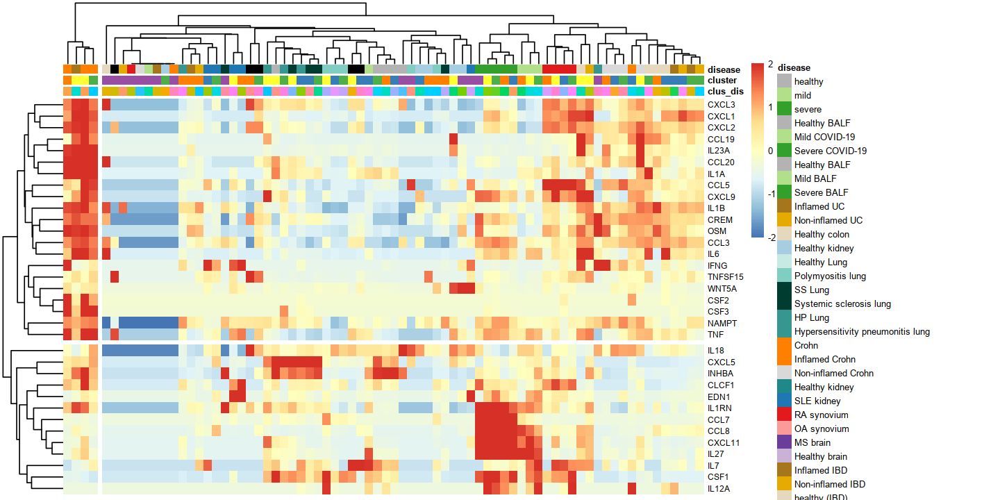

In [337]:
exp_ave <- mat.summary.mm2_norm[daimain_gene,]

scale_rows <- function(x) t(scale(t(x)))
exp_ave_scale <- scale_rows(exp_ave) # Z-score
exp_ave_scale[exp_ave_scale > 2] <- 2
exp_ave_scale[exp_ave_scale < -2] <- -2


options(repr.plot.width = 12, repr.plot.height = 6)
x <- pheatmap(
  mat = exp_ave_scale,
  border_color = NA,
#   breaks  = mat_breaks,
#   color  = magma(50),
  show_rownames = TRUE,
  show_colnames = FALSE,
  cluster_rows = TRUE,
  cluster_cols = TRUE,
  cutree_rows = 2,
  cutree_cols = 2,
  annotation_col = annotation_col,
  annotation_colors = meta_colors,
  fontsize = 7.5,
  fontsize_row = 7
#   scale = "none"
)

# save_pheatmap_pdf(x, "heatmap_cluster0_7_per_disease.pdf")

In [48]:
temp1[which(temp1$group %in% c("clu1")),]$feature
temp1[which(temp1$group %in% c("clu2")),]$feature

[1] "C1QB"   "CCL3"   "CCL4"   "CTSB"   "SOD2"   "CTSL"   "IL1RN"  "CXCL10"
 [9] "GBP1"   "IL7R"

[1] "TIMP1"    "FCN1"     "S100A9"   "S100A8"   "FGL2"     "IFITM2"  
 [7] "VCAN"     "CORO1A"   "CFP"      "APOBEC3A"

In [342]:
table(meta_sum$cluster)
colnames(mat.summary.mm2_rmBatch)


     cluCXCL10+        cluFCN1+ cluMRC1+ FABP4+       cluNAMPT+         cluRGS1 
             15              15              15              15              15 

[1] "cluCXCL10+:disHealthy BALF"           
 [2] "cluFCN1+:disHealthy BALF"             
 [3] "cluMRC1+ FABP4+:disHealthy BALF"      
 [4] "cluNAMPT+:disHealthy BALF"            
 [5] "cluRGS1:disHealthy BALF"              
 [6] "cluCXCL10+:disHealthy colon"          
 [7] "cluFCN1+:disHealthy colon"            
 [8] "cluMRC1+ FABP4+:disHealthy colon"     
 [9] "cluNAMPT+:disHealthy colon"           
[10] "cluRGS1:disHealthy colon"             
[11] "cluCXCL10+:disHealthy kidney"         
[12] "cluFCN1+:disHealthy kidney"           
[13] "cluMRC1+ FABP4+:disHealthy kidney"    
[14] "cluNAMPT+:disHealthy kidney"          
[15] "cluRGS1:disHealthy kidney"            
[16] "cluCXCL10+:disHP lung"                
[17] "cluFCN1+:disHP lung"                  
[18] "cluMRC1+ FABP4+:disHP lung"           
[19] "cluNAMPT+:disHP lung"                 
[20] "cluRGS1:disHP lung"                   
[21] "cluCXCL10+:disInflamed Crohn"         
[22] "cluFCN1+:disInflamed Crohn"           
[23] "cluMRC1+ FABP4+:disInflamed Crohn"    
[24] "cluNAMPT+:disInflamed Crohn"          
[25] "cluRGS1:disInflamed Crohn"            
[26] "cluCXCL10+:disInflamed UC"            
[27] "cluFCN1+:disInflamed UC"              
[28] "cluMRC1+ FABP4+:disInflamed UC"       
[29] "cluNAMPT+:disInflamed UC"             
[30] "cluRGS1:disInflamed UC"               
[31] "cluCXCL10+:disMild COVID-19"          
[32] "cluFCN1+:disMild COVID-19"            
[33] "cluMRC1+ FABP4+:disMild COVID-19"     
[34] "cluNAMPT+:disMild COVID-19"           
[35] "cluRGS1:disMild COVID-19"             
[36] "cluCXCL10+:disNon-inflamed Crohn"     
[37] "cluFCN1+:disNon-inflamed Crohn"       
[38] "cluMRC1+ FABP4+:disNon-inflamed Crohn"
[39] "cluNAMPT+:disNon-inflamed Crohn"      
[40] "cluRGS1:disNon-inflamed Crohn"        
[41] "cluCXCL10+:disNon-inflamed UC"        
[42] "cluFCN1+:disNon-inflamed UC"          
[43] "cluMRC1+ FABP4+:disNon-inflamed UC"   
[44] "cluNAMPT+:disNon-inflamed UC"         
[45] "cluRGS1:disNon-inflamed UC"           
[46] "cluCXCL10+:disOA"                     
[47] "cluFCN1+:disOA"                       
[48] "cluMRC1+ FABP4+:disOA"                
[49] "cluNAMPT+:disOA"                      
[50] "cluRGS1:disOA"                        
[51] "cluCXCL10+:disPolymyositis lung"      
[52] "cluFCN1+:disPolymyositis lung"        
[53] "cluMRC1+ FABP4+:disPolymyositis lung" 
[54] "cluNAMPT+:disPolymyositis lung"       
[55] "cluRGS1:disPolymyositis lung"         
[56] "cluCXCL10+:disRA"                     
[57] "cluFCN1+:disRA"                       
[58] "cluMRC1+ FABP4+:disRA"                
[59] "cluNAMPT+:disRA"                      
[60] "cluRGS1:disRA"                        
[61] "cluCXCL10+:disSevere COVID-19"        
[62] "cluFCN1+:disSevere COVID-19"          
[63] "cluMRC1+ FABP4+:disSevere COVID-19"   
[64] "cluNAMPT+:disSevere COVID-19"         
[65] "cluRGS1:disSevere COVID-19"           
[66] "cluCXCL10+:disSLE"                    
[67] "cluFCN1+:disSLE"                      
[68] "cluMRC1+ FABP4+:disSLE"               
[69] "cluNAMPT+:disSLE"                     
[70] "cluRGS1:disSLE"                       
[71] "cluCXCL10+:disSS lung"                
[72] "cluFCN1+:disSS lung"                  
[73] "cluMRC1+ FABP4+:disSS lung"           
[74] "cluNAMPT+:disSS lung"                 
[75] "cluRGS1:disSS lung"

In [400]:
cluster_pseudo <- wilcoxauc(mat.summary.mm2_rmBatch, meta_sum$cluster)
# cluster_pseudo <- wilcoxauc(mat.summary.mm2_norm, meta_sum$cluster)

temp1 <- cluster_pseudo %>%
  group_by(group) %>%
  top_n(10, wt = auc) 

temp1

feature,group,avgExpr,logFC,statistic,auc,pval,padj,pct_in,pct_out
MIR155HG,cluCXCL10+,0.63302240,0.418010976,808.0,0.8977778,2.174946e-06,0.0054661632,100,100
SDC4,cluCXCL10+,0.77334211,0.443032152,811.0,0.9011111,1.777687e-06,0.0054661632,100,100
TXNRD1,cluCXCL10+,0.90491580,0.373611911,802.0,0.8911111,3.223143e-06,0.0054661632,100,100
DRAM1,cluCXCL10+,1.11201633,0.560783525,807.0,0.8966667,2.332381e-06,0.0054661632,100,100
TNFRSF4,cluCXCL10+,0.38556351,0.298093854,793.5,0.8816667,5.435843e-06,0.0067789738,100,100
NFKBIB,cluCXCL10+,0.57575687,0.261363263,804.0,0.8933333,2.831371e-06,0.0054661632,100,100
HSD3B7,cluCXCL10+,0.62310252,0.306695744,798.0,0.8866667,4.134208e-06,0.0059522261,100,100
METTL1,cluCXCL10+,0.29642703,0.190024134,838.0,0.9311111,2.829520e-07,0.0032590409,100,100
TNIP2,cluCXCL10+,0.77597439,0.364225967,789.0,0.8766667,7.332637e-06,0.0067789738,100,100
PDLIM4,cluCXCL10+,0.14694072,0.095805864,801.0,0.8900000,3.322030e-06,0.0054661632,100,100


[1] "APOC1" "C1QC"  "CCL18" "CSTB"  "FABP4" "FN1"   "GCHFR" "NUPR1" "PPDPF"
[10] "SCD"

[1] 52

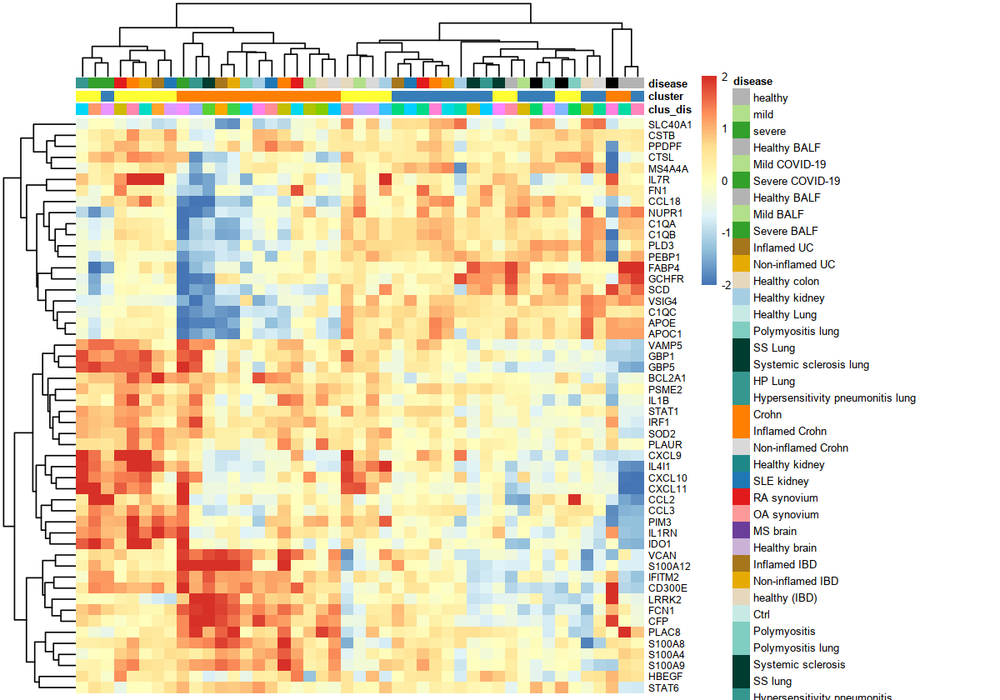

In [419]:
library(presto)
cluster_pseudo <- wilcoxauc(mat.summary.mm2_rmBatch, meta_sum$cluster)
# cluster_pseudo <- wilcoxauc(mat.summary.mm2_norm, meta_sum$cluster)
temp1 <- cluster_pseudo %>%
  group_by(group) %>%
  top_n(10, wt = logFC) 

gene_x <- temp1[which(temp1$group %in% c("cluCXCL10+", "cluFCN1+", "cluMRC1+ FABP4+")),]$feature
gene_z <- c("HBEGF", "PLAUR", "FCN1", "STAT1","STAT6","IRF1","GBP1","IDO1","VAMP5","PSME2","GBP5","LRRK2",
           "CXCL10", "CXCL11", "CCL2", "CCL3", "IL1B", "GBP1")
#            "MRC1", "FABP4", "CD163", "GPNMB", "HSPA6", "HSPA1A", "HSPB1")



mRNA_marker <- readRDS("mRNA_marker_new_2020_06-09.rds")
temp2 <- mRNA_marker %>%
  group_by(group) %>%
  top_n(10, wt = logFC) 
gene_y <- temp2[which(temp2$group == 4),]$feature
gene_y

gene_plot <- Reduce(union, list(gene_x, gene_z, gene_y))
gene_plot <- unique(gene_plot) 
length(gene_plot)


exp_ave <- mat.summary.mm2_rmBatch[gene_plot,]
# exp_ave <- mat.summary.mm2_norm[gene_plot,]
scale_rows <- function(x) t(scale(t(x)))
exp_ave_scale <- scale_rows(exp_ave) # Z-score
exp_ave_scale[exp_ave_scale > 2] <- 2
exp_ave_scale[exp_ave_scale < -2] <- -2
   

# Only plot the two inflammatory clusters
annotation_col_inf <- annotation_col[which(annotation_col$cluster %in% c("CXCL10+", "FCN1+", "MRC1+ FABP4+")),]
exp_ave_scale <- exp_ave_scale[, which(colnames(exp_ave_scale) %in% annotation_col_inf$clus_dis)]


options(repr.plot.width = 10, repr.plot.height = 7)
x <- pheatmap(
  mat = exp_ave_scale,
  border_color = NA,
#   breaks  = mat_breaks,
#   color  = magma(50),
  show_rownames = TRUE,
  show_colnames = FALSE,
  cluster_rows = TRUE,
  cluster_cols = TRUE,
  cutree_rows = 1,
  cutree_cols = 1,
  annotation_col = annotation_col,
  annotation_colors = meta_colors,
  fontsize = 7.5,
  fontsize_row = 7
#   scale = "none"
)
                   
save_pheatmap_pdf <- function(x, filename, width=7, height=5) {
   stopifnot(!missing(x))
   stopifnot(!missing(filename))
   pdf(filename, width=width, height=height)
   grid::grid.newpage()
   grid::grid.draw(x$gtable)
   dev.off()
}

[1] 34

png 
  2

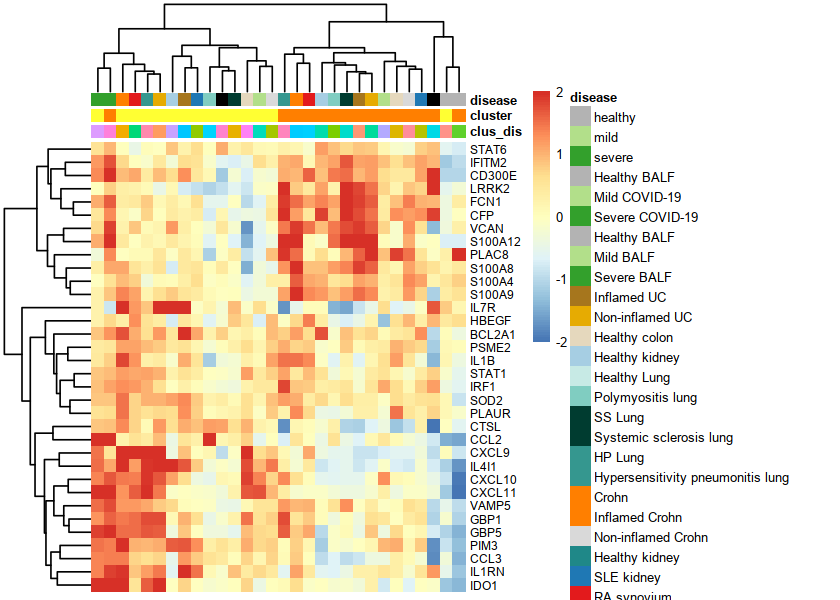

In [393]:
library(presto)
cluster_pseudo <- wilcoxauc(mat.summary.mm2_rmBatch, meta_sum$cluster)
# cluster_pseudo <- wilcoxauc(mat.summary.mm2_norm, meta_sum$cluster)

temp1 <- cluster_pseudo %>%
  group_by(group) %>%
  top_n(10, wt = logFC) 

gene_x <- temp1[which(temp1$group %in% c("cluCXCL10+", "cluFCN1+")),]$feature
gene_z <- c("HBEGF", "PLAUR", "FCN1", "STAT1","STAT6","IRF1","GBP1","IDO1","VAMP5","PSME2","GBP5","LRRK2",
           "CXCL10", "CXCL11", "CCL2", "CCL3", "IL1B", "GBP1")
#            "MRC1", "FABP4", "CD163", "GPNMB", "HSPA6", "HSPA1A", "HSPB1")
gene_plot <- Reduce(union, list(gene_x, gene_z))
# gene_plot <- gene_x
gene_plot <- unique(gene_plot) 
length(gene_plot)


exp_ave <- mat.summary.mm2_rmBatch[gene_plot,]
# exp_ave <- mat.summary.mm2_norm[gene_plot,]
scale_rows <- function(x) t(scale(t(x)))
exp_ave_scale <- scale_rows(exp_ave) # Z-score
exp_ave_scale[exp_ave_scale > 2] <- 2
exp_ave_scale[exp_ave_scale < -2] <- -2
   
# Only plot the two inflammatory clusters
annotation_col_inf <- annotation_col[which(annotation_col$cluster %in% c("CXCL10+", "FCN1+")),]
exp_ave_scale <- exp_ave_scale[, which(colnames(exp_ave_scale) %in% annotation_col_inf$clus_dis)]

options(repr.plot.width = 7, repr.plot.height = 5)
x <- pheatmap(
  mat = exp_ave_scale,
  border_color = NA,
#   breaks  = mat_breaks,
#   color  = magma(50),
  show_rownames = TRUE,
  show_colnames = FALSE,
  cluster_rows = TRUE,
  cluster_cols = TRUE,
  cutree_rows = 1,
  cutree_cols = 1,
  annotation_col = annotation_col,
  annotation_colors = meta_colors,
  fontsize = 7.5,
  fontsize_row = 7
#   scale = "none"
)
                   
save_pheatmap_pdf <- function(x, filename, width=7, height=5) {
   stopifnot(!missing(x))
   stopifnot(!missing(filename))
   pdf(filename, width=width, height=height)
   grid::grid.newpage()
   grid::grid.draw(x$gtable)
   dev.off()
}

save_pheatmap_pdf(x, "new_heatmap_cluster1_2_per_disease.pdf")

In [108]:
cluster_pseudo$group[which(cluster_pseudo$group == "cluIL1B+ CXCL10+")] <- "cluCXCL10+"
table(cluster_pseudo$group)


     cluCXCL10+        cluFCN1+  cluMacropahges cluMRC1+ FABP4+        cluRGS1+ 
          11518           11518           11518           11518           11518 

In [126]:
annotation_col$cluster[which(annotation_col$cluster == "IL1B+ CXCL10+")] <- "CXCL10+"

[1] 23

png 
  2

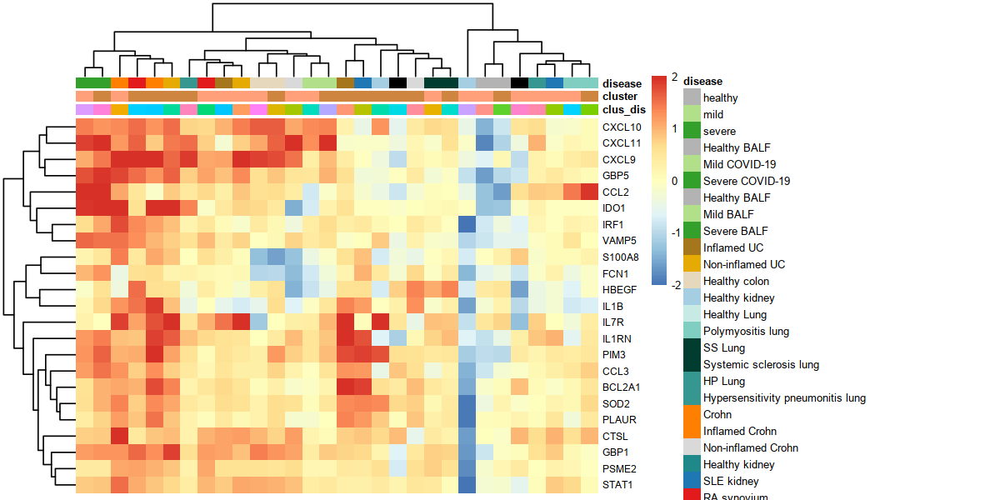

In [156]:
library(presto)
cluster_pseudo <- wilcoxauc(mat.summary.mm2_rmBatch, meta_sum$cluster)
# cluster_pseudo <- wilcoxauc(mat.summary.mm2_norm, meta_sum$cluster)

temp1 <- cluster_pseudo %>%
  group_by(group) %>%
  top_n(7, wt = logFC) 

# gene_x <- temp1[which(temp1$group %in% c("cluCXCL10+", "cluIL1B+ CXCL10+")),]$feature
# gene_z <- c("HBEGF", "PLAUR", "FCN1", "STAT1","STAT6","IRF1","GBP1","IDO1","VAMP5","PSME2","GBP5","LRRK2",
#            "CXCL10", "CXCL11", "CCL2", "CCL3", "IL1B", "GBP1")
# gene_plot <- Reduce(union, list(gene_x, gene_z))

gene_plot <- c("S100A8", "FCN1", "IL7R", "HBEGF", "BCL2A1", "PSME2", "IL1B", "STAT1", 
              "IRF1", "SOD2", "PLAUR", "CTSL", "CCL2", "CXCL9", "CXCL10", "CXCL11", "VAMP5", "GBP1", "GBP5", "PIM3",
              "CCL3", "IL1RN", "IDO1")
gene_plot <- unique(gene_plot) 
length(gene_plot)


exp_ave <- mat.summary.mm2_rmBatch[gene_plot,]
# exp_ave <- mat.summary.mm2_norm[gene_plot,]
scale_rows <- function(x) t(scale(t(x)))
exp_ave_scale <- scale_rows(exp_ave) # Z-score
exp_ave_scale[exp_ave_scale > 2] <- 2
exp_ave_scale[exp_ave_scale < -2] <- -2
   
# Only plot the two inflammatory clusters
annotation_col_inf <- annotation_col[which(annotation_col$cluster %in% c("CXCL10+", "IL1B+ CXCL10+")),]
exp_ave_scale <- exp_ave_scale[, which(colnames(exp_ave_scale) %in% annotation_col_inf$clus_dis)]

options(repr.plot.width = 10, repr.plot.height = 5)
x <- pheatmap(
  mat = exp_ave_scale,
  border_color = NA,
#   breaks  = mat_breaks,
#   color  = magma(50),
  show_rownames = TRUE,
  show_colnames = FALSE,
  cluster_rows = TRUE,
  cluster_cols = TRUE,
  cutree_rows = 1,
  cutree_cols = 1,
  annotation_col = annotation_col,
  annotation_colors = meta_colors,
  fontsize = 7.5,
  fontsize_row = 7
#   scale = "none"
)
                   
save_pheatmap_pdf <- function(x, filename, width=10, height=5) {
   stopifnot(!missing(x))
   stopifnot(!missing(filename))
   pdf(filename, width=width, height=height)
   grid::grid.newpage()
   grid::grid.draw(x$gtable)
   dev.off()
}

save_pheatmap_pdf(x, "new_heatmap_subcluster_CXCL10_per_disease.pdf")

[1] 32

png 
  2

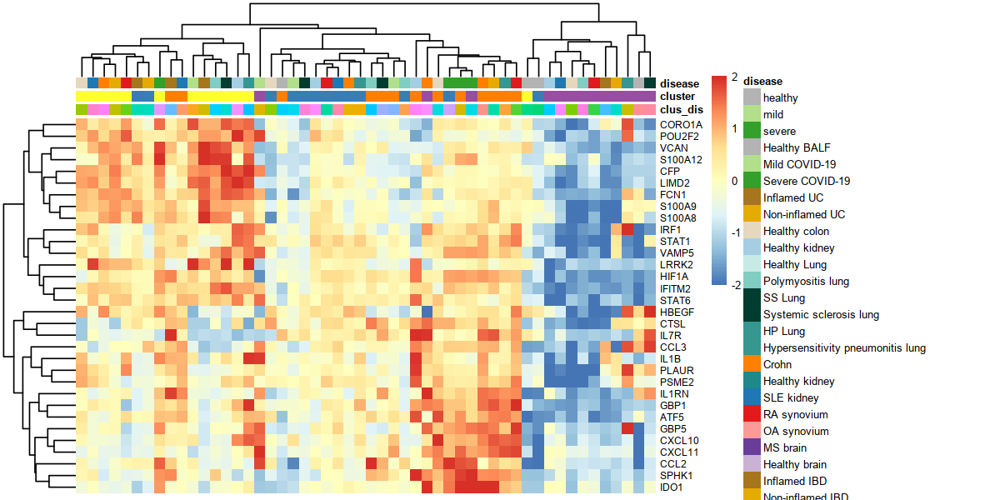

In [938]:
library(presto)
cluster_pseudo <- wilcoxauc(mat.summary.mm2_rmBatch, meta_sum$cluster)
# cluster_pseudo <- wilcoxauc(mat.summary.mm2_norm, meta_sum$cluster)

temp1 <- cluster_pseudo %>%
  group_by(group) %>%
  top_n(10, wt = logFC) 

temp2 <- cluster_pseudo %>%
  group_by(group) %>%
  top_n(5, wt = logFC) 

gene_x <- temp1[which(temp1$group %in% c("clu1", "clu2")),]$feature
# gene_y <- temp2[which(temp2$group %in% c("clu5")),]$feature
gene_z <- c("HBEGF", "PLAUR", "FCN1", "STAT1","STAT6","IRF1","GBP1","IDO1","VAMP5","PSME2","GBP5","LRRK2",
           "CXCL10", "CXCL11", "CCL2", "CCL3", "IL1B", "GBP1")
#            "MRC1", "FABP4", "CD163", "GPNMB", "HSPA6", "HSPA1A", "HSPB1")
gene_plot <- Reduce(union, list(gene_x, gene_z))
# gene_plot <- gene_x
gene_plot <- unique(gene_plot) 
length(gene_plot)


exp_ave <- mat.summary.mm2_rmBatch[gene_plot,]
# exp_ave <- mat.summary.mm2_norm[gene_plot,]
scale_rows <- function(x) t(scale(t(x)))
exp_ave_scale <- scale_rows(exp_ave) # Z-score
exp_ave_scale[exp_ave_scale > 2] <- 2
exp_ave_scale[exp_ave_scale < -2] <- -2
   

options(repr.plot.width = 10, repr.plot.height = 5)
x <- pheatmap(
  mat = exp_ave_scale,
  border_color = NA,
#   breaks  = mat_breaks,
#   color  = magma(50),
  show_rownames = TRUE,
  show_colnames = FALSE,
  cluster_rows = TRUE,
  cluster_cols = TRUE,
  cutree_rows = 1,
  cutree_cols = 1,
  annotation_col = annotation_col,
  annotation_colors = meta_colors,
  fontsize = 7.5,
  fontsize_row = 7
#   scale = "none"
)
                   
save_pheatmap_pdf <- function(x, filename, width=10, height=5) {
   stopifnot(!missing(x))
   stopifnot(!missing(filename))
   pdf(filename, width=width, height=height)
   grid::grid.newpage()
   grid::grid.draw(x$gtable)
   dev.off()
}

save_pheatmap_pdf(x, "heatmap_cluster1_2_per_disease.pdf")

## Generate pseudo-bulk per tissue sample for the two clusters

In [344]:
cluster_pseudo[1:4,]

feature,group,avgExpr,logFC,statistic,auc,pval,padj,pct_in,pct_out
B2M,cluCXCL10+,3.078950,0.2353968,411,0.4566667,0.6100875,0.8679580,100,100
CD74,cluCXCL10+,3.004641,0.2241356,409,0.4544444,0.5916549,0.8616362,100,100
C1QA,cluCXCL10+,2.365127,0.2861049,471,0.5233333,0.7859811,0.9390051,100,100
HLA-DRA,cluCXCL10+,2.935515,0.2344322,442,0.4911111,0.9208678,0.9800014,100,100


In [345]:
x <- cluster_pseudo %>%
  group_by(group) %>%
  top_n(30, wt = logFC) 

cluster0_gene <- x[which(x$group %in% "cluCXCL10+" & x$pct_in > 0.6),]$feature 
cluster7_gene <- x[which(x$group %in% "cluFCN1+" & x$pct_in > 0.6),]$feature 
cluster0_gene
cluster7_gene

[1] "CCL3"    "CCL4"    "SOD2"    "LGALS3"  "CXCL2"   "CXCL3"   "CTSL"   
 [8] "HSPA5"   "BCL2A1"  "IL1RN"   "PLEK"    "CXCL10"  "BIRC3"   "GBP1"   
[15] "MMP19"   "CXCL9"   "TXN"     "ICAM1"   "PLA2G7"  "IL7R"    "IL4I1"  
[22] "ATF5"    "NINJ1"   "NFKB1"   "TPM4"    "PIM3"    "CD40"    "RALA"   
[29] "DRAM1"   "GPR137B"

[1] "S100A6"   "S100A4"   "RGS2"     "TIMP1"    "FCN1"     "S100A9"  
 [7] "IFITM3"   "CD52"     "COTL1"    "S100A8"   "LST1"     "PLAC8"   
[13] "IFITM2"   "VCAN"     "CORO1A"   "CFP"      "AP1S2"    "MNDA"    
[19] "APOBEC3A" "FGR"      "CD48"     "CD300E"   "STXBP2"   "EVI2B"   
[25] "CSTA"     "S100A12"  "LIMD2"    "NUP214"   "GMFG"     "ICAM3"

In [667]:
# x <- cluster_pseudo %>%
#   group_by(group) %>%
#   top_n(30, wt = logFC) 

# cluster0_gene <- x[which(x$group %in% "clu0" & x$pct_in > 0.6),]$feature 
# cluster7_gene <- x[which(x$group %in% "clu7" & x$pct_in > 0.6),]$feature 
# cluster0_gene
# cluster7_gene

[1] "CCL3"     "CCL4"     "NFKBIA"   "SOD2"     "IER3"     "LMNA"    
 [7] "SGK1"     "GPR183"   "CTSL"     "RGCC"     "TNFAIP3"  "CD83"    
[13] "BCL2A1"   "IL1RN"    "PLEK"     "CCL2"     "CXCL10"   "GBP1"    
[19] "CDKN1A"   "IL7R"     "HIF1A"    "SERPINB9" "GK"       "ATP13A3" 
[25] "ATF5"     "NINJ1"    "NFKB1"    "PIM3"     "BAZ1A"    "SPHK1"

[1] "RGS2"     "IL1B"     "SOD2"     "BTG1"     "TIMP1"    "FCN1"    
 [7] "S100A9"   "S100A8"   "FGL2"     "NAMPT"    "EREG"     "IFITM2"  
[13] "VCAN"     "CORO1A"   "CFP"      "SOCS3"    "AP1S2"    "LILRB2"  
[19] "APOBEC3A" "POU2F2"   "CD48"     "CD55"     "CD300E"   "SERPINB9"
[25] "FPR1"     "TNFRSF1B" "S100A12"  "LIMD2"    "PRKCB"    "ICAM3"

In [360]:
cluster0_gene <- c('CCL3','CCL4','NFKBIA','SOD2','IER3','LMNA','SGK1','GPR183','CTSL','RGCC','TNFAIP3',
                   'CD83','BCL2A1','IL1RN','PLEK','CCL2','CXCL10','GBP1','CDKN1A',
                   'IL7R','HIF1A','SERPINB9','GK','ATP13A3','ATF5','NINJ1','NFKB1','PIM3','BAZ1A','SPHK1')


cluster7_gene <- c('RGS2','IL1B','SOD2','BTG1','TIMP1','FCN1','S100A9','S100A8','FGL2','NAMPT','EREG','IFITM2',
                   'VCAN','CORO1A','CFP','SOCS3','AP1S2','LILRB2','APOBEC3A','POU2F2',
                   'CD48','CD55','CD300E','SERPINB9','FPR1','TNFRSF1B','S100A12','LIMD2','PRKCB','ICAM3')

In [355]:
# Need to remove samples with fewer than 20 cells
temp <- table(meta_all$sample)
temp[which(temp < 10)]
rm_sample <- names(temp[which(temp < 10)])
rm_sample


200-0061 200-0108 200-0109 200-0115 200-0124 200-0341 200-0608 200-0609 
       1        2        5        1        4        2        1        4 
200-0610 200-0612 200-0613 200-0615 200-0872 200-1217      N11      N14 
       2        5        8        5        3        4        7        7 
    S123 
       3 

[1] "200-0061" "200-0108" "200-0109" "200-0115" "200-0124" "200-0341"
 [7] "200-0608" "200-0609" "200-0610" "200-0612" "200-0613" "200-0615"
[13] "200-0872" "200-1217" "N11"      "N14"      "S123"

[1] TRUE

sample,cluster0_score,cluster0_lwr,cluster0_upr,disease_new,cluster7_score,cluster7_lwr,cluster7_upr
200-0108,16.33449,15.718151,16.95084,SLE,25.57272,-117.735308,168.88074
200-0109,13.10306,-1.894577,28.10070,SLE,28.13282,9.205522,47.06011
200-0124,17.52987,13.923347,21.13639,SLE,32.03423,11.554334,52.51414
200-0341,21.62234,-93.303617,136.54830,SLE,25.01899,7.694129,42.34384


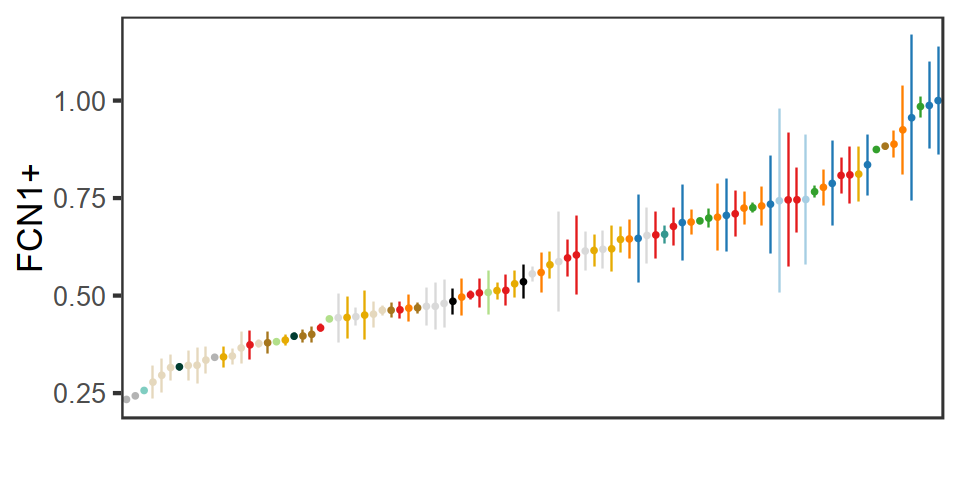

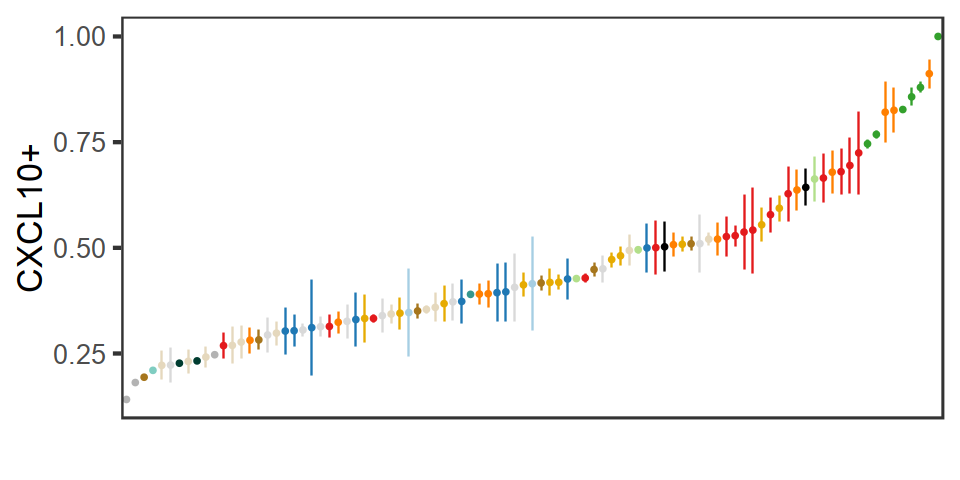

In [383]:
library(tidyr)

cluster0_score <- as.matrix(exprs_norm[which(rownames(exprs_norm) %in% cluster0_gene),])
cluster0_score <- colSums2(cluster0_score) 
cluster7_score <- as.matrix(exprs_norm[which(rownames(exprs_norm) %in% cluster7_gene),])
cluster7_score <- colSums2(cluster7_score) 
meta_all$cluster0_score <- cluster0_score
meta_all$cluster7_score <- cluster7_score

meta_sample <- meta_all[, c("disease_new", "sample", "cluster0_score")] # dataset_new_name
tmp1 <- meta_sample %>% 
  group_by(sample) %>% 
  summarise(ci = list(mean_cl_normal(cluster0_score) %>% 
                        rename(mean=y, lwr=ymin, upr=ymax))
           ) %>% unnest
tmp1 <- na.omit(tmp1)
colnames(tmp1)[2:4] <- c("cluster0_score", "cluster0_lwr", "cluster0_upr")



meta_sample <- meta_all[, c("disease_new", "sample", "cluster7_score")] # dataset_new_name
tmp2 <- meta_sample %>% 
  group_by(sample) %>% 
  summarise(ci = list(mean_cl_normal(cluster7_score) %>% 
                        rename(mean=y, lwr=ymin, upr=ymax))
           ) %>% unnest
tmp2 <- na.omit(tmp2)
colnames(tmp2)[2:4] <- c("cluster7_score", "cluster7_lwr", "cluster7_upr")



meta_sample <- meta_sample[!duplicated(meta_sample$sample),]
meta_sample <- meta_sample[which(meta_sample$sample %in% tmp1$sample),]
meta_sample <- meta_sample[ order(match(meta_sample$sample, tmp1$sample)), ]
all(meta_sample$sample == tmp1$sample)
tmp1$disease_new <- meta_sample$disease_new
meta_sample_mean <- cbind(tmp1, tmp2)
meta_sample_mean <- meta_sample_mean[, -6]
meta_sample_mean[1:4,]

options(repr.plot.height = 4, repr.plot.width = 8)
ggplot(
      data = meta_sample_mean[-which(meta_sample_mean$sample %in% rm_sample),],
      aes(x= reorder(sample,cluster7_score), y = cluster7_score/max(cluster7_score), colour = disease_new)) + 
      geom_pointrange(aes(ymin=cluster7_lwr/max(cluster7_score), ymax=cluster7_upr/max(cluster7_score)), fatten = 0.7, lwd= 0.5) +
      scale_color_manual(values = meta_colors$disease, name = "") +
      labs(x="", 
           y="FCN1+"
          )+
      theme_bw(base_size = 20)+
      theme(
        axis.text.x = element_blank(),
        axis.ticks.x = element_blank(),
        panel.grid = element_blank(),
        plot.title = element_text(color="black", size=20),
        legend.position = "none"
      ) 
ggsave(file = paste("new_gene_score_2", ".pdf", sep = ""), width = 8, height = 4, dpi = 300)

ggplot(
      data =  meta_sample_mean[-which(meta_sample_mean$sample %in% rm_sample),],
      aes(x= reorder(sample,cluster0_score), y = cluster0_score/max(cluster0_score), colour = disease_new)) + 
      geom_pointrange(aes(ymin=cluster0_lwr/max(cluster0_score), ymax=cluster0_upr/max(cluster0_score)), fatten = 0.7, lwd= 0.5) +
      scale_color_manual(values = meta_colors$disease, name = "") +
      labs(x="", 
           y="CXCL10+"
           )+
      theme_bw(base_size = 20)+
      theme(
        axis.text.x = element_blank(),
        axis.ticks.x = element_blank(),
        panel.grid = element_blank(),
        plot.title = element_text(color="black", size=20),
        legend.position = "none"
      ) 
ggsave(file = paste("new_gene_score_3", ".pdf", sep = ""), width = 8, height = 4, dpi = 300)

Warning message:
“`cols` is now required.
Please use `cols = c(ci)`”Warning message:
“`cols` is now required.
Please use `cols = c(ci)`”

[1] TRUE

sample,cluster0_score,cluster0_lwr,cluster0_upr,disease,cluster7_score,cluster7_lwr,cluster7_upr
200-0108,16.334494,15.718151,16.95084,SLE kidney,25.57272,-117.735308,168.88074
200-0109,7.818719,3.216925,12.42051,SLE kidney,23.42758,3.160649,43.69450
200-0124,17.529870,13.923347,21.13639,SLE kidney,32.03423,11.554334,52.51414
200-0341,21.622342,-93.303617,136.54830,SLE kidney,25.01899,7.694129,42.34384


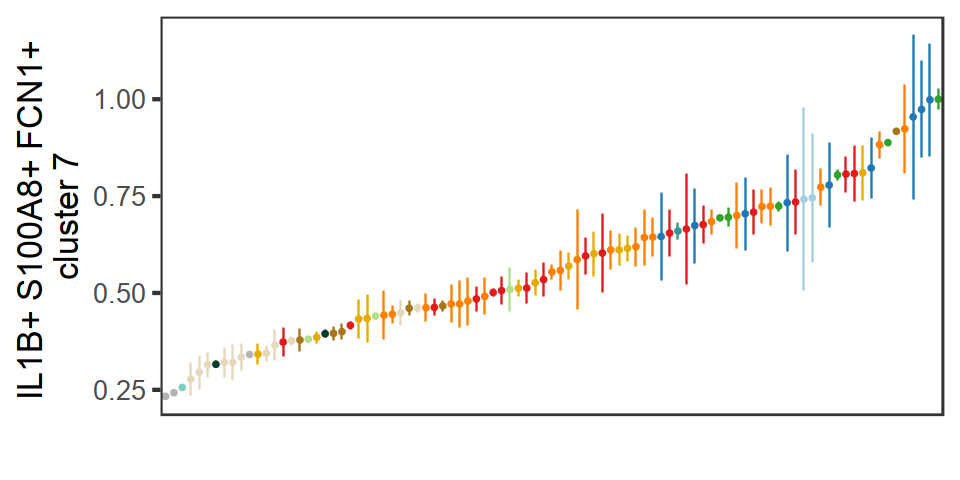

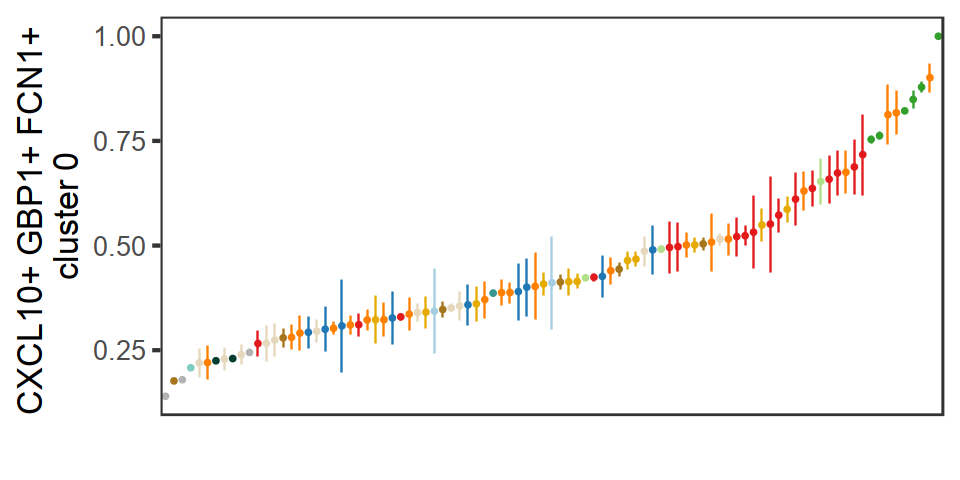

In [63]:
cluster0_score <- as.matrix(exprs_norm[which(rownames(exprs_norm) %in% cluster0_gene),])
cluster0_score <- colSums2(cluster0_score) 
cluster7_score <- as.matrix(exprs_norm[which(rownames(exprs_norm) %in% cluster7_gene),])
cluster7_score <- colSums2(cluster7_score) 
meta_all$cluster0_score <- cluster0_score
meta_all$cluster7_score <- cluster7_score

meta_sample <- meta_all[, c("disease", "sample", "cluster0_score")] # dataset_new_name
tmp1 <- meta_sample %>% 
  group_by(sample) %>% 
  summarise(ci = list(mean_cl_normal(cluster0_score) %>% 
                        rename(mean=y, lwr=ymin, upr=ymax))
           ) %>% unnest
tmp1 <- na.omit(tmp1)
colnames(tmp1)[2:4] <- c("cluster0_score", "cluster0_lwr", "cluster0_upr")



meta_sample <- meta_all[, c("disease", "sample", "cluster7_score")] # dataset_new_name
tmp2 <- meta_sample %>% 
  group_by(sample) %>% 
  summarise(ci = list(mean_cl_normal(cluster7_score) %>% 
                        rename(mean=y, lwr=ymin, upr=ymax))
           ) %>% unnest
tmp2 <- na.omit(tmp2)
colnames(tmp2)[2:4] <- c("cluster7_score", "cluster7_lwr", "cluster7_upr")



meta_sample <- meta_sample[!duplicated(meta_sample$sample),]
meta_sample <- meta_sample[which(meta_sample$sample %in% tmp1$sample),]
meta_sample <- meta_sample[ order(match(meta_sample$sample, tmp1$sample)), ]
all(meta_sample$sample == tmp1$sample)
tmp1$disease <- meta_sample$disease
meta_sample_mean <- cbind(tmp1, tmp2)
meta_sample_mean <- meta_sample_mean[, -6]
meta_sample_mean[1:4,]


meta_sample_mean[which(meta_sample_mean$sample %in% c('C100', 'C51', 'C52')),]$disease <- "Healthy BALF"
meta_sample_mean$disease[which(meta_sample_mean$disease == "healthy")] <- "Healthy kidney"
meta_sample_mean$disease[which(meta_sample_mean$disease == "healthy (IBD)")] <- "Healthy colon"
meta_sample_mean$disease[which(meta_sample_mean$disease == "Hypersensitivity pneumonitis")] <- "Hypersensitivity pneumonitis lung"
meta_sample_mean$disease[which(meta_sample_mean$disease == "Systemic sclerosis")] <- "Systemic sclerosis lung"
meta_sample_mean$disease[which(meta_sample_mean$disease == "mild")] <- "Mild COVID-19"
meta_sample_mean$disease[which(meta_sample_mean$disease == "severe")] <- "Severe COVID-19"
meta_sample_mean$disease[which(meta_sample_mean$disease == "Polymyositis")] <- "Polymyositis lung"
meta_sample_mean$disease[which(meta_sample_mean$disease == "RA")] <- "RA synovium"
meta_sample_mean$disease[which(meta_sample_mean$disease == "OA")] <- "OA synovium"
meta_sample_mean$disease[which(meta_sample_mean$disease == "SLE")] <- "SLE kidney"
meta_sample_mean$disease[which(meta_sample_mean$disease == "Non-inflamed IBD")] <- "Non-inflamed UC"
meta_sample_mean$disease[which(meta_sample_mean$disease == "Inflamed IBD")] <- "Inflamed UC"
meta_sample_mean$disease[which(meta_sample_mean$disease == "OA synovium")] <- "RA synovium"

options(repr.plot.height = 4, repr.plot.width = 8)
ggplot(
      data = meta_sample_mean[-which(meta_sample_mean$sample %in% rm_sample),],
      aes(x= reorder(sample,cluster7_score), y = cluster7_score/max(cluster7_score), colour = disease)) + 
      geom_pointrange(aes(ymin=cluster7_lwr/max(cluster7_score), ymax=cluster7_upr/max(cluster7_score)), fatten = 0.7, lwd= 0.5) +
      scale_color_manual(values = meta_colors$disease, name = "") +
      labs(x="", 
           y="IL1B+ S100A8+ FCN1+ \ncluster 7"
          )+
      theme_bw(base_size = 20)+
      theme(
        axis.text.x = element_blank(),
        axis.ticks.x = element_blank(),
        panel.grid = element_blank(),
        plot.title = element_text(color="black", size=20),
        legend.position = "none"
      ) 
ggsave(file = paste("gene_score_2", ".pdf", sep = ""), width = 8, height = 4, dpi = 300)

ggplot(
      data = meta_sample_mean[-which(meta_sample_mean$sample %in% rm_sample),],
      aes(x= reorder(sample,cluster0_score), y = cluster0_score/max(cluster0_score), colour = disease)) + 
      geom_pointrange(aes(ymin=cluster0_lwr/max(cluster0_score), ymax=cluster0_upr/max(cluster0_score)), fatten = 0.7, lwd= 0.5) +
      scale_color_manual(values = meta_colors$disease, name = "") +
      labs(x="", 
           y="CXCL10+ GBP1+ FCN1+ \ncluster 0"
           )+
      theme_bw(base_size = 20)+
      theme(
        axis.text.x = element_blank(),
        axis.ticks.x = element_blank(),
        panel.grid = element_blank(),
        plot.title = element_text(color="black", size=20),
        legend.position = "none"
      ) 
ggsave(file = paste("gene_score_3", ".pdf", sep = ""), width = 8, height = 4, dpi = 300)

In [376]:
table(meta_sample_mean$disease_new)


      Healthy BALF      Mild COVID-19    Severe COVID-19  Polymyositis lung 
                 3                  3                  6                  1 
           SS lung            HP lung      Healthy colon    Non-inflamed UC 
                 2                  1                 12                 12 
       Inflamed UC Non-inflamed Crohn     Inflamed Crohn                 OA 
                 6                 11                 11                  2 
                RA     Healthy kidney                SLE 
                15                  7                 15 

[1] TRUE

sample,cluster0_score,cluster7_score,disease_new
200-0061,0.4809317,0.3665769,SLE
200-0108,0.3185396,0.5205812,SLE
200-0109,0.1825904,0.5017202,SLE
200-0115,0.4430091,0.5139191,SLE


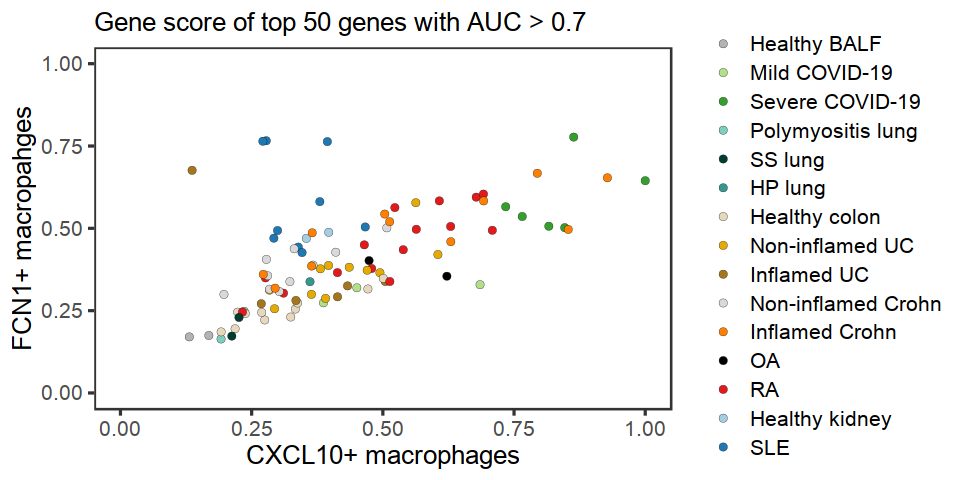

In [382]:
cluster0_score <- as.matrix(exprs_norm[which(rownames(exprs_norm) %in% cluster0_gene),])
cluster0_score <- colSums2(cluster0_score) 

cluster7_score <- as.matrix(exprs_norm[which(rownames(exprs_norm) %in% cluster7_gene),])
cluster7_score <- colSums2(cluster7_score) 

meta_all$cluster0_score <- cluster0_score
meta_all$cluster7_score <- cluster7_score
meta_sample <- meta_all[, c("disease_new", "sample", "cluster0_score", "cluster7_score")] # dataset_new_name

meta_sample_mean <- meta_sample %>%
                    group_by(sample) %>%
                    summarise_at(vars(-disease_new), funs(median(., na.rm=TRUE)))

meta_sample <- meta_sample[!duplicated(meta_sample$sample),]
meta_sample <- meta_sample[ order(match(meta_sample$sample, meta_sample_mean$sample)), ]
all(meta_sample$sample == meta_sample_mean$sample)
meta_sample_mean$disease_new <- meta_sample$disease_new


meta_sample_mean$cluster0_score <- meta_sample_mean$cluster0_score / max(meta_sample_mean$cluster0_score)
meta_sample_mean$cluster7_score <- meta_sample_mean$cluster7_score / max(meta_sample_mean$cluster7_score)
# meta_sample_mean$disease[which(meta_sample_mean$disease == "OA synovium")] <- "RA synovium"
meta_sample_mean[1:4,]


options(repr.plot.height = 4, repr.plot.width = 8)
ggplot(
      data = meta_sample_mean[-which(meta_sample_mean$sample %in% rm_sample),],
      aes(x = cluster0_score, y = cluster7_score, fill = disease_new)) + 
      geom_point(size = 2, stroke = 0.1, shape = 21) + 
      scale_fill_manual(values = meta_colors$disease, name = "") +
      labs(x="CXCL10+ macrophages", 
           y="FCN1+ macropahges", 
           title = "Gene score of top 50 genes with AUC > 0.7")+
      scale_x_continuous(limits = c(0, 1)) +
      scale_y_continuous(limits = c(0, 1)) +
      theme_bw(base_size = 15)+
      theme(
#         axis.text.x = element_blank(),
#         axis.ticks = element_blank(),
        panel.grid = element_blank(),
        plot.title = element_text(color="black", size=15)
#         legend.position = "none"
      ) 
ggsave(file = paste("new_gene_score_1", ".pdf", sep = ""), width = 8, height = 4, dpi = 300)

sample,cluster0_score,cluster0_lwr,cluster0_upr,disease_new,cluster7_score,cluster7_lwr,cluster7_upr
200-0108,16.33449,15.718151,16.95084,SLE,25.57272,-117.735308,168.88074
200-0109,13.10306,-1.894577,28.10070,SLE,28.13282,9.205522,47.06011
200-0124,17.52987,13.923347,21.13639,SLE,32.03423,11.554334,52.51414
200-0341,21.62234,-93.303617,136.54830,SLE,25.01899,7.694129,42.34384


disease_new,cluster0_score,cluster0_lwr,cluster0_upr,cluster7_score,cluster7_lwr,cluster7_upr
Healthy BALF,9.12276,9.027198,9.218322,8.852014,8.781077,8.922950
Mild COVID-19,24.92946,24.538170,25.320747,16.037713,15.830285,16.245141
Severe COVID-19,42.36843,41.739701,42.997162,27.167889,26.653274,27.682503
Polymyositis lung,10.57325,10.402366,10.744129,9.353874,9.138804,9.568944


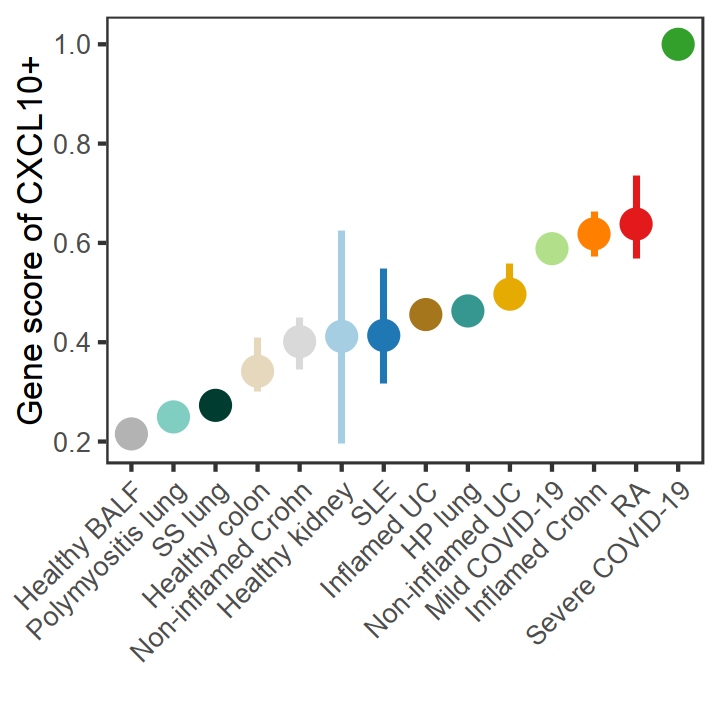

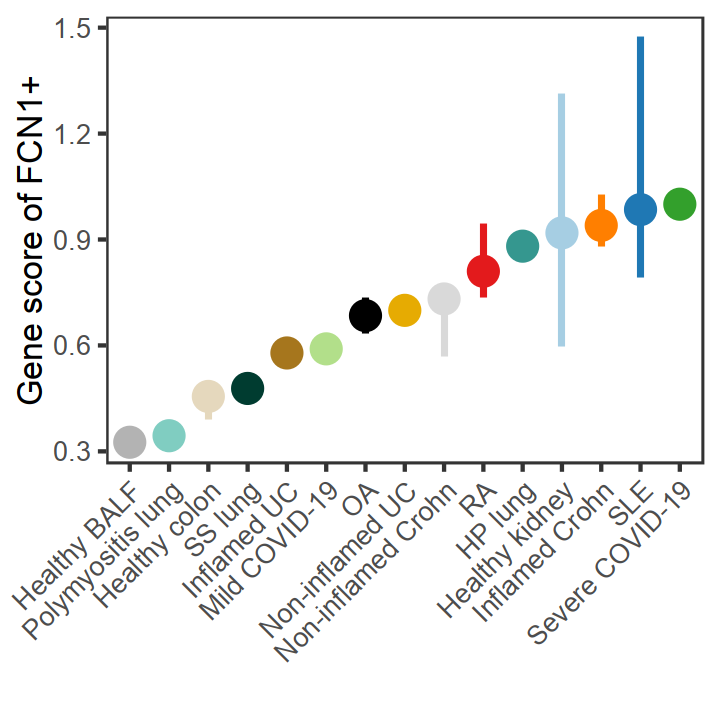

In [394]:
## Centroid for each disease group
meta_sample_mean[1:4,]

meta_dis_mean <- meta_sample_mean %>%
                 group_by(disease_new) %>%
                 summarise_at(vars(-sample), funs(median(., na.rm=TRUE)))
meta_dis_mean[1:4,]

options(repr.plot.height = 6, repr.plot.width = 6)
ggplot(
      data = meta_dis_mean[-which(meta_dis_mean$disease_new == "OA"),],
      aes(x= reorder(disease_new, cluster0_score), y = cluster0_score/max(cluster0_score), colour = disease_new)) + 
      geom_pointrange(aes(ymin=cluster0_lwr/max(cluster0_score), ymax=cluster0_upr/max(cluster0_score)), fatten = 5, lwd= 1.5) +
      scale_color_manual(values = meta_colors$disease, name = "") +
      labs(x="", 
           y="Gene score of CXCL10+"
           )+
      theme_bw(base_size = 20)+
      theme(
        axis.text.x = element_text(angle = 45, hjust = 1),
#         axis.ticks.x = element_blank(),
        panel.grid = element_blank(),
        plot.title = element_text(color="black", size=20),
        legend.position = "none"
      ) 
ggsave(file = paste("new_centroid_disease_tissue_cluster1", ".pdf", sep = ""), width = 6, height = 6, dpi = 300)


ggplot(
      data = meta_dis_mean,
      aes(x= reorder(disease_new, cluster7_score), y = cluster7_score/max(cluster7_score), colour = disease_new)) + 
      geom_pointrange(aes(ymin=cluster7_lwr/max(cluster7_score), ymax=cluster7_upr/max(cluster7_score)), fatten = 5, lwd= 1.5) +
      scale_color_manual(values = meta_colors$disease, name = "") +
      labs(x="", 
           y="Gene score of FCN1+"
           )+
      theme_bw(base_size = 20)+
      theme(
        axis.text.x = element_text(angle = 45, hjust = 1),
#         axis.ticks.x = element_blank(),
        panel.grid = element_blank(),
        plot.title = element_text(color="black", size=20),
        legend.position = "none"
      ) 
ggsave(file = paste("new_centroid_disease_tissue_cluster2", ".pdf", sep = ""), width = 6, height = 6, dpi = 300)

sample,cluster0_score,cluster0_lwr,cluster0_upr,disease,cluster7_score,cluster7_lwr,cluster7_upr
200-0108,16.334494,15.718151,16.95084,SLE kidney,25.57272,-117.735308,168.88074
200-0109,7.818719,3.216925,12.42051,SLE kidney,23.42758,3.160649,43.69450
200-0124,17.529870,13.923347,21.13639,SLE kidney,32.03423,11.554334,52.51414
200-0341,21.622342,-93.303617,136.54830,SLE kidney,25.01899,7.694129,42.34384


disease,cluster0_score,cluster0_lwr,cluster0_upr,cluster7_score,cluster7_lwr,cluster7_upr
Crohn,19.697316,17.354937,22.63372,21.845558,20.01520,24.874127
Healthy BALF,9.120079,9.024648,9.21551,8.850385,8.77951,8.921259
Healthy colon,14.469845,12.759726,17.37568,12.378546,10.60772,13.431068
Healthy kidney,17.448524,8.332986,26.48852,24.961601,16.20337,35.679072


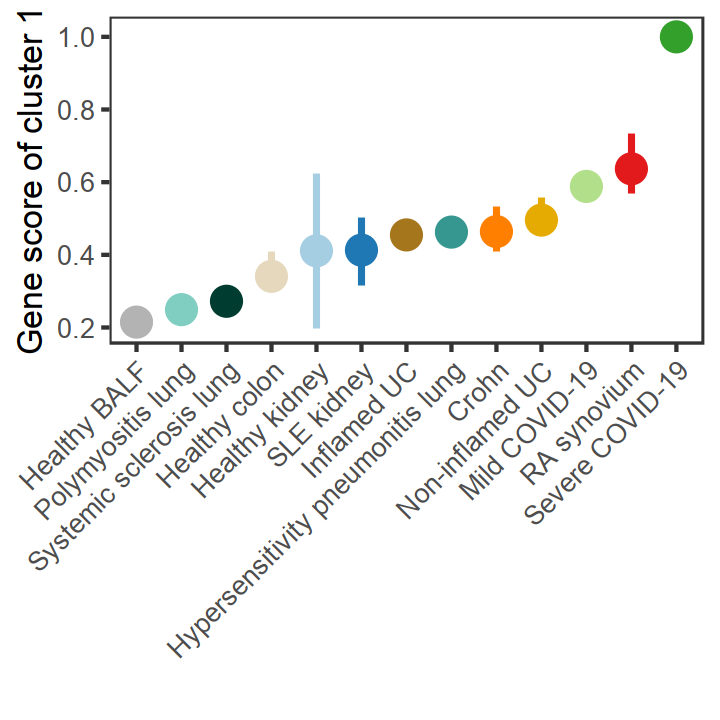

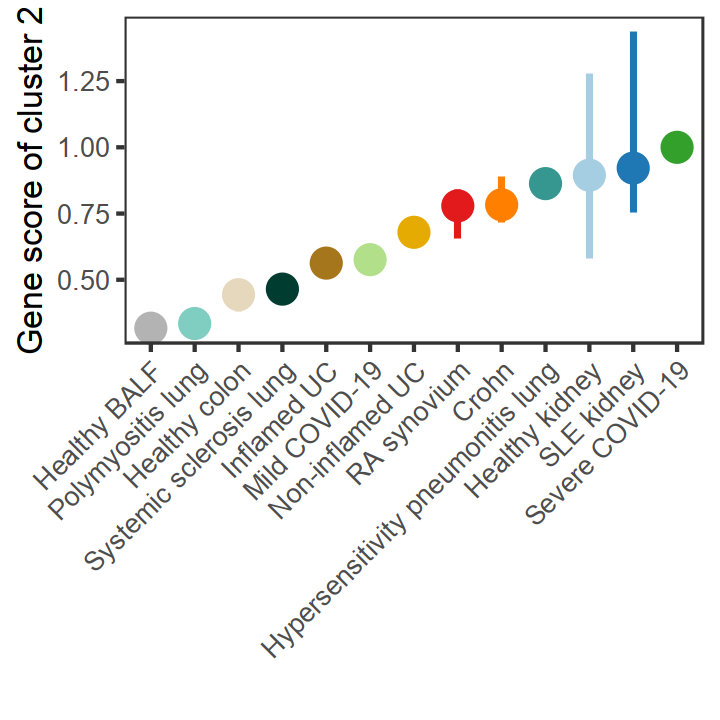

In [74]:
## Centroid for each disease group
meta_sample_mean[1:4,]

meta_dis_mean <- meta_sample_mean %>%
                 group_by(disease) %>%
                 summarise_at(vars(-sample), funs(median(., na.rm=TRUE)))
meta_dis_mean[1:4,]

options(repr.plot.height = 6, repr.plot.width = 6)
ggplot(
      data = meta_dis_mean,
      aes(x= reorder(disease, cluster0_score), y = cluster0_score/max(cluster0_score), colour = disease)) + 
      geom_pointrange(aes(ymin=cluster0_lwr/max(cluster0_score), ymax=cluster0_upr/max(cluster0_score)), fatten = 5, lwd= 1.5) +
      scale_color_manual(values = meta_colors$disease, name = "") +
      labs(x="", 
           y="Gene score of cluster 1"
           )+
      theme_bw(base_size = 20)+
      theme(
        axis.text.x = element_text(angle = 45, hjust = 1),
#         axis.ticks.x = element_blank(),
        panel.grid = element_blank(),
        plot.title = element_text(color="black", size=20),
        legend.position = "none"
      ) 
ggsave(file = paste("centroid_disease_tissue_cluster1", ".pdf", sep = ""), width = 6, height = 6, dpi = 300)


ggplot(
      data = meta_dis_mean,
      aes(x= reorder(disease, cluster7_score), y = cluster7_score/max(cluster7_score), colour = disease)) + 
      geom_pointrange(aes(ymin=cluster7_lwr/max(cluster7_score), ymax=cluster7_upr/max(cluster7_score)), fatten = 5, lwd= 1.5) +
      scale_color_manual(values = meta_colors$disease, name = "") +
      labs(x="", 
           y="Gene score of cluster 2"
           )+
      theme_bw(base_size = 20)+
      theme(
        axis.text.x = element_text(angle = 45, hjust = 1),
#         axis.ticks.x = element_blank(),
        panel.grid = element_blank(),
        plot.title = element_text(color="black", size=20),
        legend.position = "none"
      ) 
ggsave(file = paste("centroid_disease_tissue_cluster2", ".pdf", sep = ""), width = 6, height = 6, dpi = 300)